# DataCo Global - uma empresa global do ramo de supply chain

A Empresa **DataCo Global** é uma companhia de escala global que atua no setor de supply chain envolvendo diversos produtos desde eletrônicos, brinquedos, acessórios esportivos, acessórios para acampamento e até livros.  
  
Aqui será realizada uma análise detalhada das suas vendas e lucros diante de diversos aspectos como **categorias**, **departamentos** e **localização de clientes**, avaliando também problemas logísticos como **atrasos em entregas** e problemas com **operações fraudulentas**.
  
Venha descobrir insights valiosos sobre a empresa, incluindo como andam as suas vendas, os seus lucros e suas operações de logística!

<a id="import_bibliotecas"></a>
<h1 style="color: green;">1. Importando as bibliotecas e o dataset</h1>

In [1]:
# Importando a biblioteca para manipulação de bases de dados
import pandas as pd
import locale

#Importando a biblioteca para manipulação algébrica
import numpy as np

# Bibliotecas para a EDA
import missingno
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns

# Estatística
from scipy.stats import skew

# importando as funções Stratified K-Fold e train_test_split
from  sklearn.model_selection import train_test_split, StratifiedKFold

# Importando os modelos
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

# importando as funções para calcular a precisão, revocação, precision_recall_auc, roc_auc, medida F1 e acurácia
from sklearn.metrics import precision_score, recall_score, precision_recall_curve, auc, roc_auc_score, f1_score, accuracy_score

# Encoder para tratamento de variáveis categóricas
from category_encoders import CatBoostEncoder

# Pipelines
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline

# Importando biblioteca para tunagem de hiperparâmetros
import optuna as opt

# Setando diretório de trabalho
import os
os.chdir(r"C:\Users\edd-j\Downloads\Conteudos\Portfolio\Fraudes\Fraude_Supply_Chain")

# Configurar para não exibir warnings
from warnings import filterwarnings
filterwarnings('ignore')

# Exibindo todas as colunas das bases de dados
pd.set_option('display.max_columns', None)

# Ajustando a configuração de exibição do Pandas para mostrar todo o conteúdo das colunas
pd.set_option('display.max_colwidth', None)

In [2]:
# Importando bases de dados

df = pd.read_csv('DataCoSupplyChainDataset.csv', encoding='ISO-8859-1')
df_descricao = pd.read_csv('DescriptionDataCoSupplyChain.csv')

<a id="dicionario"></a>
<h1 style="color: green;">2. Dicionário dos dados</h1>

In [3]:
# Limpeza dos dados para remover caracteres extras como ':'
df_descricao['FIELDS'] = df_descricao['FIELDS'].str.strip()
df_descricao['DESCRIPTION'] = df_descricao['DESCRIPTION'].str.strip().str.lstrip(':').str.strip()

# Apresentando a descrição das colunas da base de dados
df_descricao

,FIELDS,DESCRIPTION
0,Type,Type of transaction made
1,Days for shipping (real),Actual shipping days of the purchased product
2,Days for shipment (scheduled),Days of scheduled delivery of the purchased product
3,Benefit per order,Earnings per order placed
4,Sales per customer,Total sales per customer made per customer
5,Delivery Status,"Delivery status of orders: Advance shipping , Late delivery , Shipping canceled , Shipping on time"
6,Late_delivery_risk,"Categorical variable that indicates if sending is late (1), it is not late (0)."
7,Category Id,Product category code
8,Category Name,Description of the product category
9,Customer City,City where the customer made the purchase


<a id="visao_geral"></a>
<h1 style="color: green;">3. Visão Geral do Dataset</h1>

In [4]:
# Primeiras linhas do dataset
df.head()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Email,Customer Fname,Customer Id,Customer Lname,Customer Password,Customer Segment,Customer State,Customer Street,Customer Zipcode,Department Id,Department Name,Latitude,Longitude,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,XXXXXXXXX,Cally,20755,Holloway,XXXXXXXXX,Consumer,PR,5365 Noble Nectar Island,725.0,2,Fitness,18.251453,-66.037056,Pacific Asia,Bekasi,Indonesia,20755,1/31/2018 22:56,77202,1360,13.110000,0.04,180517,327.75,0.29,1,327.75,314.640015,91.250000,Southeast Asia,Java Occidental,COMPLETE,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,2/3/2018 22:56,Standard Class
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,Puerto Rico,XXXXXXXXX,Irene,19492,Luna,XXXXXXXXX,Consumer,PR,2679 Rustic Loop,725.0,2,Fitness,18.279451,-66.037064,Pacific Asia,Bikaner,India,19492,1/13/2018 12:27,75939,1360,16.389999,0.05,179254,327.75,-0.80,1,327.75,311.359985,-249.089996,South Asia,Rajastán,PENDING,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/18/2018 12:27,Standard Class
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,EE. UU.,XXXXXXXXX,Gillian,19491,Maldonado,XXXXXXXXX,Consumer,CA,8510 Round Bear Gate,95125.0,2,Fitness,37.292233,-121.881279,Pacific Asia,Bikaner,India,19491,1/13/2018 12:06,75938,1360,18.030001,0.06,179253,327.75,-0.80,1,327.75,309.720001,-247.779999,South Asia,Rajastán,CLOSED,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/17/2018 12:06,Standard Class
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,EE. UU.,XXXXXXXXX,Tana,19490,Tate,XXXXXXXXX,Home Office,CA,3200 Amber Bend,90027.0,2,Fitness,34.125946,-118.291016,Pacific Asia,Townsville,Australia,19490,1/13/2018 11:45,75937,1360,22.940001,0.07,179252,327.75,0.08,1,327.75,304.809998,22.860001,Oceania,Queensland,COMPLETE,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/16/2018 11:45,Standard Class
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,XXXXXXXXX,Orli,19489,Hendricks,XXXXXXXXX,Corporate,PR,8671 Iron Anchor Corners,725.0,2,Fitness,18.253769,-66.037048,Pacific Asia,Townsville,Australia,19489,1/13/2018 11:24,75936,1360,29.500000,0.09,179251,327.75,0.45,1,327.75,298.250000,134.210007,Oceania,Queensland,PENDING_PAYMENT,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/15/2018 11:24,Standard Class


In [5]:
print(f"O dataframe possui {df.shape[0]} linhas e {df.shape[1]} colunas.")

O dataframe possui 180519 linhas e 53 colunas.


In [6]:
# Informações sobre todas as colunas do dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180519 entries, 0 to 180518
Data columns (total 53 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Type                           180519 non-null  object 
 1   Days for shipping (real)       180519 non-null  int64  
 2   Days for shipment (scheduled)  180519 non-null  int64  
 3   Benefit per order              180519 non-null  float64
 4   Sales per customer             180519 non-null  float64
 5   Delivery Status                180519 non-null  object 
 6   Late_delivery_risk             180519 non-null  int64  
 7   Category Id                    180519 non-null  int64  
 8   Category Name                  180519 non-null  object 
 9   Customer City                  180519 non-null  object 
 10  Customer Country               180519 non-null  object 
 11  Customer Email                 180519 non-null  object 
 12  Customer Fname                

In [7]:
numerics = ["int16", "int32", "int64", "float16", "float32", "float64"]

numericas = df.select_dtypes(include=numerics)

nao_numericas = df.select_dtypes(exclude=numerics)

print(f"Temos {numericas.shape[1]} colunas numéricas e {nao_numericas.shape[1]} colunas não-numéricas.")

Temos 29 colunas numéricas e 24 colunas não-numéricas.


In [8]:
# Estátísticas descritivas do dataset
df.describe()

,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Late_delivery_risk,Category Id,Customer Id,Customer Zipcode,Department Id,Latitude,Longitude,Order Customer Id,Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Price,Product Status
count,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180516.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,24840.000000,180519.000000,180519.000000,0.0,180519.000000,180519.0
mean,3.497654,2.931847,21.974989,183.107609,0.548291,31.851451,6691.379495,35921.126914,5.443460,29.719955,-84.915675,6691.379495,36221.894903,692.509764,20.664741,0.101668,90260.000000,141.232550,0.120647,2.127638,203.772096,183.107609,21.974989,55426.132327,692.509764,31.851451,NaN,141.232550,0.0
std,1.623722,1.374449,104.433526,120.043670,0.497664,15.640064,4162.918106,37542.461122,1.629246,9.813646,21.433241,4162.918106,21045.379569,336.446807,21.800901,0.070415,52111.490959,139.732492,0.466796,1.453451,132.273077,120.043670,104.433526,31919.279101,336.446807,15.640064,NaN,139.732492,0.0
min,0.000000,0.000000,-4274.979980,7.490000,0.000000,2.000000,1.000000,603.000000,2.000000,-33.937553,-158.025986,1.000000,1.000000,19.000000,0.000000,0.000000,1.000000,9.990000,-2.750000,1.000000,9.990000,7.490000,-4274.979980,1040.000000,19.000000,2.000000,NaN,9.990000,0.0
25%,2.000000,2.000000,7.000000,104.379997,0.000000,18.000000,3258.500000,725.000000,4.000000,18.265432,-98.446312,3258.500000,18057.000000,403.000000,5.400000,0.040000,45130.500000,50.000000,0.080000,1.000000,119.980003,104.379997,7.000000,23464.000000,403.000000,18.000000,NaN,50.000000,0.0
50%,3.000000,4.000000,31.520000,163.990005,1.000000,29.000000,6457.000000,19380.000000,5.000000,33.144863,-76.847908,6457.000000,36140.000000,627.000000,14.000000,0.100000,90260.000000,59.990002,0.270000,1.000000,199.919998,163.990005,31.520000,59405.000000,627.000000,29.000000,NaN,59.990002,0.0
75%,5.000000,4.000000,64.800003,247.399994,1.000000,45.000000,9779.000000,78207.000000,7.000000,39.279617,-66.370583,9779.000000,54144.000000,1004.000000,29.990000,0.160000,135389.500000,199.990005,0.360000,3.000000,299.950012,247.399994,64.800003,90008.000000,1004.000000,45.000000,NaN,199.990005,0.0
max,6.000000,4.000000,911.799988,1939.989990,1.000000,76.000000,20757.000000,99205.000000,12.000000,48.781933,115.263077,20757.000000,77204.000000,1363.000000,500.000000,0.250000,180519.000000,1999.989990,0.500000,5.000000,1999.989990,1939.989990,911.799988,99301.000000,1363.000000,76.000000,NaN,1999.989990,0.0


<a id="detecção_outliers"></a>
#### <b>3.1 Detecção de Outliers</b>

Esta etapa consiste em detectar a quantidade de outliers presente em cada uma das variáveis da base de dados. São calculados utilizando Q1 (primeiro quartil), Q3 (terceiro quartil) e IQR (Distância Interquartil):

Q1: Este é o valor que separa os 25% menores valores da coluna. Também é conhecido como primeiro quartil.

Q3: Este é o valor que separa os 25% maiores valores da coluna. Também é conhecido como terceiro quartil.

$$IQR = Q3 - Q1$$
<br>
Será considerado Outlier quando o valor da variável (VAR):

$$VAR > Q3 + 1.5IQR$$
$$VAR < Q1 - 1.5IQR$$

In [9]:
# Função para identificar outliers em uma variável
def detect_outliers(column):
    Q1 = column.quantile(0.25)
    Q3 = column.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = column[(column < lower_bound) | (column > upper_bound)]
    return outliers

# Dicionário para armazenar os outliers de cada variável
outliers_dict = {}

# Loop através das variáveis numéricas
for col in df.select_dtypes(include=['float64', 'int64']):
    outliers = detect_outliers(df[col])
    outliers_dict[col] = outliers

# Crie um DataFrame com os outliers
outliers_df = pd.DataFrame(outliers_dict)

# Conte quantos outliers cada variável possui
contagem_outliers = outliers_df.count()

# Exiba a contagem de outliers para cada variável
contagem_outliers_df = pd.DataFrame({'Variavel': contagem_outliers.index, 'Quantidade de Outliers': contagem_outliers.values})
contagem_outliers_df

,Variavel,Quantidade de Outliers
0,Days for shipping (real),0
1,Days for shipment (scheduled),0
2,Benefit per order,18942
3,Sales per customer,1943
4,Late_delivery_risk,0
5,Category Id,0
6,Customer Id,1198
7,Customer Zipcode,0
8,Department Id,362
9,Latitude,9


<a id="valores_nulos"></a>
#### <b>3.2 Valores Nulos</b>

In [10]:
# Fazendo a soma de valores nulos por coluna
df.isnull().sum()

Type                                  0
Days for shipping (real)              0
Days for shipment (scheduled)         0
Benefit per order                     0
Sales per customer                    0
Delivery Status                       0
Late_delivery_risk                    0
Category Id                           0
Category Name                         0
Customer City                         0
Customer Country                      0
Customer Email                        0
Customer Fname                        0
Customer Id                           0
Customer Lname                        8
Customer Password                     0
Customer Segment                      0
Customer State                        0
Customer Street                       0
Customer Zipcode                      3
Department Id                         0
Department Name                       0
Latitude                              0
Longitude                             0
Market                                0


<Axes: >

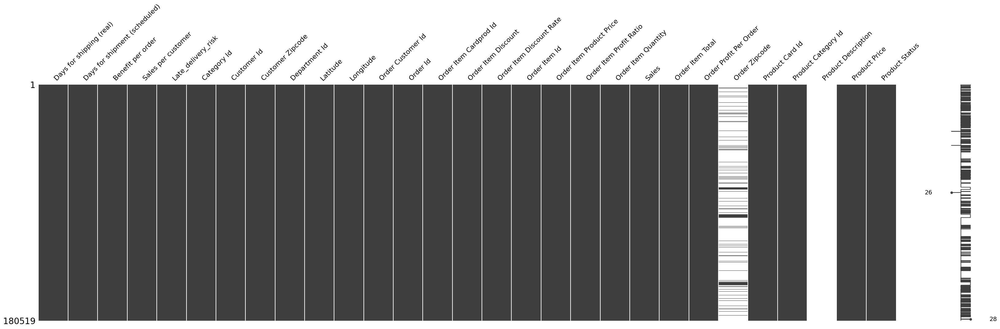

In [11]:
# visualizando as colunas numéricas com dados faltantes
missingno.matrix(numericas,figsize=(40,10))

Pela imagem acima, verifica-se que há duas colunas numéricas com grande quantidade de valores nulos: **Order Zipcode** e **Product Description**. pela contagem anterior, sabe-se que uma terceira coluna **(Customer Zipcode)** possui apenas 3 valores nulos, o que não foi possível verificar visualmente devido à baixa quantidade.

<Axes: >

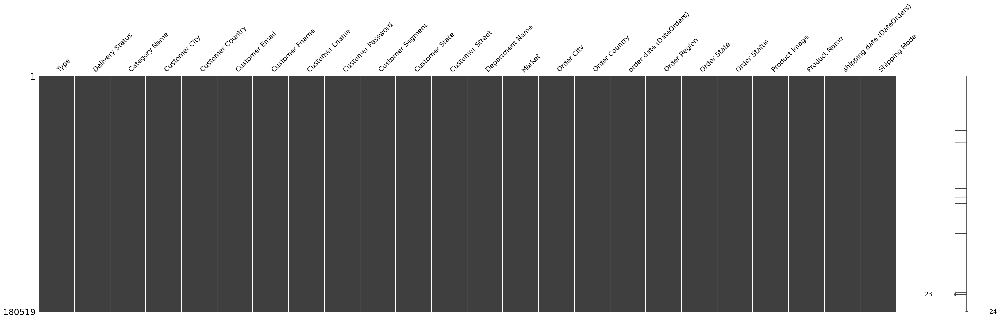

In [12]:
# visualizando as colunas não numéricas com dados faltantes
missingno.matrix(nao_numericas,figsize=(40,10))

Pela imagem acima, não é possível identificar visualmente alguma variável não numérica com valores nulos. Porém, sabe se a variável **Customer Lname** possui 8 valores nulos em sua composição, não sendo possível verificar visualmente por ser uma quantidade pequena perante o número de registros da base.

In [13]:
# fazendo unpack de linhas e colunas
rows, columns = df.shape

# Percentual de dados faltantes por coluna
percentual_nan = ((df.isnull().sum()/rows) * 100).round(2)
percentual_nan

Type                               0.00
Days for shipping (real)           0.00
Days for shipment (scheduled)      0.00
Benefit per order                  0.00
Sales per customer                 0.00
Delivery Status                    0.00
Late_delivery_risk                 0.00
Category Id                        0.00
Category Name                      0.00
Customer City                      0.00
Customer Country                   0.00
Customer Email                     0.00
Customer Fname                     0.00
Customer Id                        0.00
Customer Lname                     0.00
Customer Password                  0.00
Customer Segment                   0.00
Customer State                     0.00
Customer Street                    0.00
Customer Zipcode                   0.00
Department Id                      0.00
Department Name                    0.00
Latitude                           0.00
Longitude                          0.00
Market                             0.00


<a id="linhas_duplicadas"></a>
#### <b>3.3 Linhas Duplicadas</b>

In [14]:
# verificando se há linhas duplicadas
df[df.duplicated()]

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Email,Customer Fname,Customer Id,Customer Lname,Customer Password,Customer Segment,Customer State,Customer Street,Customer Zipcode,Department Id,Department Name,Latitude,Longitude,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode


Nota-se que o dataset contem 180.519 entradas com informações de vendas de produtos da empresa SupplyAll e que todos os registros são únicos. Desta forma, é possível concluir que não existem entradas duplicadas.

<a id="valores_diferentes_por_coluna"></a>
#### <b>3.4 Valores Diferentes por Coluna</b>

In [15]:
# Definindo quantos valores diferentes existem em cada variável

contagem = pd.DataFrame(columns=['Variavel','Contagens_Distintas'])

for coluna in df.columns:
    dados = {'Variavel': coluna, 'Contagens_Distintas': df[coluna].value_counts().shape[0]}
    contagem = contagem.append(dados, ignore_index = True)

contagem

AttributeError: 'DataFrame' object has no attribute 'append'

Com a informação das contagens distintas de cada variável, podemos obter as seguintes informações:  
* Os clientes pagaram os produtos através de 4 meios de pagamentos diferentes  
* Há 9 status diferentes para os pedidos
* Há 4 status diferentes para as entregas dos produtos
* Os produtos são entregues para 5 grandes regiões diferentes do mundo
* Os produtos foram enviados para 164 países diferentes
* Os clientes são de 2 países diferentes
* Há 51 categorias de produtos diferentes
* Há 3 segmentos distintos de clientes
* Há 20.652 clientes no total
* Há 23 micro regiões do mundo onde os produtos são entregues

<a id="correlacoes_entre_variaveis"></a>
#### <b>3.5 Correlações entre variáveis</b>

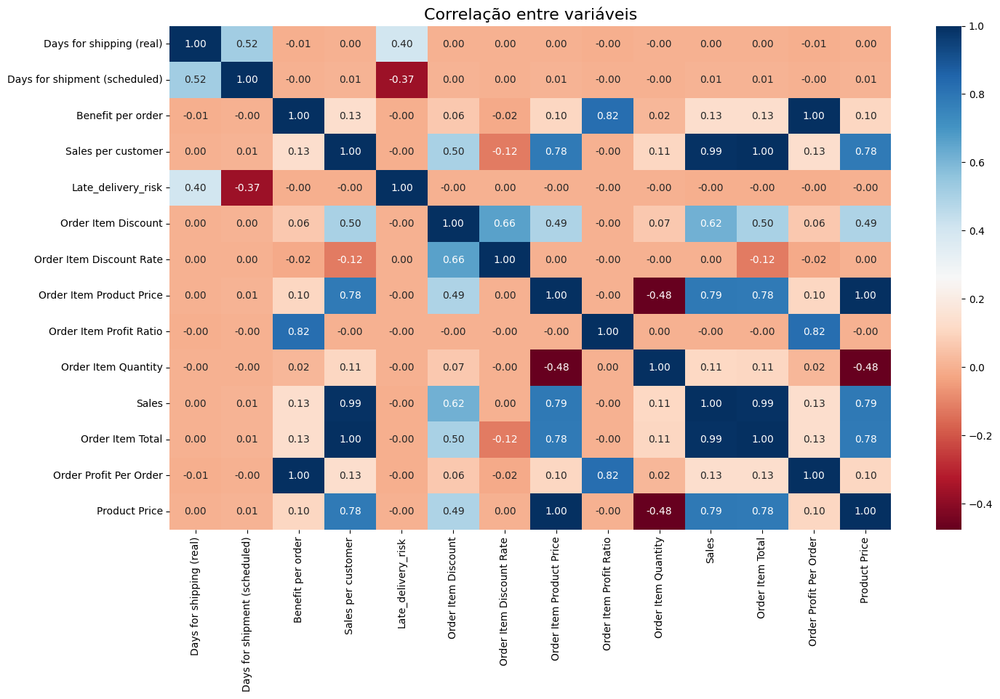

In [16]:
# Remover colunas específicas
numericas_filtradas = numericas.drop(['Category Id', 'Customer Id', 'Customer Zipcode', 'Department Id', 'Latitude',
                            'Longitude', 'Order Customer Id', 'Order Id', 'Order Item Cardprod Id', 'Order Item Id',
                            'Order Zipcode', 'Product Card Id', 'Product Category Id', 'Product Description',
                            'Product Status'], axis=1)

# Calcular a matriz de correlação
corr_matrix = numericas_filtradas.corr()

# Criar o heatmap
plt.figure(figsize=(16, 9))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='RdBu')
plt.title('Correlação entre variáveis', fontsize=16)
plt.show()

### Variáveis altamente correlacionadas

* Benefit per order e Order Profit Per Order **(correlação 1.00)**
* Sales per customer e Sales **(correlação 0.99)**
* Sales per Customer e Order Item Total **(correlação 1.00)**
* Order Item Product Price e Product Price **(correlação 1.00)**

<b>Obs: É importante lembrar que a correlação não implica causalidade. Mesmo quando duas variáveis estão correlacionadas, isso não significa necessariamente que uma causa a outra. Outros fatores ou variáveis não incluídas na análise podem estar contribuindo para a relação observada. Portanto, a interpretação da correlação deve ser feita com cuidado e, quando necessário, devem ser realizadas análises adicionais para entender melhor a relação entre as variáveis.</b>

array([[<Axes: title={'center': 'Days for shipping (real)'}>,
        <Axes: title={'center': 'Days for shipment (scheduled)'}>,
        <Axes: title={'center': 'Benefit per order'}>,
        <Axes: title={'center': 'Sales per customer'}>],
       [<Axes: title={'center': 'Late_delivery_risk'}>,
        <Axes: title={'center': 'Order Item Discount'}>,
        <Axes: title={'center': 'Order Item Discount Rate'}>,
        <Axes: title={'center': 'Order Item Product Price'}>],
       [<Axes: title={'center': 'Order Item Profit Ratio'}>,
        <Axes: title={'center': 'Order Item Quantity'}>,
        <Axes: title={'center': 'Sales'}>,
        <Axes: title={'center': 'Order Item Total'}>],
       [<Axes: title={'center': 'Order Profit Per Order'}>,
        <Axes: title={'center': 'Product Price'}>, <Axes: >, <Axes: >]],
      dtype=object)

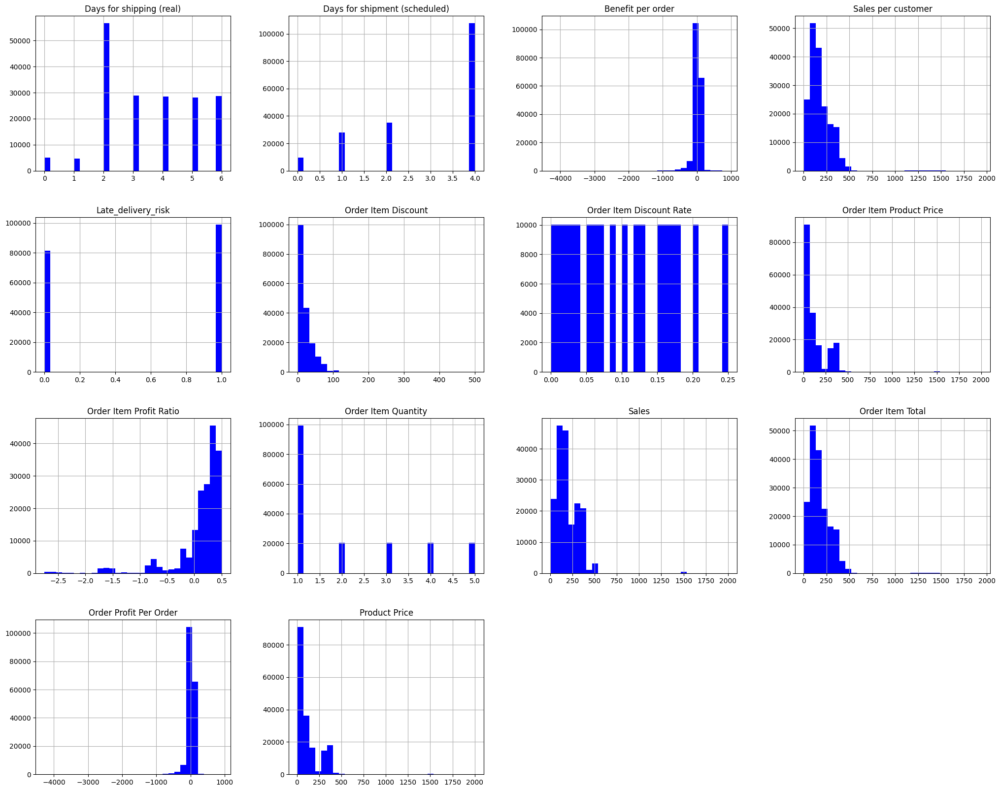

In [17]:
# Cria histogramas para as variáveis selecionadas
numericas_filtradas.hist(bins=30, figsize=(25, 20), color='blue')

In [18]:
# Desconsiderar pedidos que tiveram entrega cancelada. Está sendo levado em consideração que entregas canceladas têm o dinheiro
# da compra enviado de volta ao cliente, não contribuindo para os cofres da companhia
df_filtrado = df[df['Delivery Status']!='Shipping canceled']

<a id="analise_clientes"></a>
<h1 style="color: green;">4. Avaliação dos clientes</h1>

In [19]:

# Transformando a variável 'order date (DateOrders)' em datetime para trabalhar com datas
df['order date (DateOrders)'] = pd.to_datetime(df['order date (DateOrders)'])

# Extraindo o ano
df['Ano'] = df['order date (DateOrders)'].dt.year

# Agrupando por Customer_Id e Year, e contando os Order_Id únicos
compras_por_cliente_ano = df.groupby(['Customer Id', 'Ano'])['Order Id'].nunique().reset_index()

# Renomeando a coluna para refletir a contagem
compras_por_cliente_ano.rename(columns={'Order Id': 'Quantidade de Pedidos'}, inplace=True)

compras_por_cliente_ano_pivot = compras_por_cliente_ano.pivot_table(index="Customer Id",columns="Ano",values="Quantidade de Pedidos",fill_value=0)

compras_por_cliente_ano_pivot

Ano,2015,2016,2017,2018
Customer Id,,,,
1,1.0,0.0,0.0,0.0
2,1.0,1.0,2.0,0.0
3,1.0,1.0,3.0,0.0
4,2.0,1.0,1.0,0.0
5,0.0,3.0,0.0,0.0
...,...,...,...,...
20753,0.0,0.0,0.0,1.0
20754,0.0,0.0,0.0,1.0
20755,0.0,0.0,0.0,1.0


In [20]:
# Filtrando todos os clientes que compraram em 2018
compras_por_cliente_ano_pivot[compras_por_cliente_ano_pivot[2018] > 0].value_counts()

2015  2016  2017  2018
0.0   0.0   0.0   1.0     2123
Name: count, dtype: int64

Chega-se a conclusão que, todos os clientes que compraram em 2018, compraram apenas em 2018!

In [21]:
# Filtrando para trazer somente a informação do ano de 2018
compras_2018 = compras_por_cliente_ano[compras_por_cliente_ano['Ano'] == 2018]

# Verificando se há clientes que compraram mais de uma vez em 2018
clientes_compras_multiplos_2018 = compras_2018[compras_2018['Quantidade de Pedidos'] > 1]
clientes_compras_multiplos_2018

,Customer Id,Ano,Quantidade de Pedidos


Observa-se que, todos os clientes que compraram em 2018, compraram apenas em 2018 e apenas uma vez!
Para verificar se este comportamento atípico começa antes de 2018, será analisado também o ano de 2017.

In [22]:
# Filtrando para o ano de 2017
compras_2017 = compras_por_cliente_ano[compras_por_cliente_ano['Ano'] == 2017]

# Certificando-se de que os IDs estão em ordem crescente
compras_2017 = compras_2017.sort_values(by='Customer Id')

# Encontrar a partir de qual Customer_Id todos os seguintes compraram apenas uma vez
starting_customer_id = None

for i in range(len(compras_2017)):
    current_id = compras_2017.iloc[i]['Customer Id']
    current_purchases = compras_2017.iloc[i]['Quantidade de Pedidos']

    if current_purchases != 1:
        continue  # Pula se o cliente atual fez mais de uma compra

    # Verifica se todos os IDs seguintes estão em sequência e têm apenas uma compra
    if all((compras_2017.iloc[j]['Customer Id'] == current_id + j - i) and
           (compras_2017.iloc[j]['Quantidade de Pedidos'] == 1) for j in range(i, len(compras_2017))):
        starting_customer_id = current_id
        break

if starting_customer_id is not None:
    print(f"Todos os Customer_Id a partir de {starting_customer_id} fizeram apenas uma compra em 2017.")
else:
    print("Não há uma sequência contínua de clientes com apenas uma compra.")

Todos os Customer_Id a partir de 12440 fizeram apenas uma compra em 2017.


Sendo assim, entre todos os Custumer_Id a partir de 12440, foi verificado a partir de que data eles começaram a comprar.

In [23]:
df['order date (DateOrders)'] = pd.to_datetime(df['order date (DateOrders)'])

# Filtrando 'Customer Id' a partir de 12440
df_customer_filtrado = df[df['Customer Id'] >= 12440]

# Obtendo a data mínima
data_minima = df_customer_filtrado['order date (DateOrders)'].min()

print("Data mínima para Customer Id a partir de 12440:", data_minima)

Data mínima para Customer Id a partir de 12440: 2017-10-02 13:50:00


In [24]:
df[df['Customer Id'] == 12440]

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Email,Customer Fname,Customer Id,Customer Lname,Customer Password,Customer Segment,Customer State,Customer Street,Customer Zipcode,Department Id,Department Name,Latitude,Longitude,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode,Ano
24764,DEBIT,2,1,1.98,26.42,Late delivery,1,59,Books,San Marcos,EE. UU.,XXXXXXXXX,Joanha,12440,Mirkckociv,XXXXXXXXX,Corporate,CA,8324 Little Common,92069.0,8,Book Shop,33.146751,-117.169533,Europe,Forst,Alemania,12440,2017-10-02 13:50:00,68887,1346,4.66,0.15,172202,31.08,0.08,1,31.08,26.42,1.98,Western Europe,Brandenburgo,COMPLETE,NaN,1346,59,NaN,http://images.acmesports.sports/Sports+Books,Sports Books,31.08,0,10/4/2017 13:50,First Class,2017


In [25]:
df[(df['Customer Id'] < 12440) & (df['order date (DateOrders)'] >= data_minima)]

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Email,Customer Fname,Customer Id,Customer Lname,Customer Password,Customer Segment,Customer State,Customer Street,Customer Zipcode,Department Id,Department Name,Latitude,Longitude,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode,Ano


Conclusão: A partir de **2017-10-02**, **todos os clientes são novos e compraram apenas uma vez**. Sendo assim, para não trabalhar com uma base de dados com uma **possível interferência (erro operacional)**, o conjunto de dados considerará dos dados **até setembro/2017**. 

In [26]:
# Atualizando os dataframes df_filtrado e df com o intervalo de datas correto, para seguir com as análises
df = pd.read_csv('SupplyALL_Dataset.csv', encoding='ISO-8859-1')

# Transformando a coluna de data para o formato data e hora
df['order date (DateOrders)'] = pd.to_datetime(df['order date (DateOrders)'])

# Definindo a data limite para ser considerada na análise
data_limite = pd.Timestamp('2017-09-30 23:59:59')

# Filtrando o dataframe df para conter datas menores ou iguais a que 2017-09-30
df = df[df['order date (DateOrders)'] <= data_limite]

# Desconsiderar pedidos que tiveram entrega cancelada
df_filtrado = df[df['Delivery Status']!='Shipping canceled']

<a id="caracteristicas_operacao"></a>
<h1 style="color: green;">4. Avaliação de vendas e receitas</h1>

<a id="analise_temporal_vendas"></a>
## <b>4.1 Análise temporal das vendas</b>

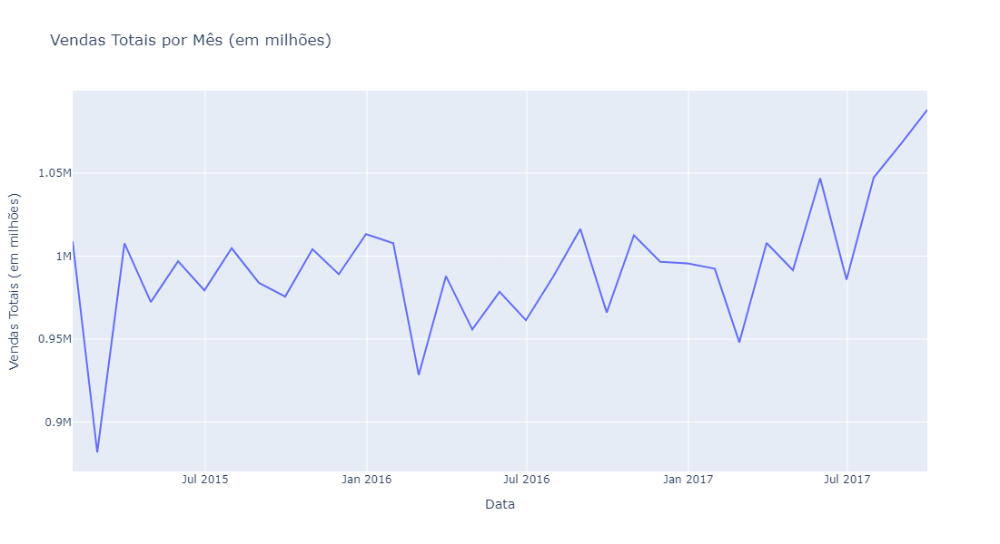

In [29]:
# Agrupar os dados por ano e mês e somar as vendas
sales_over_time = df_filtrado.resample('M', on='order date (DateOrders)').sum()['Sales']

# Criar um DataFrame a partir da série
sales_over_time_df = sales_over_time.reset_index()

# Calculando a variação das vendas
sales_over_time_df['Variação de Vendas'] = sales_over_time_df['Sales'].diff()

# Calculando a variação percentual das vendas
sales_over_time_df['Variação Percentual'] = sales_over_time_df['Sales'].pct_change()

# Convertendo a variação para porcentagem e arredondando
sales_over_time_df['Variação Percentual'] = (sales_over_time_df['Variação Percentual'] * 100).round(2)


# Visualização
fig = px.line(sales_over_time_df, x='order date (DateOrders)', y='Sales', 
              title='Vendas Totais por Mês (em milhões)', labels={'order date (DateOrders)': 'Data', 'Sales': 'Vendas Totais (em milhões)'})
fig.update_layout(width=1000, height=600)
fig.show()

In [30]:
sales_over_time.describe()

count    3.300000e+01
mean     9.935833e+05
std      3.796040e+04
min      8.816670e+05
25%      9.784447e+05
50%      9.924190e+05
75%      1.007894e+06
max      1.088272e+06
Name: Sales, dtype: float64

As vendas variam em torno de uma média de 993 mil, terminando setembro/2017 na maior alta histórica, cerca de 1,08MM entre todos os produtos comercializados.

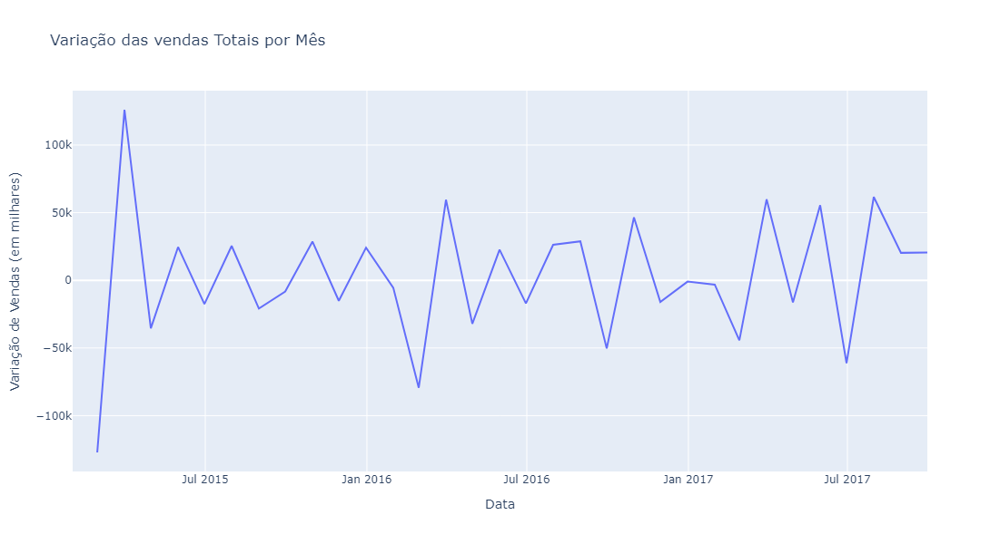

In [32]:
# Visualização
fig = px.line(sales_over_time_df, x='order date (DateOrders)', y='Variação de Vendas', 
              title='Variação das vendas Totais por Mês', labels={'order date (DateOrders)': 'Data', 'Variação de Vendas':'Variação de Vendas (em milhares)'})
fig.update_layout(width=1000, height=600)
fig.show()

In [33]:
sales_over_time_df[abs(sales_over_time_df['Variação Percentual']) >= 5]

,order date (DateOrders),Sales,Variação de Vendas,Variação Percentual
1,2015-02-28,8.816670e+05,-127187.442220,-12.61
2,2015-03-31,1.007758e+06,126091.062438,14.30
13,2016-02-29,9.283721e+05,-79433.621397,-7.88
14,2016-03-31,9.879204e+05,59548.221787,6.41
26,2017-03-31,1.007894e+06,59852.532387,6.31
28,2017-05-31,1.047041e+06,55507.750888,5.60
29,2017-06-30,9.857683e+05,-61272.661324,-5.85
30,2017-07-31,1.047375e+06,61607.130510,6.25


As vendas oscilaram durante todo o período.

### Destaque para os meses de variação positiva nas vendas:

* **Março/2015**: 14,30%,  
* **Março/2016**: 6,41%
* **Março/2017**: 6,31%

### Destaque para os meses de variação negativa nas vendas:

* **Fevereiro/2015**: -12,61%,  
* **Fevereiro/2016**: -7,88%
* **Junho/2017**: -5,85%

### Vendas por segmento de cliente

In [34]:
# Agrupando por 'Category Name' e somando as vendas
Venda_por_segmento = df_filtrado.groupby('Customer Segment')['Sales'].sum().reset_index()

Venda_por_segmento['Sales'] = (Venda_por_segmento['Sales'] / 1000000).round(2)

Venda_por_segmento.rename(columns={'Sales': 'Venda (em milhões)', 'Customer Segment': 'Segmento de Cliente'}, inplace=True)

# Ordenando os resultados
Venda_por_segmento = Venda_por_segmento.sort_values(by='Venda (em milhões)', ascending=False).reset_index(drop=True)

Venda_por_segmento

,Segmento de Cliente,Venda (em milhões)
0,Consumer,17.00
1,Corporate,9.96
2,Home Office,5.83


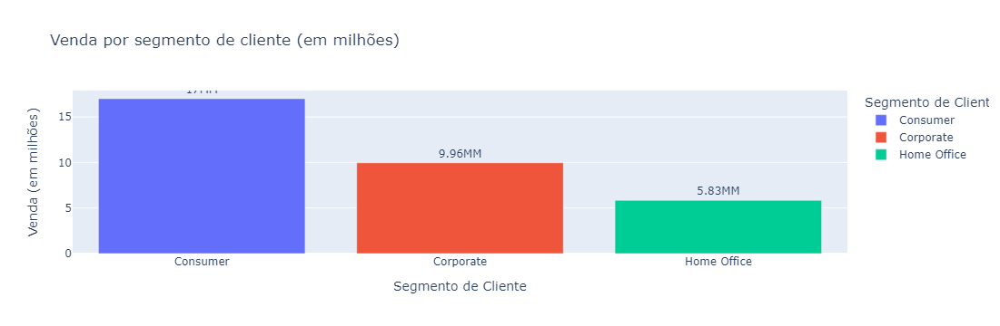

In [35]:
fig = px.bar(Venda_por_segmento, x='Segmento de Cliente', y='Venda (em milhões)', color = 'Segmento de Cliente',
             text = 'Venda (em milhões)', title='Venda por segmento de cliente (em milhões)')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.show()

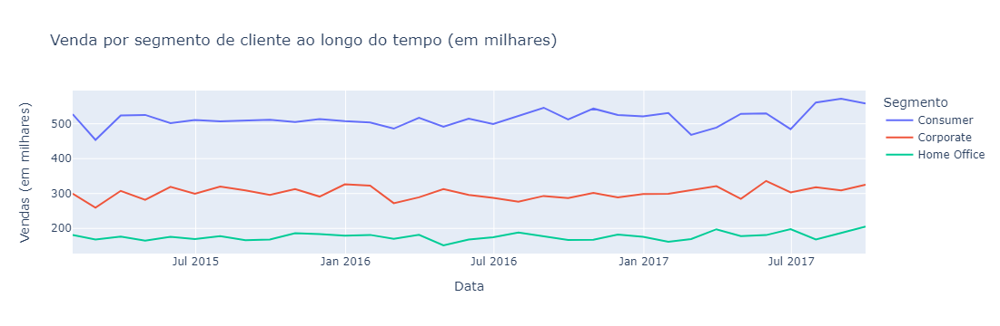

In [36]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Venda_por_segmento_e_data = df_filtrado.groupby(['Customer Segment', pd.Grouper(key='order date (DateOrders)', freq='M')])['Sales'].sum().reset_index()

Venda_por_segmento_e_data['Sales'] = (Venda_por_segmento_e_data['Sales'] / 1000).round(2)
Venda_por_segmento_e_data.rename(columns={'Customer Segment':'Segmento', 'Sales': 'Vendas (em milhares)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação das vendas por segmento
Venda_por_segmento_e_data['Variação de Vendas'] = Venda_por_segmento_e_data.groupby('Segmento')['Vendas (em milhares)'].diff()

# Calculando a variação percentual das vendas por segmento
Venda_por_segmento_e_data['Variação Percentual'] = Venda_por_segmento_e_data.groupby('Segmento')['Vendas (em milhares)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Venda_por_segmento_e_data['Variação Percentual'] = (Venda_por_segmento_e_data['Variação Percentual'] * 100).round(2)

# Criar o gráfico usando Plotly
fig = px.line(Venda_por_segmento_e_data, x='Data', y='Vendas (em milhares)', color='Segmento', title='Venda por segmento de cliente ao longo do tempo (em milhares)')

# Mostrar o gráfico
fig.show()

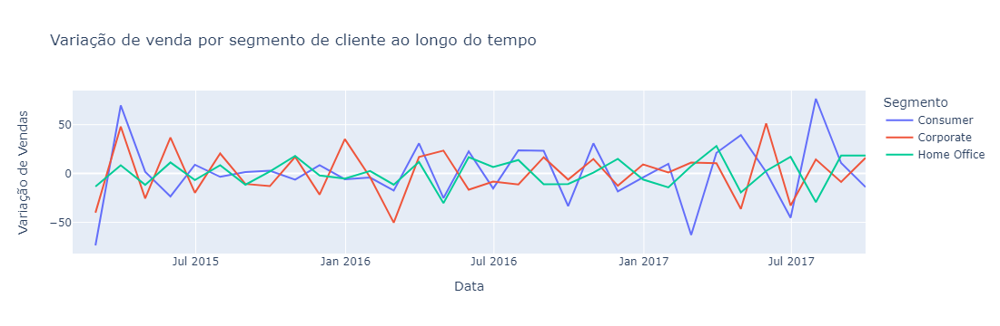

In [37]:
# Criar o gráfico usando Plotly
fig = px.line(Venda_por_segmento_e_data, x='Data', y='Variação de Vendas', color='Segmento', title='Variação de venda por segmento de cliente ao longo do tempo')

# Mostrar o gráfico
fig.show()

In [38]:
# Destacando os segmentos e os meses que tiveram uma variação maior que 10% nas vendas
Venda_por_segmento_e_data[abs(Venda_por_segmento_e_data['Variação Percentual']) >= 10]

,Segmento,Data,Vendas (em milhares),Variação de Vendas,Variação Percentual
1,Consumer,2015-02-28,453.84,-73.70,-13.97
2,Consumer,2015-03-31,523.52,69.68,15.35
25,Consumer,2017-02-28,467.99,-62.99,-11.86
30,Consumer,2017-07-31,561.07,76.60,15.81
34,Corporate,2015-02-28,259.73,-40.18,-13.40
35,Corporate,2015-03-31,307.75,48.02,18.49
37,Corporate,2015-05-31,319.06,36.91,13.08
44,Corporate,2015-12-31,326.57,35.23,12.09
46,Corporate,2016-02-29,272.38,-50.38,-15.61
60,Corporate,2017-04-30,284.89,-36.27,-11.29


As vendas por seguimento oscilaram durante todo o período.

### Destaque para os meses de variação positiva nas vendas:

* **Corporate - Março/2015**: 18,49%,  
* **Home Office - Março/2017**: 16,61%
* **Corporate - Março/2017**: 18,01%

### Destaque para os meses de variação negativa nas vendas:

* **Home Office - Abril/2016**: -16,74% 
* **Corporate - Fevereiro/2016**: -15,61%
* **Consumer - Fevereiro/2015**: -13,97%

### Categorias com mais vendas

In [39]:
# Agrupando por 'Category Name' e somando as vendas
vendas_por_categoria = df_filtrado.groupby('Category Name')['Sales'].sum().reset_index()

vendas_por_categoria['Sales'] = (vendas_por_categoria['Sales'] / 1000000).round(3)

vendas_por_categoria.rename(columns={'Sales': 'Vendas (em milhões)', 'Category Name': 'Nome da Categoria'}, inplace=True)

# Ordenando os resultados
vendas_por_categoria = vendas_por_categoria.sort_values(by='Vendas (em milhões)', ascending=False).reset_index(drop=True)

#sales_by_category_sorted = sales_by_category_sorted.head(10)

vendas_por_categoria

,Nome da Categoria,Vendas (em milhões)
0,Fishing,6.632
1,Cleats,4.237
2,Camping & Hiking,3.942
3,Cardio Equipment,3.527
4,Women's Apparel,3.008
5,Water Sports,2.977
6,Indoor/Outdoor Games,2.762
7,Men's Footwear,2.760
8,Shop By Sport,1.252
9,Electronics,0.357


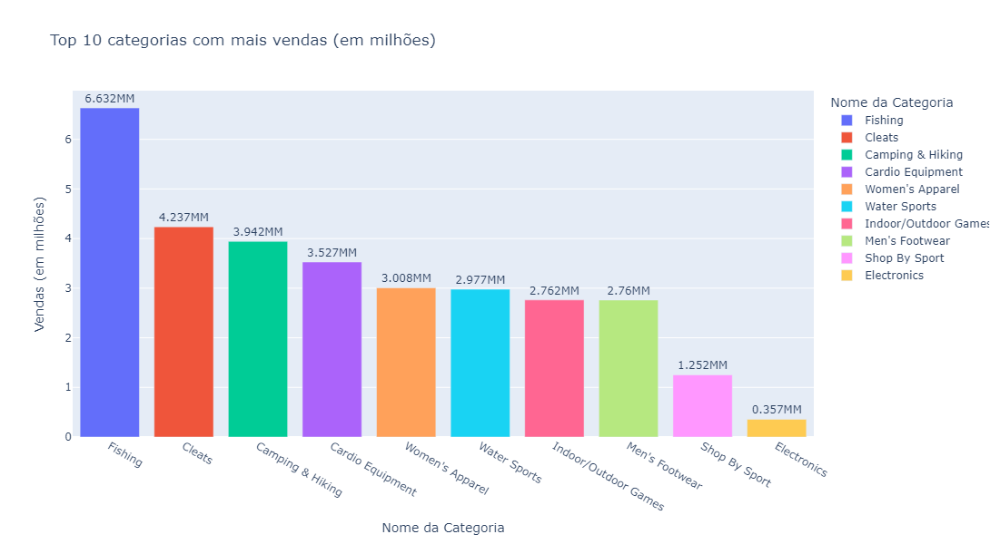

In [40]:
fig = px.bar(vendas_por_categoria.head(10), x='Nome da Categoria', y='Vendas (em milhões)', color = 'Nome da Categoria',
             text = 'Vendas (em milhões)', title='Top 10 categorias com mais vendas (em milhões)')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

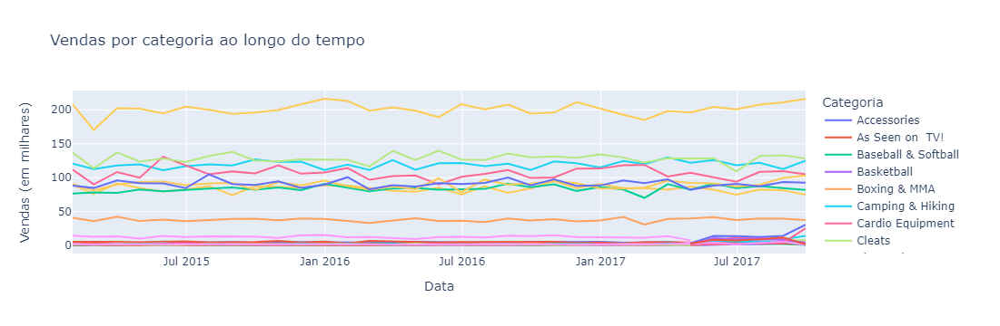

In [42]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Vendas_por_categoria_e_data = df_filtrado.groupby(['Category Name', pd.Grouper(key='order date (DateOrders)', freq='M')])['Sales'].sum().reset_index()

Vendas_por_categoria_e_data['Sales'] = (Vendas_por_categoria_e_data['Sales'] / 1000).round(2)
Vendas_por_categoria_e_data.rename(columns={'Category Name':'Categoria', 'Sales': 'Vendas (em milhares)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação das vendas por categoria
Vendas_por_categoria_e_data['Variação de Vendas'] = Vendas_por_categoria_e_data.groupby('Categoria')['Vendas (em milhares)'].diff()

# Calculando a variação percentual das vendas por categoria
Vendas_por_categoria_e_data['Variação Percentual'] = Vendas_por_categoria_e_data.groupby('Categoria')['Vendas (em milhares)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Vendas_por_categoria_e_data['Variação Percentual'] = (Vendas_por_categoria_e_data['Variação Percentual'] * 100).round(2)

# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_categoria_e_data, x='Data', y='Vendas (em milhares)', color='Categoria', title='Vendas por categoria ao longo do tempo')

# Mostrar o gráfico
fig.show()

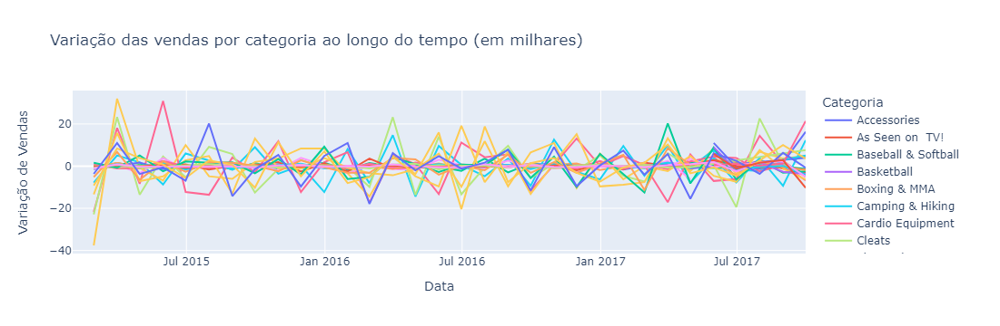

In [43]:
# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_categoria_e_data, x='Data', y='Variação de Vendas', color='Categoria', title='Variação das vendas por categoria ao longo do tempo (em milhares)')

# Mostrar o gráfico
fig.show()

In [44]:
# Destacando as categorias e os meses que tiveram uma variação maior que 500% nas vendas
Vendas_por_categoria_e_data[abs(Vendas_por_categoria_e_data['Variação Percentual']) > 500.00]

,Categoria,Data,Vendas (em milhares),Variação de Vendas,Variação Percentual
289,Fitness Accessories,2017-09-30,4.20,3.92,1400.00
478,Hockey,2017-09-30,8.25,7.61,1189.06
667,Strength Training,2017-09-30,25.37,21.40,539.04


As vendas por categoria oscilaram durante todo o período.

### Destaque para os meses de variação positiva nas vendas:

* **Fitness Accessories - Setembro/2017**: 1400%,  
* **Hockey - Setembro/2017**: 1189,06%
* **Strength Training - Setembro/2017**: 539,04%


### Vendas por departamento

In [45]:
# Agrupando por 'Category Name' e somando as vendas
Vendas_por_depart = df_filtrado.groupby('Department Name')['Sales'].sum().reset_index()

Vendas_por_depart['Sales'] = (Vendas_por_depart['Sales'] / 1000000).round(2)

Vendas_por_depart.rename(columns={'Sales': 'Vendas (em milhões)', 'Department Name': 'Departamento'}, inplace=True)

# Ordenando os resultados
Vendas_por_depart = Vendas_por_depart.sort_values(by='Vendas (em milhões)', ascending=False).reset_index(drop=True)

Vendas_por_depart

,Departamento,Vendas (em milhões)
0,Fan Shop,16.37
1,Apparel,7.00
2,Golf,4.40
3,Footwear,3.81
4,Outdoors,0.95
5,Fitness,0.26


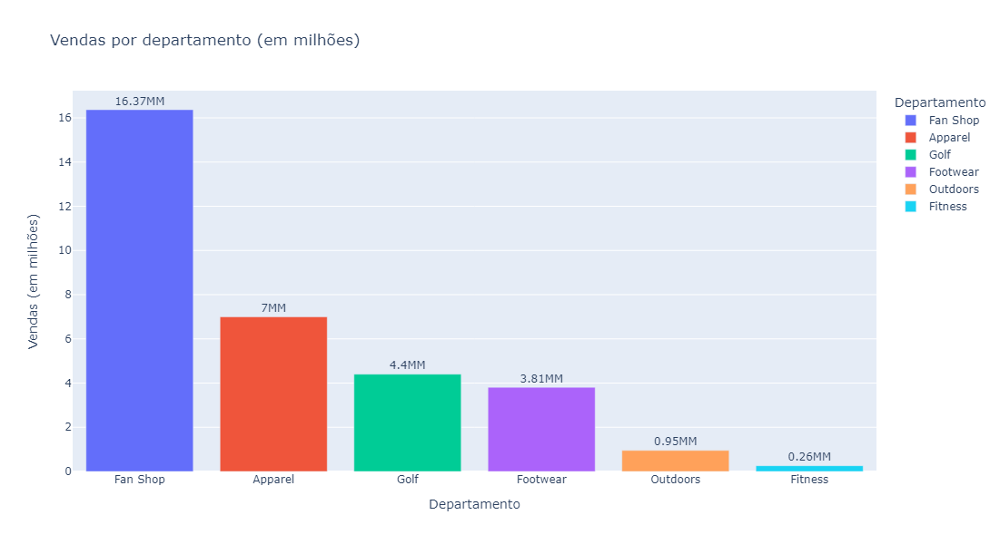

In [46]:
fig = px.bar(Vendas_por_depart, x='Departamento', y='Vendas (em milhões)', color = 'Departamento',
             text = 'Vendas (em milhões)', title='Vendas por departamento (em milhões)')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

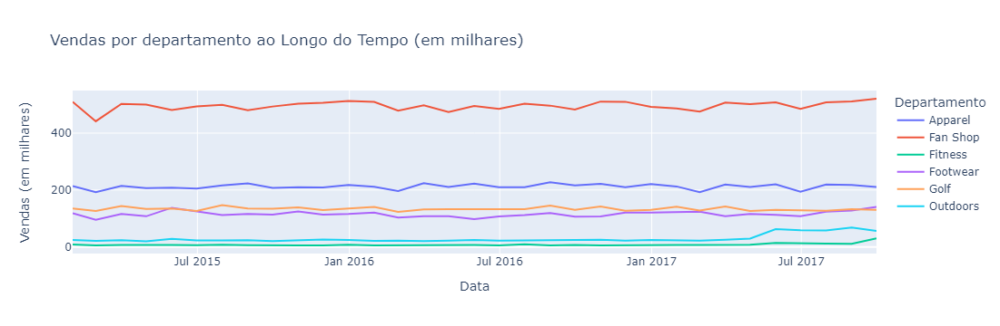

In [47]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Vendas_por_depart_e_data = df_filtrado.groupby(['Department Name', pd.Grouper(key='order date (DateOrders)', freq='M')])['Sales'].sum().reset_index()

Vendas_por_depart_e_data['Sales'] = (Vendas_por_depart_e_data['Sales'] / 1000).round(2)
Vendas_por_depart_e_data.rename(columns={'Department Name':'Departamento', 'Sales': 'Vendas (em milhares)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação das vendas por departamento
Vendas_por_depart_e_data['Variação de Vendas'] = Vendas_por_depart_e_data.groupby('Departamento')['Vendas (em milhares)'].diff()

# Calculando a variação percentual das vendas por departamento
Vendas_por_depart_e_data['Variação Percentual'] = Vendas_por_depart_e_data.groupby('Departamento')['Vendas (em milhares)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Vendas_por_depart_e_data['Variação Percentual'] = (Vendas_por_depart_e_data['Variação Percentual'] * 100).round(2)

# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_depart_e_data, x='Data', y='Vendas (em milhares)', color='Departamento', title='Vendas por departamento ao Longo do Tempo (em milhares)')

# Mostrar o gráfico
fig.show()

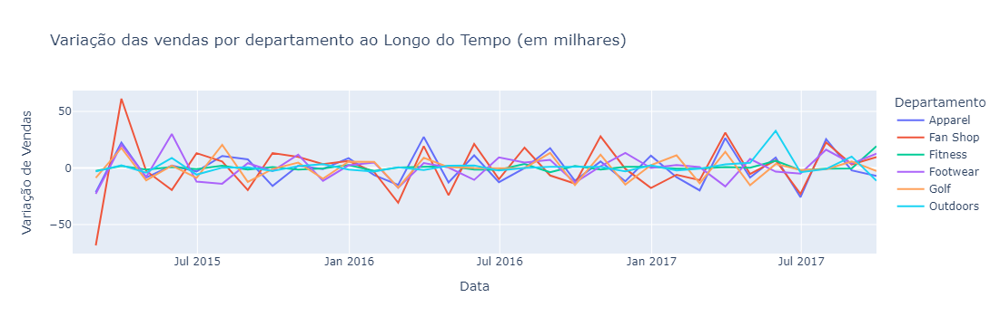

In [48]:
# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_depart_e_data, x='Data', y='Variação de Vendas', color='Departamento', title='Variação das vendas por departamento ao Longo do Tempo (em milhares)')

# Mostrar o gráfico
fig.show()

In [49]:
# Destacando os departamentos e os meses que tiveram uma variação maior que 50% nas vendas
Vendas_por_depart_e_data[abs(Vendas_por_depart_e_data['Variação Percentual']) > 50.00]

,Departamento,Data,Vendas (em milhares),Variação de Vendas,Variação Percentual
77,Fitness,2015-12-31,7.83,2.63,50.58
84,Fitness,2016-07-31,8.87,3.61,68.63
94,Fitness,2017-05-31,13.82,6.29,83.53
98,Fitness,2017-09-30,30.07,19.21,176.89
193,Outdoors,2017-05-31,62.28,32.88,111.84


As vendas por departamento oscilaram durante todo o período.

### Destaque para os meses de variação positiva nas vendas:

* **Fitness - Setembro/2017**: 176,89%,  
* **Outdoors - Maio/2017**: 111,84%

### Vendas por Mercado Global

In [50]:
# Agrupando por 'Category Name' e somando as vendas
vendas_por_market = df_filtrado.groupby('Market')['Sales'].sum().reset_index()

vendas_por_market['Sales'] = (vendas_por_market['Sales'] / 1000000).round(2)
vendas_por_market.rename(columns={'Sales': 'Vendas (em milhões)', 'Market': 'Mercado Global'}, inplace=True)

# Ordenando os resultados
vendas_por_market = vendas_por_market.sort_values(by='Vendas (em milhões)', ascending=False).reset_index(drop=True)

vendas_por_market

,Mercado Global,Vendas (em milhões)
0,LATAM,9.82
1,Europe,9.19
2,Pacific Asia,6.74
3,USCA,4.84
4,Africa,2.21


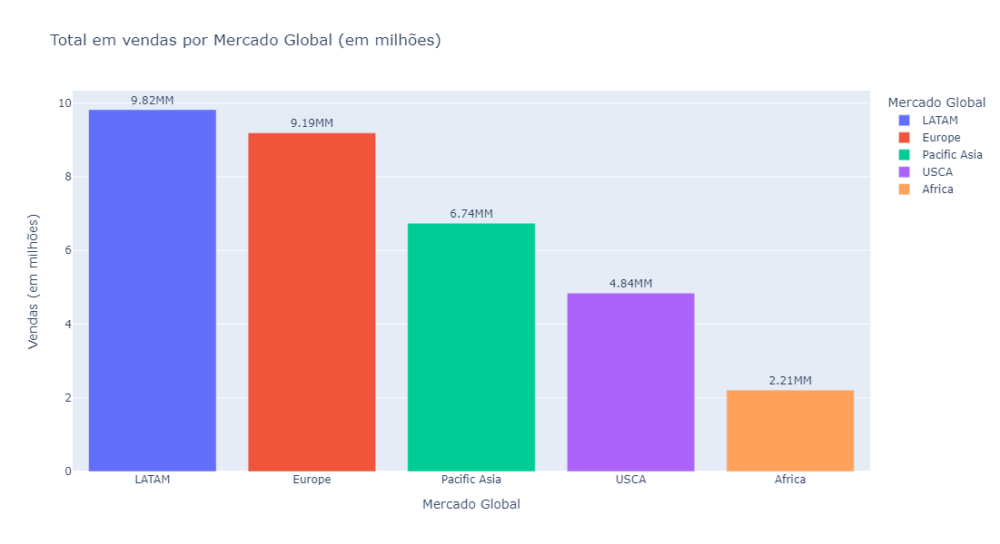

In [51]:
fig = px.bar(vendas_por_market, x='Mercado Global', y='Vendas (em milhões)', color = 'Mercado Global',
             text = 'Vendas (em milhões)', title='Total em vendas por Mercado Global (em milhões)')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

In [270]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Vendas_por_market_e_data = df_filtrado.groupby(['Market', pd.Grouper(key='order date (DateOrders)', freq='M')])['Sales'].sum().reset_index()

Vendas_por_market_e_data['Sales'] = (Vendas_por_market_e_data['Sales'] / 1000000).round(2)
Vendas_por_market_e_data.rename(columns={'Market':'Mercado Global', 'Sales': 'Vendas (em milhões)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação das vendas por mercado global
Vendas_por_market_e_data['Variação de Vendas'] = Vendas_por_market_e_data.groupby('Mercado Global')['Vendas (em milhões)'].diff()

# Calculando a variação percentual das vendas por mercado global
Vendas_por_market_e_data['Variação Percentual'] = Vendas_por_market_e_data.groupby('Mercado Global')['Vendas (em milhões)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Vendas_por_market_e_data['Variação Percentual'] = (Vendas_por_market_e_data['Variação Percentual'] * 100).round(2)

# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_market_e_data, x='Data', y='Vendas (em milhões)', color='Mercado Global', title='Vendas por Mercado Global ao longo do tempo (em milhões)')

# Mostrar o gráfico
fig.show()

In [271]:
# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_market_e_data, x='Data', y='Variação de Vendas', color='Mercado Global', title='Variação de vendas por Mercado Global ao longo do tempo (em milhões)')

# Mostrar o gráfico
fig.show()

In [272]:
# Destacando os mercados globais e os meses que tiveram uma variação maior que 200% nas vendas
Vendas_por_market_e_data[abs(Vendas_por_market_e_data['Variação Percentual']) > 200.00]

,Mercado Global,Data,Vendas (em milhões),Variação de Vendas,Variação Percentual
1,Africa,2016-09-30,0.49,0.40,444.44
7,Europe,2015-06-30,0.98,0.96,4800.00
13,Europe,2016-09-30,0.16,0.13,433.33
18,Europe,2017-06-30,0.43,0.32,290.91
34,Pacific Asia,2015-11-30,0.99,0.73,280.77
41,Pacific Asia,2016-09-30,0.29,0.21,262.50


As vendas por seguimento oscilaram durante todo o período.

### Destaque para os meses de variação positiva nas vendas:

* **Europe - Junho/2015**: 4800% - Junho e setembro foram meses bem favoráveis para o mercado Europeu.
* **Pacific Asia - Novembro/2015**: 280,77% - Para este mercado, os meses novembro e setembro foram bem positivos.

### Vendas por região do cliente

In [52]:
# Agrupando por 'Category Name' e somando as vendas
Vendas_por_regiao_do_cliente = df_filtrado.groupby('Customer Country')['Sales'].sum().reset_index()

Vendas_por_regiao_do_cliente['Sales'] = (Vendas_por_regiao_do_cliente['Sales'] / 1000000).round(2)
Vendas_por_regiao_do_cliente.rename(columns={'Sales': 'Vendas (em milhões)', 'Customer Country': 'País de origem do cliente'}, inplace=True)

# Ordenando os resultados
Vendas_por_regiao_do_cliente = Vendas_por_regiao_do_cliente.sort_values(by='Vendas (em milhões)', ascending=False).reset_index(drop=True)

Vendas_por_regiao_do_cliente

,País de origem do cliente,Vendas (em milhões)
0,EE. UU.,20.18
1,Puerto Rico,12.61


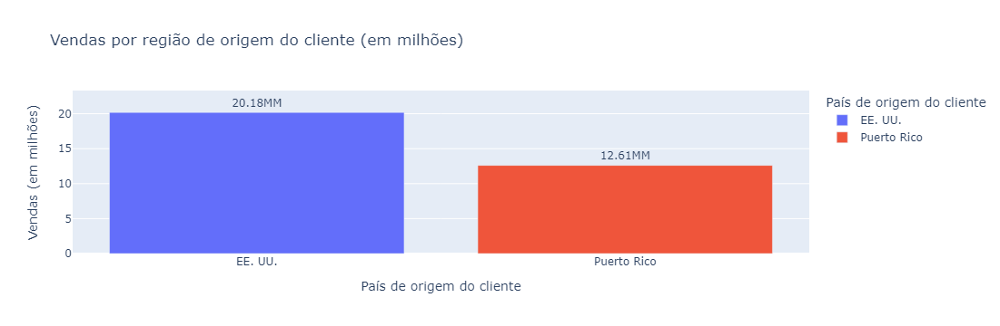

In [53]:
fig = px.bar(Vendas_por_regiao_do_cliente, x='País de origem do cliente', y='Vendas (em milhões)', color = 'País de origem do cliente',
             text = 'Vendas (em milhões)', title='Vendas por região de origem do cliente (em milhões)')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.show()

Os clientes da empresa são basicamente de duas nacionalidades: Estados Unidos e Porto Rico.

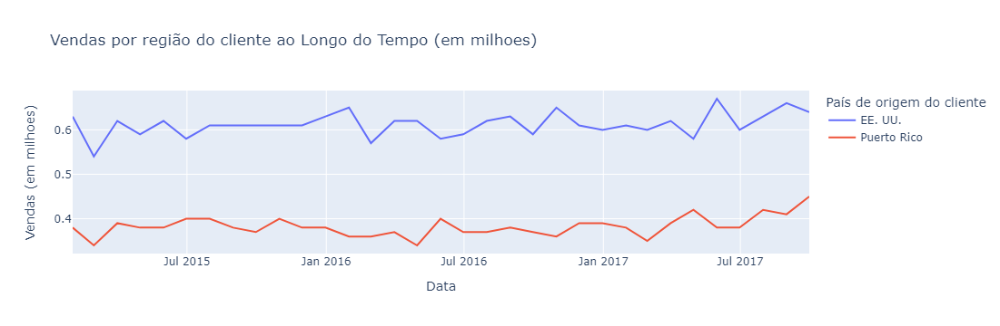

In [54]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Vendas_por_regiao_do_cliente_e_data = df_filtrado.groupby(['Customer Country', pd.Grouper(key='order date (DateOrders)', freq='M')])['Sales'].sum().reset_index()

Vendas_por_regiao_do_cliente_e_data['Sales'] = (Vendas_por_regiao_do_cliente_e_data['Sales'] / 1000000).round(2)

Vendas_por_regiao_do_cliente_e_data.rename(columns={'Customer Country':'País de origem do cliente', 'Sales': 'Vendas (em milhoes)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação das vendas por regiao do cliente
Vendas_por_regiao_do_cliente_e_data['Variação de Vendas'] = Vendas_por_regiao_do_cliente_e_data.groupby('País de origem do cliente')['Vendas (em milhoes)'].diff()

# Calculando a variação percentual das vendas por regiao do cliente
Vendas_por_regiao_do_cliente_e_data['Variação Percentual'] = Vendas_por_regiao_do_cliente_e_data.groupby('País de origem do cliente')['Vendas (em milhoes)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Vendas_por_regiao_do_cliente_e_data['Variação Percentual'] = (Vendas_por_regiao_do_cliente_e_data['Variação Percentual'] * 100).round(2)

# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_regiao_do_cliente_e_data, x='Data', y='Vendas (em milhoes)', color='País de origem do cliente', title='Vendas por região do cliente ao Longo do Tempo (em milhoes)')

# Mostrar o gráfico
fig.show()

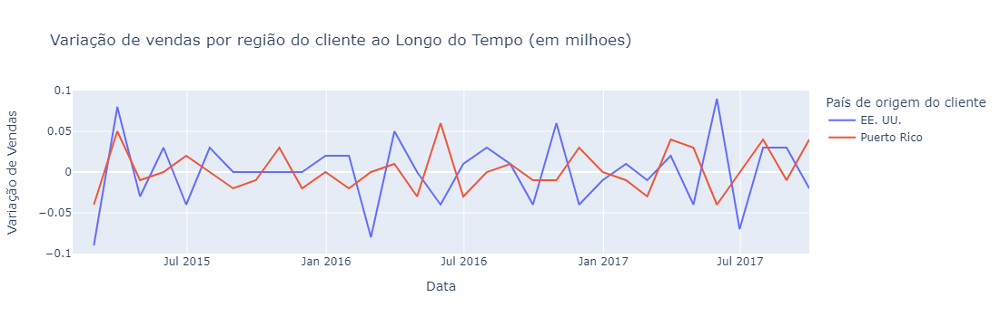

In [55]:
# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_regiao_do_cliente_e_data, x='Data', y='Variação de Vendas', color='País de origem do cliente', title='Variação de vendas por região do cliente ao Longo do Tempo (em milhoes)')

# Mostrar o gráfico
fig.show()

In [56]:
# Destacando os mercados globais e os meses que tiveram uma variação maior que 10% nas vendas
Vendas_por_regiao_do_cliente_e_data[abs(Vendas_por_regiao_do_cliente_e_data['Variação Percentual']) > 10.00]

,País de origem do cliente,Data,Vendas (em milhoes),Variação de Vendas,Variação Percentual
1,EE. UU.,2015-02-28,0.54,-0.09,-14.29
2,EE. UU.,2015-03-31,0.62,0.08,14.81
13,EE. UU.,2016-02-29,0.57,-0.08,-12.31
21,EE. UU.,2016-10-31,0.65,0.06,10.17
28,EE. UU.,2017-05-31,0.67,0.09,15.52
29,EE. UU.,2017-06-30,0.60,-0.07,-10.45
34,Puerto Rico,2015-02-28,0.34,-0.04,-10.53
35,Puerto Rico,2015-03-31,0.39,0.05,14.71
49,Puerto Rico,2016-05-31,0.40,0.06,17.65
59,Puerto Rico,2017-03-31,0.39,0.04,11.43


Durante o período avaliado, percebe-se que:
  
* Os Estados Unidos tiveram variações mais significativas:: **Fevereiro/2015 (-14,29%), Março/2015 (14,81%) e Maio/2017 (15,52%)**  
* Puerto Rico teve variações mais significativas: **Maio/2015 (17,65%), Março/2015 (14,71%) e Março/2017 (11,43%)**


### Vendas por região de destino 

In [60]:
# Agrupando por 'Category Name' e somando as vendas
Vendas_por_destino = df_filtrado.groupby('Order Region')['Sales'].sum().reset_index()

Vendas_por_destino['Sales'] = (Vendas_por_destino['Sales'] / 1000000).round(2)

Vendas_por_destino.rename(columns={'Order Region':'Região de destino', 'Sales': 'Vendas (em milhões)'}, inplace=True)

# Ordenando os resultados
Vendas_por_destino = Vendas_por_destino.sort_values(by='Vendas (em milhões)', ascending=False).reset_index(drop=True)

Vendas_por_destino

,Região de destino,Vendas (em milhões)
0,Central America,5.43
1,Western Europe,4.92
2,South America,2.81
3,Northern Europe,1.80
4,Southern Europe,1.71
5,Oceania,1.65
6,Caribbean,1.58
7,West of USA,1.49
8,Southeast Asia,1.47
9,East of USA,1.31


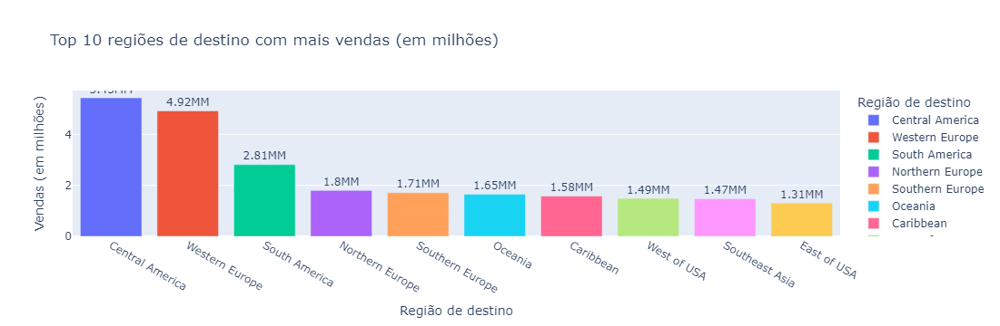

In [61]:
fig = px.bar(Vendas_por_destino.head(10), x='Região de destino', y='Vendas (em milhões)', color = 'Região de destino',
             text = 'Vendas (em milhões)', title='Top 10 regiões de destino com mais vendas (em milhões)')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.show()

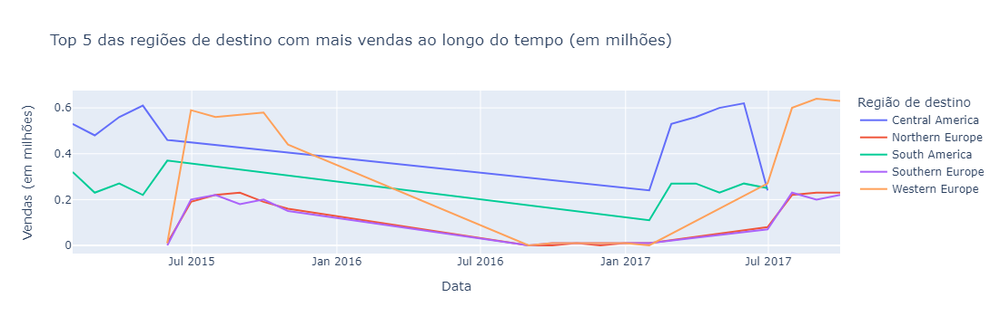

In [62]:
# Obtendo a lista das regiões mais lucrativas no geral
top_5_regions = Vendas_por_destino.head(5)['Região de destino'].tolist()

# Agora, agrupar os dados por categoria e data, somando o lucro
Vendas_por_destino_e_data = df_filtrado.groupby(['Order Region', pd.Grouper(key='order date (DateOrders)', freq='M')])['Sales'].sum().reset_index()

Vendas_por_destino_e_data['Sales'] = (Vendas_por_destino_e_data['Sales'] / 1000000).round(2)

Vendas_por_destino_e_data.rename(columns={'Order Region':'Região de destino', 'Sales': 'Vendas (em milhões)', 'order date (DateOrders)':'Data'}, inplace=True)

# Calculando a variação das vendas por regiao de destino da entrega
Vendas_por_destino_e_data['Variação de Vendas'] = Vendas_por_destino_e_data.groupby('Região de destino')['Vendas (em milhões)'].diff()

# Calculando a variação percentual das vendas por regiao de destino da entrega
Vendas_por_destino_e_data['Variação Percentual'] = Vendas_por_destino_e_data.groupby('Região de destino')['Vendas (em milhões)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Vendas_por_destino_e_data['Variação Percentual'] = (Vendas_por_destino_e_data['Variação Percentual'] * 100).round(2)

# Filtrando do dataframe 'Lucro_por_regiao_e_data' somente as regiões do 'top_5_regions'
Vendas_por_destino_e_data_filtrado = Vendas_por_destino_e_data[Vendas_por_destino_e_data['Região de destino'].isin(top_5_regions)]

# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_destino_e_data_filtrado, x='Data', y='Vendas (em milhões)', color='Região de destino', title='Top 5 das regiões de destino com mais vendas ao longo do tempo (em milhões)')

# Mostrar o gráfico
fig.show()

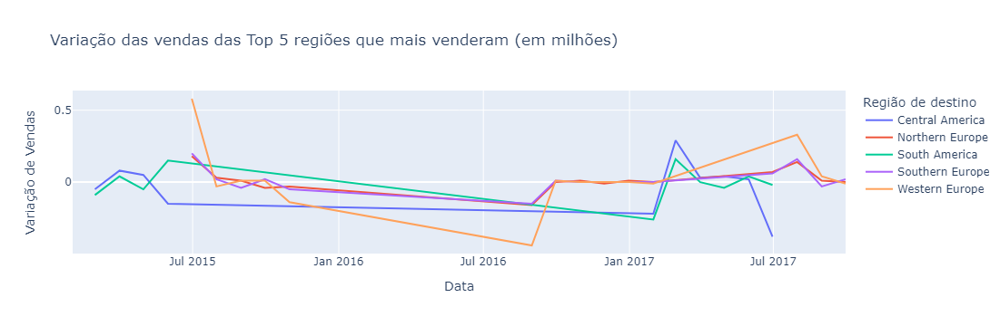

In [63]:
# Criar o gráfico usando Plotly
fig = px.line(Vendas_por_destino_e_data_filtrado, x='Data', y='Variação de Vendas', color='Região de destino', title='Variação das vendas das Top 5 regiões que mais venderam (em milhões)')

# Mostrar o gráfico
fig.show()

In [64]:
# Destacando os destinos das entregas e os meses que tiveram uma variação maior que 1000% nas vendas
Vendas_por_destino_e_data[~Vendas_por_destino_e_data['Variação Percentual'].isin([np.inf, -np.inf]) &
    (abs(Vendas_por_destino_e_data['Variação Percentual']) > 500.00)]

,Região de destino,Data,Vendas (em milhões),Variação de Vendas,Variação Percentual
18,Central Africa,2016-09-30,0.07,0.06,600.0
41,East Africa,2016-09-30,0.08,0.07,700.0
63,Eastern Europe,2016-09-30,0.14,0.12,600.0
75,Northern Europe,2015-06-30,0.19,0.18,1800.0
86,Northern Europe,2017-06-30,0.08,0.07,700.0
150,Southern Europe,2017-06-30,0.07,0.06,600.0
160,West Africa,2016-09-30,0.15,0.13,650.0
177,Western Europe,2015-06-30,0.59,0.58,5800.0


As vendas de acordo com a região de destino oscilaram durante todo o período.

### Destaque para os meses de variação positiva nas vendas:

* **Northern Europe - Junho/2015**: 1800% 
* **Western Europe - Junho/2015**: 5800%   
  
  
* Regiões da Europa como um todo tiveram bons desempenhos nos meses de junho e setembro

<a id="desempenho_categoria_produto"></a>
## <b>4.3 Análise de Lucratividade</b>

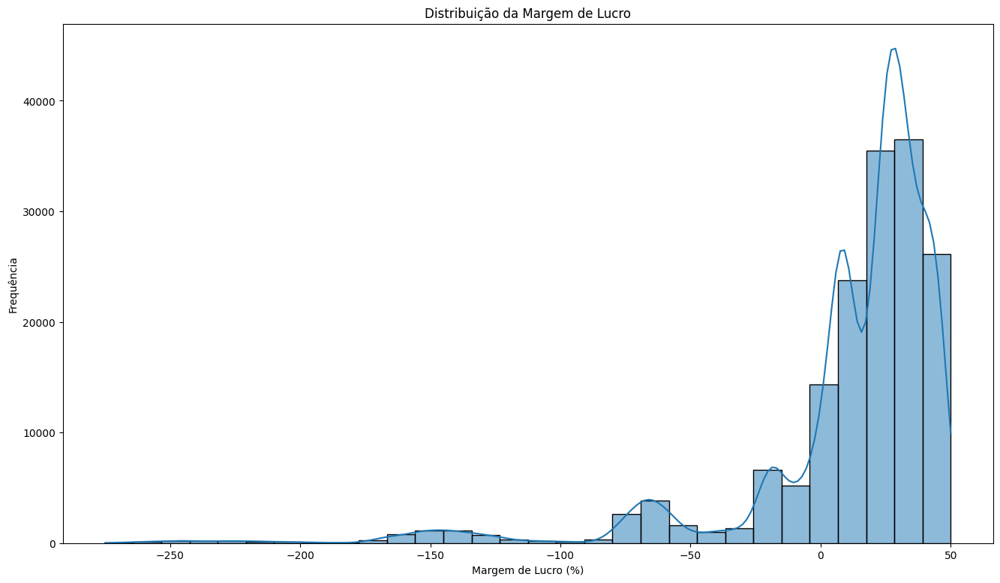

In [65]:
# Criando uma nova coluna, margem de lucro = (Benefício por pedido / Vendas) * 100
df_filtrado['Profit Margin'] = (df_filtrado['Benefit per order'] / df_filtrado['Sales']) * 100

# Visualizando a distribuição da margem de lucro
plt.figure(figsize=(16, 9))
sns.histplot(df_filtrado['Profit Margin'], bins=30, kde=True)
plt.title('Distribuição da Margem de Lucro')
plt.xlabel('Margem de Lucro (%)')
plt.ylabel('Frequência')
plt.show()

In [66]:
df_filtrado['Benefit per order'].describe()

count    164572.000000
mean         21.449250
std          97.492779
min       -1844.979980
25%           7.420000
50%          31.670000
75%          63.860001
max         721.599976
Name: Benefit per order, dtype: float64

([0], [Text(0, 0, '')])

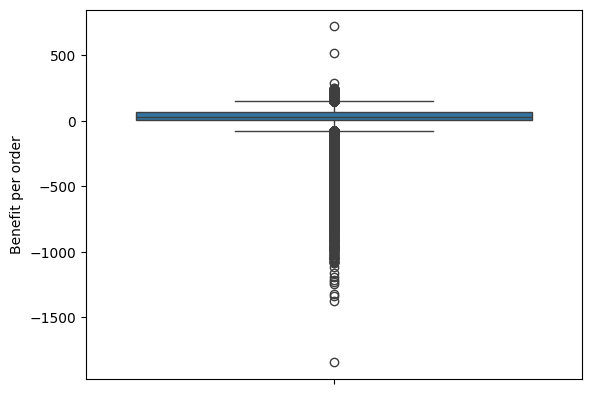

In [67]:
fig = sns.boxplot(y='Benefit per order', data=df_filtrado)
plt.xticks(rotation=90)

O boxplot acima mostra que a mediana, Q1 (primeiro quartil) e Q3 (terceiro quartil) estão muito próximos a zero, ou seja, para grande maioria dos casos não há uma margem de lucro positiva significante na venda dos produtos, mesmo com os outliers acima do limite superior. Além disso, há outliers bem abaixo do limite inferior e bem abaixo de zero, o que indica que a distribuição é bem assimétrica à esquerda e também que grande parte das vendas gera prejuízo à empresa.

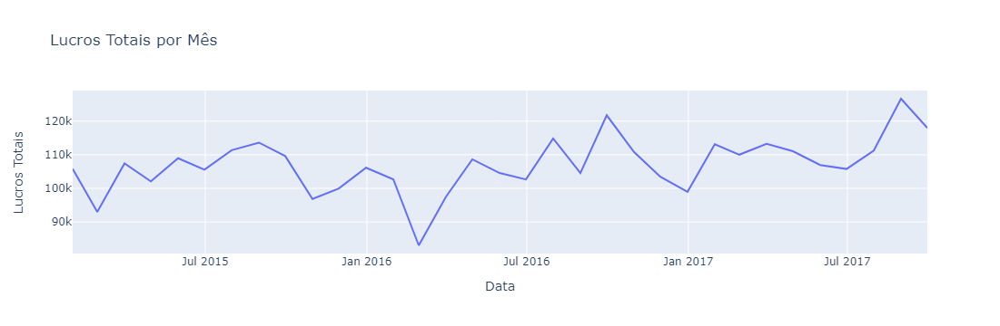

In [68]:
# Agrupar os dados por ano e mês e somar as vendas
benefit_over_time = df_filtrado.resample('M', on='order date (DateOrders)').sum()['Benefit per order']

# Criar um DataFrame a partir da série
benefit_over_time_df = benefit_over_time.reset_index()

# Calculando a variação das vendas
benefit_over_time_df['Variação do Lucro'] = benefit_over_time_df['Benefit per order'].diff()

# Calculando a variação percentual das vendas
benefit_over_time_df['Variação Percentual'] = benefit_over_time_df['Benefit per order'].pct_change()

# Convertendo a variação para porcentagem e arredondando
benefit_over_time_df['Variação Percentual'] = (benefit_over_time_df['Variação Percentual'] * 100).round(2)


# Visualização
fig = px.line(benefit_over_time_df, x='order date (DateOrders)', y='Benefit per order', 
              title='Lucros Totais por Mês', labels={'order date (DateOrders)': 'Data', 'Benefit per order': 'Lucros Totais'})
fig.show()

In [69]:
benefit_over_time.describe()

count        33.000000
mean     106968.057397
std        8226.151101
min       83038.990604
25%      102710.810232
50%      106958.890036
75%      111232.069980
max      126668.110171
Name: Benefit per order, dtype: float64

Os lucros variam em torno de uma média de 107 mil, atingindo a máxima histórica com 126 mil, no mês de agosto de 2017.

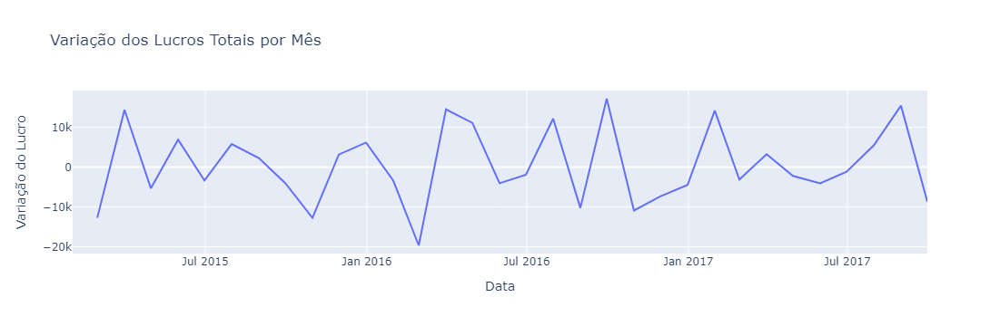

In [71]:
# Visualização
fig = px.line(benefit_over_time_df, x='order date (DateOrders)', y='Variação do Lucro', 
              title='Variação dos Lucros Totais por Mês', labels={'order date (DateOrders)': 'Data'})
fig.show()

In [72]:
# Destacando os meses que tiveram uma variação maior que 10% nos lucros da empresa
benefit_over_time_df[abs(benefit_over_time_df['Variação Percentual']) > 10.00]

,order date (DateOrders),Benefit per order,Variação do Lucro,Variação Percentual
1,2015-02-28,93009.960174,-12763.610006,-12.07
2,2015-03-31,107401.920248,14391.960074,15.47
9,2015-10-31,96839.170095,-12760.050088,-11.64
13,2016-02-29,83038.990604,-19671.819628,-19.15
14,2016-03-31,97525.060235,14486.069631,17.44
15,2016-04-30,108641.619867,11116.559631,11.40
18,2016-07-31,114827.080170,12173.540082,11.86
20,2016-09-30,121734.689953,17168.649881,16.42
24,2017-01-31,113146.160262,14171.800296,14.32
31,2017-08-31,126668.110171,15436.040191,13.88


A lucratividade oscilou durante todo o período avaliado, mas com destaque para as variações:

* **Fevereiro/2016**: -19,15% e **Fevereiro/2015**: -12,07%,  
* **Março/2016**: 16,42% e **Março/2015**: 15,47%

### Lucratividade por categoria

In [73]:
# Agrupando por 'Category Name' e somando as vendas
Lucro_por_categoria = df_filtrado.groupby('Category Name')['Benefit per order'].sum().reset_index()

Lucro_por_categoria['Benefit per order'] = (Lucro_por_categoria['Benefit per order'] / 1000).round(2)

Lucro_por_categoria.rename(columns={'Category Name':'Categoria','Benefit per order': 'Lucro (em milhares)'}, inplace=True)

# Ordenando os resultados
Lucro_por_categoria = Lucro_por_categoria.sort_values(by='Lucro (em milhares)', ascending=False).reset_index(drop=True)

Lucro_por_categoria

,Categoria,Lucro (em milhares)
0,Fishing,730.16
1,Cleats,473.68
2,Camping & Hiking,409.22
3,Cardio Equipment,361.56
4,Women's Apparel,334.16
5,Water Sports,308.59
6,Indoor/Outdoor Games,302.19
7,Men's Footwear,296.36
8,Shop By Sport,124.81
9,Electronics,38.51


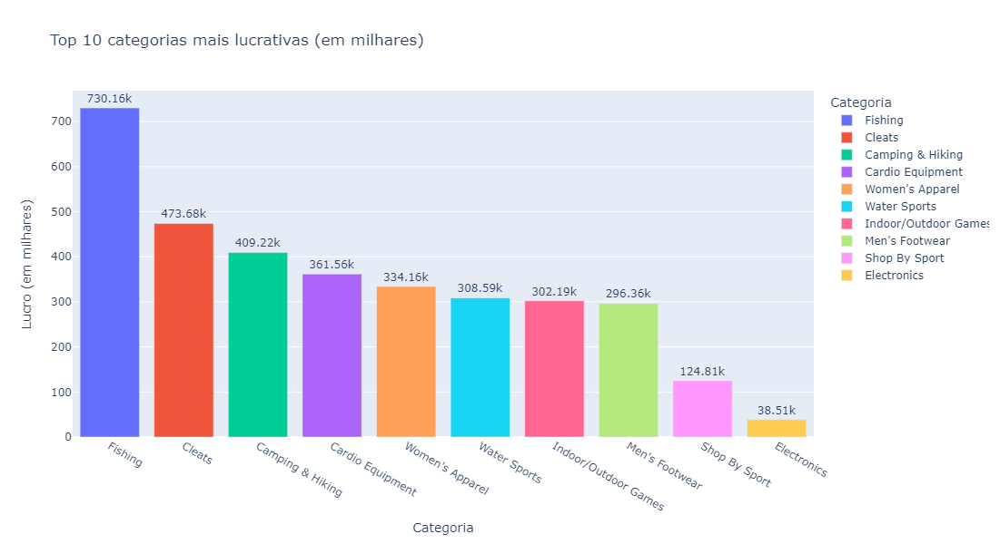

In [74]:
fig = px.bar(Lucro_por_categoria.head(10), x='Categoria', y='Lucro (em milhares)', color = 'Categoria',
             text = 'Lucro (em milhares)', title='Top 10 categorias mais lucrativas (em milhares)')

fig.update_traces(textposition='outside', texttemplate='%{text}k', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

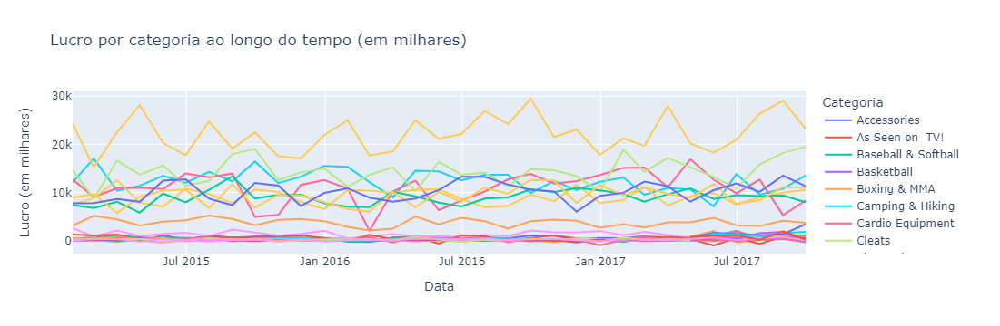

In [75]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Lucro_por_categoria_e_data = df_filtrado.groupby(['Category Name', pd.Grouper(key='order date (DateOrders)', freq='M')])['Benefit per order'].sum().reset_index()

Lucro_por_categoria_e_data.rename(columns={'Category Name':'Categoria', 'Benefit per order': 'Lucro (em milhares)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação dos lucros por categoria
Lucro_por_categoria_e_data['Variação de Lucro'] = Lucro_por_categoria_e_data.groupby('Categoria')['Lucro (em milhares)'].diff()

# Calculando a variação percentual dos lucros por categoria
Lucro_por_categoria_e_data['Variação Percentual'] = Lucro_por_categoria_e_data.groupby('Categoria')['Lucro (em milhares)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Lucro_por_categoria_e_data['Variação Percentual'] = (Lucro_por_categoria_e_data['Variação Percentual'] * 100).round(2)

# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_categoria_e_data, x='Data', y='Lucro (em milhares)', color='Categoria', title='Lucro por categoria ao longo do tempo (em milhares)')

# Mostrar o gráfico
fig.show()

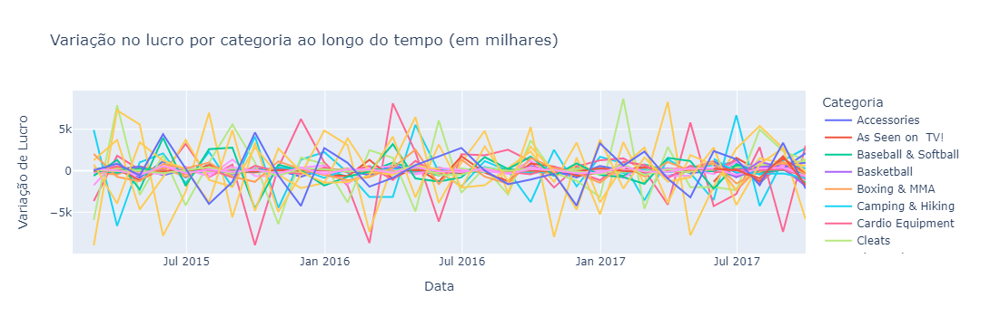

In [76]:
# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_categoria_e_data, x='Data', y='Variação de Lucro', color='Categoria', title='Variação no lucro por categoria ao longo do tempo (em milhares)')
# Mostrar o gráfico
fig.show()

In [77]:
# Destacando os meses em que as categorias tiveram uma variação maior que 2000% nos lucros da empresa
Lucro_por_categoria_e_data[abs(Lucro_por_categoria_e_data['Variação Percentual']) > 2000.00]

,Categoria,Data,Lucro (em milhares),Variação de Lucro,Variação Percentual
289,Fitness Accessories,2017-09-30,961.479996,954.089994,12910.55
352,Golf Bags & Carts,2017-05-31,723.549999,761.370005,-2013.14
478,Hockey,2017-09-30,1241.189989,1183.699989,2058.97
483,Hunting & Shooting,2015-05-31,-407.849995,-421.079991,-3182.77
657,Soccer,2017-05-31,1448.839995,1432.999994,9046.72
711,Trade-In,2016-04-30,432.400003,436.499995,-10646.36


Os lucros oscilaram durante todo o período.

### Destaque para os meses de variação positiva nos lucros:

* **Fitness Accessories - Setembro/2017**: 12910,55%  
* **Soccer - Maio/2017**: 6,41%
* **Hockey - Setembro/2017**: 2058,97%

### Destaque para os meses de variação negativa nos lucros:

* **Trade-In - Abril/2016**: -10646,36%,  
* **Hunting & Shooting - Maio/2015**: -3182,77%
* **Golf Bags & Carts - Maio/2017**: -2013,14%

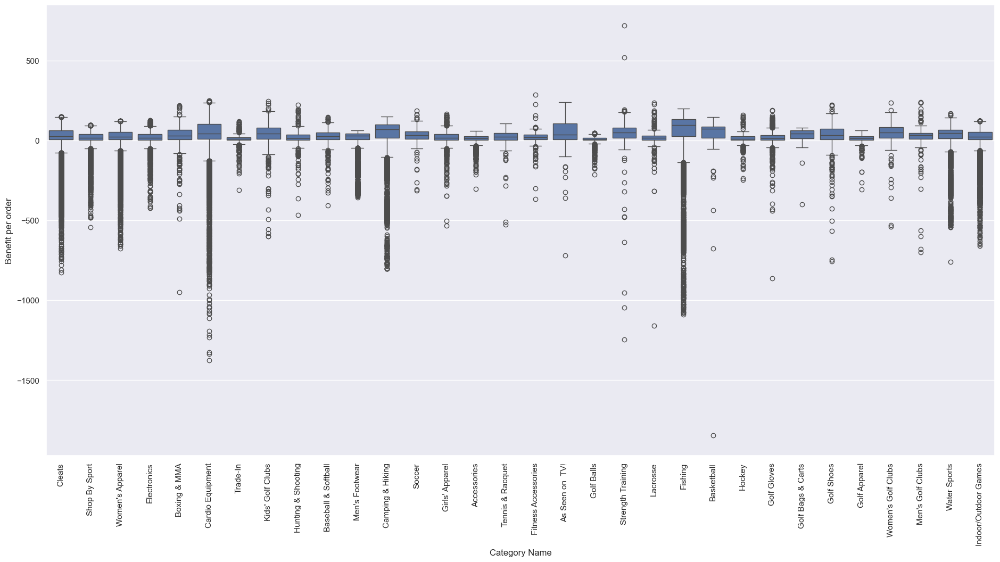

In [78]:
sns.set(rc = {'figure.figsize':(23,11)})
fig = sns.boxplot(x='Category Name', y='Benefit per order', data=df_filtrado)
plt.xticks(rotation=90);

### Lucratividade por Mercado Global

In [79]:
# Agrupando por 'Category Name' e somando as vendas
Lucro_por_market = df_filtrado.groupby('Market')['Benefit per order'].sum().reset_index()

Lucro_por_market['Benefit per order'] = (Lucro_por_market['Benefit per order'] / 1000000).round(2)

Lucro_por_market.rename(columns={'Benefit per order': 'Lucro (em milhões)'}, inplace=True)

# Ordenando os resultados
Lucro_por_market = Lucro_por_market.sort_values(by='Lucro (em milhões)', ascending=False).reset_index(drop=True)

Lucro_por_market

,Market,Lucro (em milhões)
0,LATAM,1.07
1,Europe,1.00
2,Pacific Asia,0.68
3,USCA,0.54
4,Africa,0.24


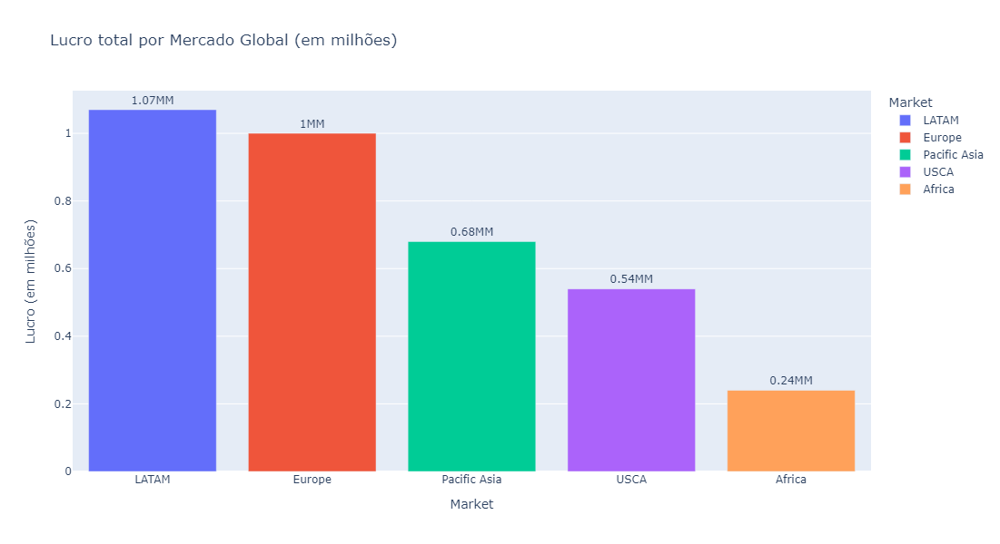

In [81]:
fig = px.bar(Lucro_por_market, x='Market', y='Lucro (em milhões)', color = 'Market',
             text = 'Lucro (em milhões)', title='Lucro total por Mercado Global (em milhões)')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

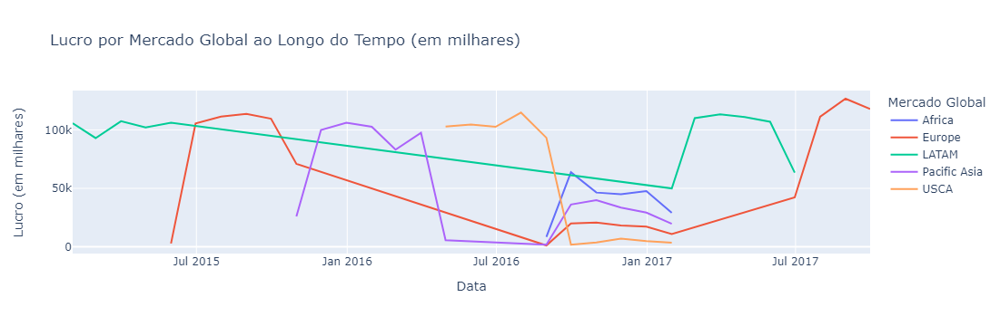

In [82]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Lucro_por_market_e_data = df_filtrado.groupby(['Market', pd.Grouper(key='order date (DateOrders)', freq='M')])['Benefit per order'].sum().reset_index()

Lucro_por_market_e_data.rename(columns={'Market':'Mercado Global', 'Benefit per order': 'Lucro (em milhares)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação dos lucros por mercado global
Lucro_por_market_e_data['Variação de Lucro'] = Lucro_por_market_e_data.groupby('Mercado Global')['Lucro (em milhares)'].diff()

# Calculando a variação percentual dos lucros por mercado global
Lucro_por_market_e_data['Variação Percentual'] = Lucro_por_market_e_data.groupby('Mercado Global')['Lucro (em milhares)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Lucro_por_market_e_data['Variação Percentual'] = (Lucro_por_market_e_data['Variação Percentual'] * 100).round(2)

# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_market_e_data, x='Data', y='Lucro (em milhares)', color='Mercado Global', title='Lucro por Mercado Global ao Longo do Tempo (em milhares)')

# Mostrar o gráfico
fig.show()

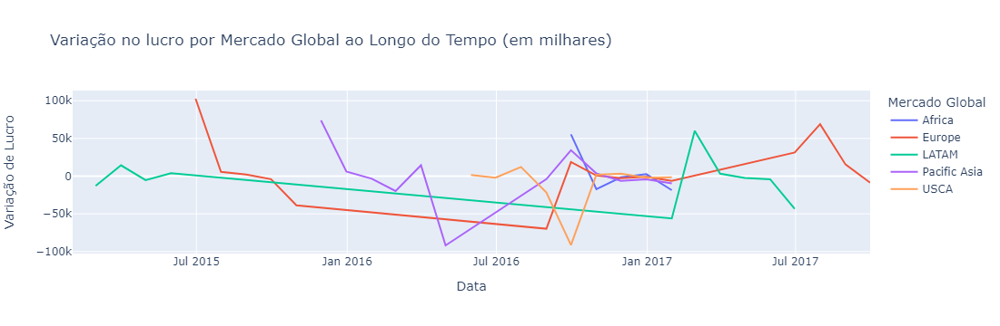

In [83]:
# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_market_e_data, x='Data', y='Variação de Lucro', color='Mercado Global', title='Variação no lucro por Mercado Global ao Longo do Tempo (em milhares)')

# Mostrar o gráfico
fig.show()

In [84]:
# Destacando os meses em que mercados globais tiveram uma variação maior que 1000% nos lucros da empresa
Lucro_por_market_e_data[abs(Lucro_por_market_e_data['Variação Percentual']) > 1000.00]

,Mercado Global,Data,Lucro (em milhares),Variação de Lucro,Variação Percentual
7,Europe,2015-06-30,105576.890319,102701.120345,3571.26
13,Europe,2016-09-30,19998.460034,18804.170045,1574.51
41,Pacific Asia,2016-09-30,36197.930071,34461.110042,1984.15


Os lucros oscilaram durante todo o período.

### Destaque para os meses de variação positiva nos lucros:

* **Europe - junho/2015**: 3571,26%  
* **Pacific Asia - setembro/2016**: 1984,15%

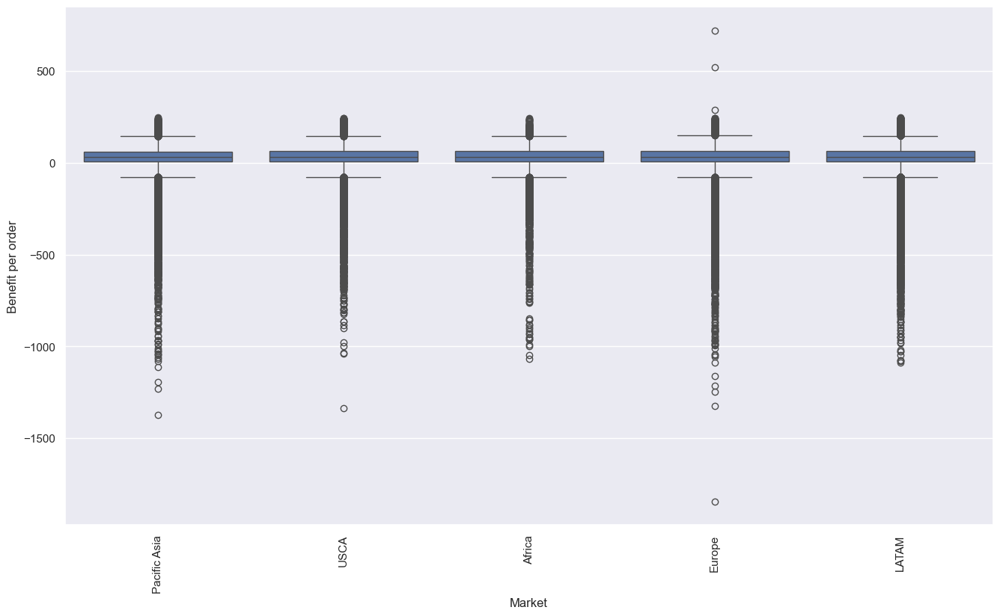

In [85]:
sns.set(rc = {'figure.figsize':(16,9)})
fig = sns.boxplot(x='Market', y='Benefit per order', data=df_filtrado)
plt.xticks(rotation=90);

### Regiões de destino mais lucrativos para a empresa

In [86]:
# Agrupando por 'Category Name' e somando as vendas
Lucro_por_destino = df_filtrado.groupby('Order Region')['Benefit per order'].sum().reset_index()

Lucro_por_destino['Benefit per order'] = (Lucro_por_destino['Benefit per order'] / 1000).round(2)

Lucro_por_destino.rename(columns={'Order Region':'Região de destino', 'Benefit per order': 'Lucro (em milhares)'}, inplace=True)

# Ordenando os resultados
Lucro_por_destino = Lucro_por_destino.sort_values(by='Lucro (em milhares)', ascending=False).reset_index(drop=True)

Lucro_por_destino

,Região de destino,Lucro (em milhares)
0,Central America,586.57
1,Western Europe,531.38
2,South America,315.50
3,Northern Europe,197.23
4,Southern Europe,194.95
5,Caribbean,166.98
6,Oceania,166.39
7,West of USA,159.19
8,Southeast Asia,150.32
9,East of USA,148.77


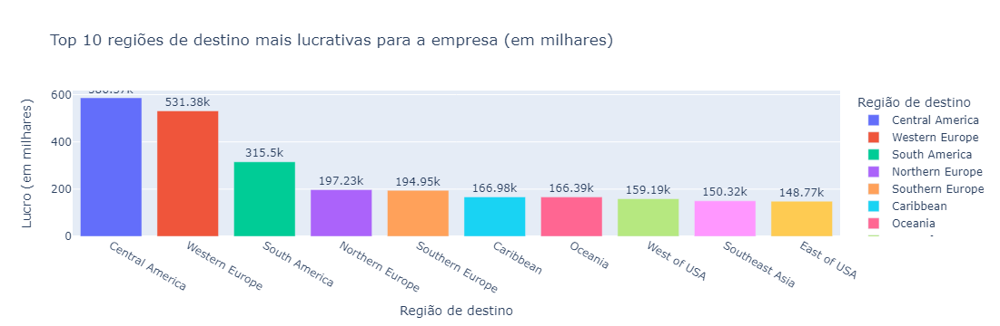

In [90]:
fig = px.bar(Lucro_por_destino.head(10), x='Região de destino', y='Lucro (em milhares)', color = 'Região de destino',
             text = 'Lucro (em milhares)', title='Top 10 regiões de destino mais lucrativas para a empresa (em milhares)')

fig.update_traces(textposition='outside', texttemplate='%{text}k', textfont_size=12)
fig.show()

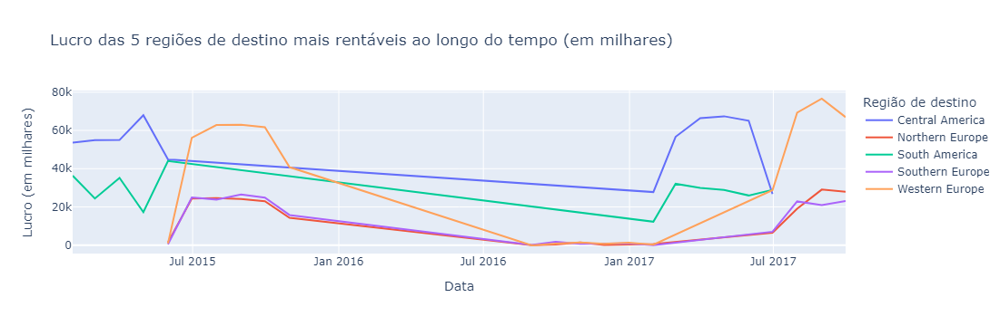

In [91]:
# Obtendo a lista das regiões mais lucrativas no geral
top_5_regions = Lucro_por_destino.head(5)['Região de destino'].tolist()

# Agora, agrupar os dados por categoria e data, somando o lucro
Lucro_por_destino_e_data = df_filtrado.groupby(['Order Region', pd.Grouper(key='order date (DateOrders)', freq='M')])['Benefit per order'].sum().reset_index()

Lucro_por_destino_e_data.rename(columns={'Order Region':'Região de destino', 'Benefit per order': 'Lucro (em milhares)', 'order date (DateOrders)':'Data'}, inplace=True)

# Calculando a variação dos lucros por destino
Lucro_por_destino_e_data['Variação de Lucro'] = Lucro_por_destino_e_data.groupby('Região de destino')['Lucro (em milhares)'].diff()

# Calculando a variação percentual dos lucros por destino
Lucro_por_destino_e_data['Variação Percentual'] = Lucro_por_destino_e_data.groupby('Região de destino')['Lucro (em milhares)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Lucro_por_destino_e_data['Variação Percentual'] = (Lucro_por_destino_e_data['Variação Percentual'] * 100).round(2)

# Filtrando do dataframe 'Lucro_por_regiao_e_data' somente as regiões do 'top_5_regions'
Lucro_por_destino_e_data_filtrado = Lucro_por_destino_e_data[Lucro_por_destino_e_data['Região de destino'].isin(top_5_regions)]

# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_destino_e_data_filtrado, x='Data', y='Lucro (em milhares)', color='Região de destino', title='Lucro das 5 regiões de destino mais rentáveis ao longo do tempo (em milhares)')

# Mostrar o gráfico
fig.show()

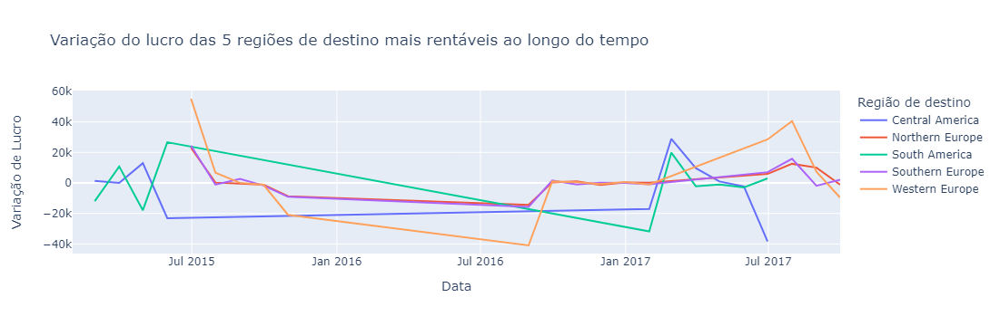

In [94]:
# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_destino_e_data_filtrado, x='Data', y='Variação de Lucro', color='Região de destino', title='Variação do lucro das 5 regiões de destino mais rentáveis ao longo do tempo')

# Mostrar o gráfico
fig.show()

In [93]:
# Destacando os meses em que destinos tiveram uma variação maior que 2000% nos lucros da empresa
Lucro_por_destino_e_data[abs(Lucro_por_destino_e_data['Variação Percentual']) > 2000.00]

,Região de destino,Data,Lucro (em milhares),Variação de Lucro,Variação Percentual
81,Northern Europe,2016-09-30,368.500006,383.520006,-2553.40
115,South Asia,2016-09-30,7493.699992,7542.719976,-15387.03
139,Southern Europe,2015-06-30,24983.670027,24487.640023,4936.73
150,Southern Europe,2017-06-30,7034.129999,7062.090028,-25257.81
177,Western Europe,2015-06-30,56169.680160,55215.900179,5789.17
188,Western Europe,2017-06-30,28751.510036,28514.820043,12047.33


Os lucros oscilaram durante todo o período.

### Destaque para os meses de variação positiva nos lucros:

* **Western Europe - junho/2017**: 12047,33%  
* **Western Europe - junho/2015**: 5789,17%
* **Southern Europe	 - Setembro/2017**: 4936,73%

### Destaque para os meses de variação negativa nos lucros:

* **Southern Europe - junho/2017**: -25257,81%,  
* **South Asia - setembro/2016**: -15387,03%
* **Northern Europe - setembro/2016**: -2553,40%

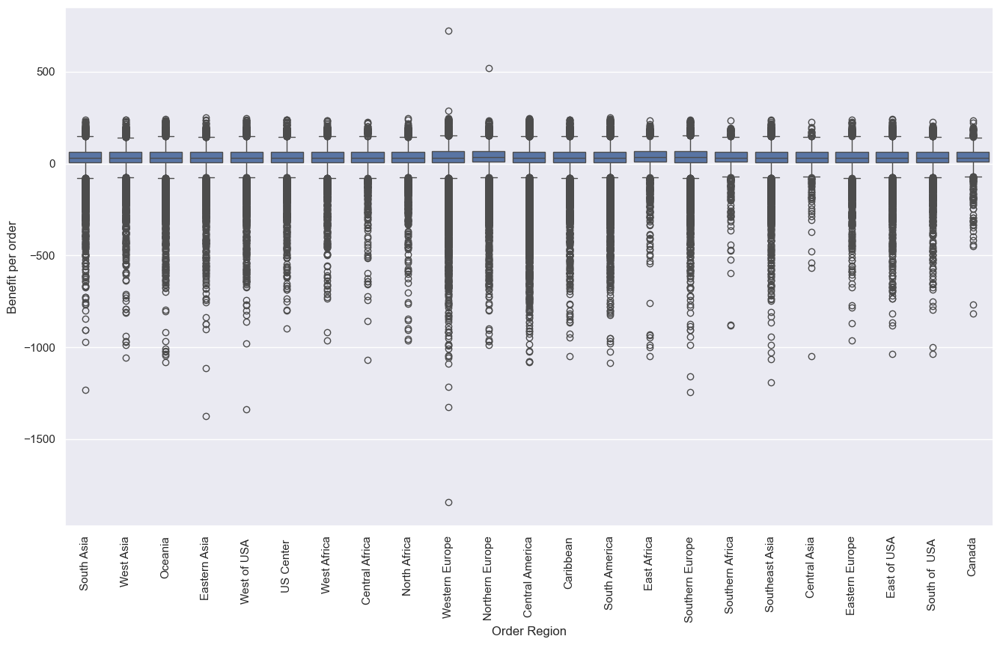

In [95]:
sns.set(rc = {'figure.figsize':(16,9)})
fig = sns.boxplot(x='Order Region', y='Benefit per order', data=df_filtrado)
plt.xticks(rotation=90);

### Segmentos de clientes mais lucrativos

In [96]:
# Agrupando por 'Category Name' e somando as vendas
Lucro_por_segmento = df_filtrado.groupby('Customer Segment')['Benefit per order'].sum().reset_index()

Lucro_por_segmento['Benefit per order'] = (Lucro_por_segmento['Benefit per order'] / 1000000).round(2)

Lucro_por_segmento.rename(columns={'Benefit per order': 'Lucro (em milhões)', 'Customer Segment': 'Segmento de Cliente'}, inplace=True)

# Ordenando os resultados
Lucro_por_segmento = Lucro_por_segmento.sort_values(by='Lucro (em milhões)', ascending=False).reset_index(drop=True)

Lucro_por_segmento

,Segmento de Cliente,Lucro (em milhões)
0,Consumer,1.83
1,Corporate,1.07
2,Home Office,0.63


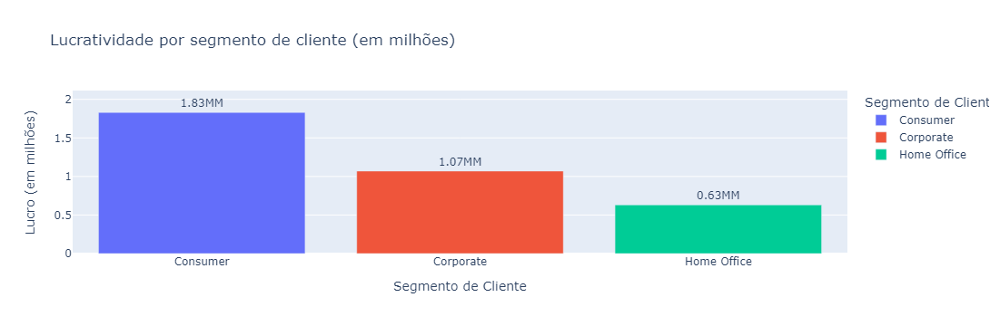

In [97]:
fig = px.bar(Lucro_por_segmento, x='Segmento de Cliente', y='Lucro (em milhões)', color = 'Segmento de Cliente',
             text = 'Lucro (em milhões)', title='Lucratividade por segmento de cliente (em milhões)',
             labels={'Order Region': 'Região'})

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.show()

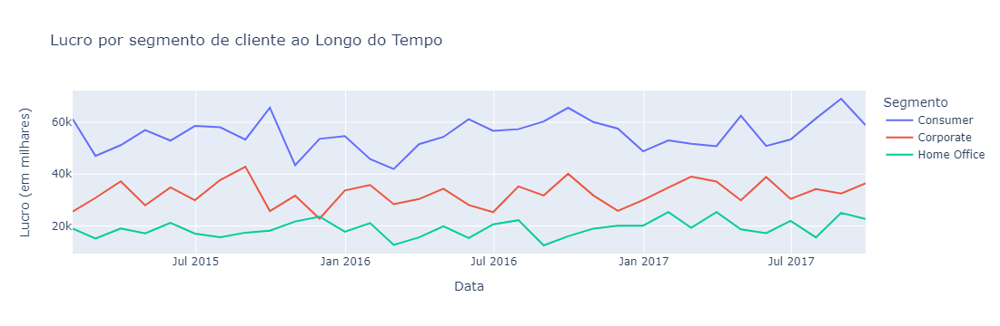

In [98]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Lucro_por_segmento_e_data = df_filtrado.groupby(['Customer Segment', pd.Grouper(key='order date (DateOrders)', freq='M')])['Benefit per order'].sum().reset_index()

Lucro_por_segmento_e_data.rename(columns={'Customer Segment':'Segmento', 'Benefit per order': 'Lucro (em milhares)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação dos lucros por segmento
Lucro_por_segmento_e_data['Variação de Lucro'] = Lucro_por_segmento_e_data.groupby('Segmento')['Lucro (em milhares)'].diff()

# Calculando a variação percentual dos lucros por segmento
Lucro_por_segmento_e_data['Variação Percentual'] = Lucro_por_segmento_e_data.groupby('Segmento')['Lucro (em milhares)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Lucro_por_segmento_e_data['Variação Percentual'] = (Lucro_por_segmento_e_data['Variação Percentual'] * 100).round(2)


# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_segmento_e_data, x='Data', y='Lucro (em milhares)', color='Segmento', title='Lucro por segmento de cliente ao Longo do Tempo')

# Mostrar o gráfic'
fig.show()

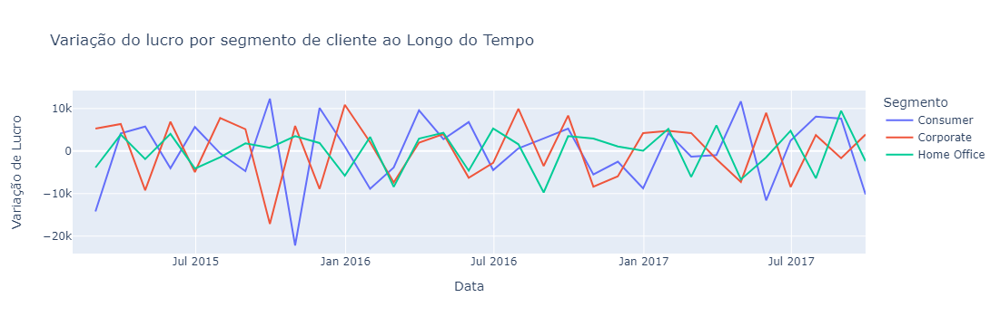

In [99]:
# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_segmento_e_data, x='Data', y='Variação de Lucro', color='Segmento', title='Variação do lucro por segmento de cliente ao Longo do Tempo')

# Mostrar o gráfic'
fig.show()

In [100]:
# Destacando os meses em que segmentos tiveram uma variação maior que 40% nos lucros da empresa
Lucro_por_segmento_e_data[abs(Lucro_por_segmento_e_data['Variação Percentual']) > 40.00]

,Segmento,Data,Lucro (em milhares),Variação de Lucro,Variação Percentual
44,Corporate,2015-12-31,33680.339986,10879.279855,47.71
85,Home Office,2016-08-31,12522.209888,-9716.130045,-43.69
97,Home Office,2017-08-31,25076.379961,9464.320037,60.62


Os lucros oscilaram durante todo o período.

### Destaque para os meses de variação positiva nos lucros:

* **Home Office - agosto/2017**: 60,62%  
* **Corporate - dezembro/2015**: 47,71%

### Destaque para os meses de variação negativa nos lucros:

* **Home Office - agosto/2016**: -43,69%  

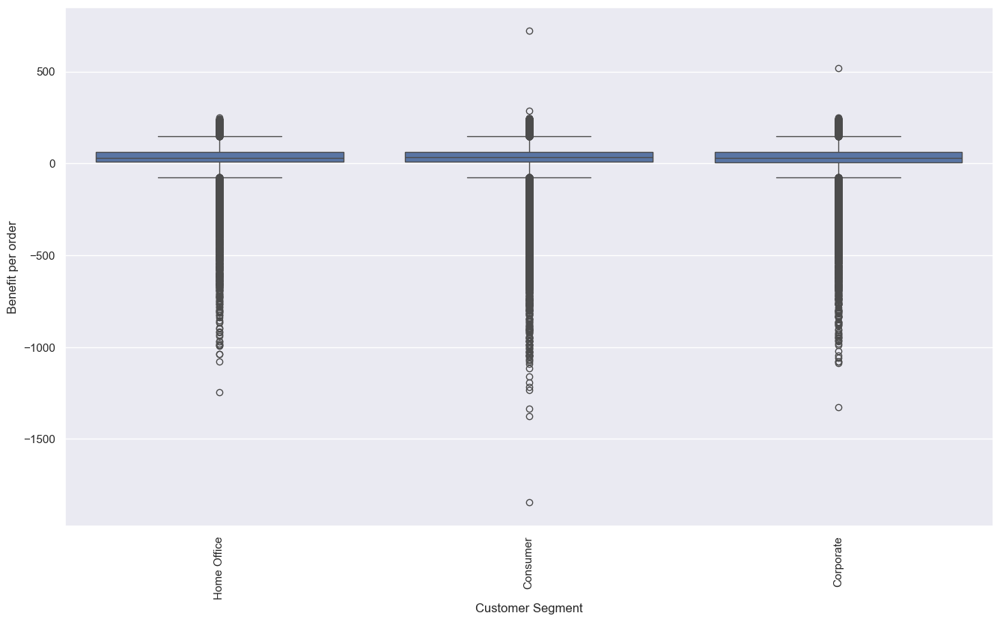

In [101]:
sns.set(rc = {'figure.figsize':(16,9)})
fig = sns.boxplot(x='Customer Segment', y='Benefit per order', data=df_filtrado)
plt.xticks(rotation=90);

### Departamentos mais lucrativos

In [89]:
# Agrupando por 'Category Name' e somando as vendas
Lucro_por_depart = df_filtrado.groupby('Department Name')['Benefit per order'].sum().reset_index()

Lucro_por_depart['Benefit per order'] = (Lucro_por_depart['Benefit per order'] / 1000000).round(2)

Lucro_por_depart.rename(columns={'Benefit per order': 'Lucro (em milhões)', 'Department Name': 'Departamento'}, inplace=True)

# Ordenando os resultados
Lucro_por_depart = Lucro_por_depart.sort_values(by='Lucro (em milhões)', ascending=False).reset_index(drop=True)

Lucro_por_depart

,Departamento,Lucro (em milhões)
0,Fan Shop,1.76
1,Apparel,0.77
2,Golf,0.48
3,Footwear,0.39
4,Outdoors,0.11
5,Fitness,0.03


In [90]:
fig = px.bar(Lucro_por_depart, x='Departamento', y='Lucro (em milhões)', color = 'Departamento',
             text = 'Lucro (em milhões)', title='Lucratividade por departamento (em milhões)')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.show()

In [91]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Lucro_por_depart_e_data = df_filtrado.groupby(['Department Name', pd.Grouper(key='order date (DateOrders)', freq='M')])['Benefit per order'].sum().reset_index()

Lucro_por_depart_e_data.rename(columns={'Department Name':'Departamento', 'Benefit per order': 'Lucro (em milhares)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação dos lucros por departamento
Lucro_por_depart_e_data['Variação de Lucro'] = Lucro_por_depart_e_data.groupby('Departamento')['Lucro (em milhares)'].diff()

# Calculando a variação percentual dos lucros por departamento
Lucro_por_depart_e_data['Variação Percentual'] = Lucro_por_depart_e_data.groupby('Departamento')['Lucro (em milhares)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Lucro_por_depart_e_data['Variação Percentual'] = (Lucro_por_depart_e_data['Variação Percentual'] * 100).round(2)

# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_depart_e_data, x='Data', y='Lucro (em milhares)', color='Departamento', title='Lucro por departamento ao longo do tempo (em milhares)')

# Mostrar o gráfico
fig.show()

In [92]:
# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_depart_e_data, x='Data', y='Variação de Lucro', color='Departamento', title='Variação do lucro por departamento ao longo do tempo')

# Mostrar o gráfico
fig.show()

In [93]:
# Destacando os meses em que departamentos tiveram uma variação maior que 300% nos lucros da empresa
Lucro_por_depart_e_data[abs(Lucro_por_depart_e_data['Variação Percentual']) > 300.00]

,Departamento,Data,Lucro (em milhares),Variação de Lucro,Variação Percentual
80,Fitness,2016-03-31,841.719984,649.819970,338.62
97,Fitness,2017-08-31,1718.959974,1320.789978,331.72
113,Footwear,2016-03-31,10955.529980,8773.049867,401.98


Os lucros oscilaram durante todo o período.

### Destaque para os meses de variação positiva nos lucros:

* **Footwear - março/2016**: 401,98%  
* **Fitness - março/2016**: 338,62%
* **Fitness - agosto/2017**: 331,72%

### Lucro por região do cliente

In [94]:
# Agrupando por 'Category Name' e somando as vendas
Lucro_por_regiao_do_cliente = df_filtrado.groupby('Customer Country')['Benefit per order'].sum().reset_index()

Lucro_por_regiao_do_cliente['Benefit per order'] = (Lucro_por_regiao_do_cliente['Benefit per order'] / 1000000).round(2)
Lucro_por_regiao_do_cliente.rename(columns={'Benefit per order': 'Lucro (em milhões)', 'Customer Country': 'País de origem do cliente'}, inplace=True)

# Ordenando os resultados
Lucro_por_regiao_do_cliente = Lucro_por_regiao_do_cliente.sort_values(by='Lucro (em milhões)', ascending=False).reset_index(drop=True)

Lucro_por_regiao_do_cliente

,País de origem do cliente,Lucro (em milhões)
0,EE. UU.,2.18
1,Puerto Rico,1.35


In [95]:
fig = px.bar(Lucro_por_regiao_do_cliente, x='País de origem do cliente', y='Lucro (em milhões)', color = 'País de origem do cliente',
             text = 'Lucro (em milhões)', title='Lucro por região de origem do cliente')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.show()

In [96]:
# Agora, agrupar os dados por categoria e data, somando o lucro
Lucro_por_regiao_do_cliente_e_data = df_filtrado.groupby(['Customer Country', pd.Grouper(key='order date (DateOrders)', freq='M')])['Benefit per order'].sum().reset_index()

Lucro_por_regiao_do_cliente_e_data['Benefit per order'] = (Lucro_por_regiao_do_cliente_e_data['Benefit per order'] / 1000).round(2)

Lucro_por_regiao_do_cliente_e_data.rename(columns={'Customer Country':'País de origem do cliente', 'Benefit per order': 'Lucro (em milhares)', 'order date (DateOrders)': 'Data'}, inplace=True)

# Calculando a variação dos lucros por região do cliente
Lucro_por_regiao_do_cliente_e_data['Variação de Lucro'] = Lucro_por_regiao_do_cliente_e_data.groupby('País de origem do cliente')['Lucro (em milhares)'].diff()

# Calculando a variação percentual dos lucros por região do cliente
Lucro_por_regiao_do_cliente_e_data['Variação Percentual'] = Lucro_por_regiao_do_cliente_e_data.groupby('País de origem do cliente')['Lucro (em milhares)'].pct_change()

# Convertendo a variação para porcentagem e arredondando
Lucro_por_regiao_do_cliente_e_data['Variação Percentual'] = (Lucro_por_regiao_do_cliente_e_data['Variação Percentual'] * 100).round(2)

# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_regiao_do_cliente_e_data, x='Data', y='Lucro (em milhares)', color='País de origem do cliente', title='Lucro por região do cliente - Ao Longo do Tempo')

# Mostrar o gráfico
fig.show()

In [97]:
# Criar o gráfico usando Plotly
fig = px.line(Lucro_por_regiao_do_cliente_e_data, x='Data', y='Variação de Lucro', color='País de origem do cliente', title='Variação do lucro por região do cliente - Ao Longo do Tempo')

# Mostrar o gráfico
fig.show()

In [98]:
# Destacando os meses em que departamentos tiveram uma variação maior que 30% nos lucros da empresa
Lucro_por_regiao_do_cliente_e_data[abs(Lucro_por_regiao_do_cliente_e_data['Variação Percentual']) > 30.00]

,País de origem do cliente,Data,Lucro (em milhares),Variação de Lucro,Variação Percentual
45,Puerto Rico,2016-01-31,30.64,-15.26,-33.25
47,Puerto Rico,2016-03-31,39.55,11.04,38.72


Os lucros oscilaram durante todo o período.

### Destaque para os meses de variação positiva nos lucros:

* **Puerto Rico - março/2016**: 38,72%  

### Destaque para os meses de variação negativa nos lucros:

* **Puerto Rico - janeiro/2016**: -33,25% 

<a id="analise_operacao_envio"></a>
<h1 style="color: green;">5. Análise de Operações de Envio</h1>

<a id="risco_atraso_entregas"></a>
## <b>5.1 Risco de atraso nas entregas</b>

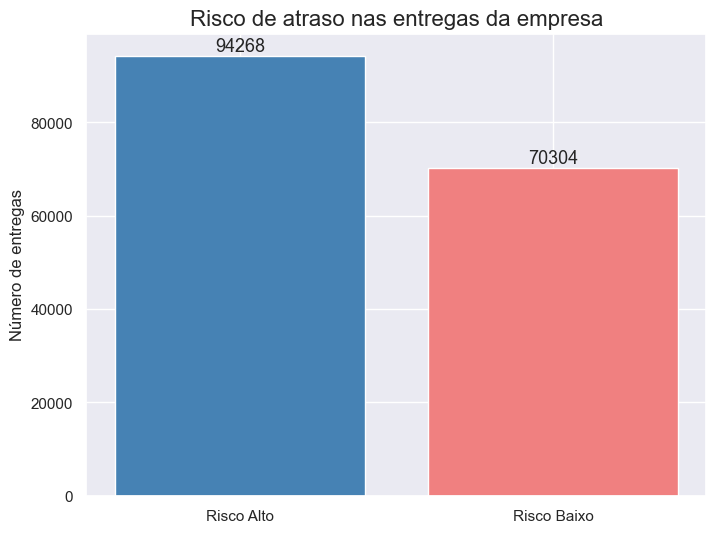

In [102]:
risco_entrega_atrasada = df_filtrado['Late_delivery_risk'].apply(lambda lat: 'Risco Alto' if lat == 1 else 'Risco Baixo')
risco_entrega_atrasada_count = risco_entrega_atrasada.value_counts()

# Tamanho do gráfico
plt.figure(figsize=(8,6))

# Cria um gráfico de barras com índice e contagem
barra = plt.bar(
    risco_entrega_atrasada_count.index, # valor no eixo x
    risco_entrega_atrasada_count.values, # valor no eixo y
    color = ['steelblue', 'lightcoral'] # cores das barras
)

# Rotulo do eixo y, letra tamanho 8
plt.ylabel('Número de entregas', fontsize = 12)

# Titulo, letra tamanho 14
plt.title('Risco de atraso nas entregas da empresa', fontsize = 16)

# Adicionando a contagem em cima das barras
for bar in barra:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2.0, yval, int(yval), va='bottom', ha='center', fontsize=13)

plt.show()

In [103]:
risco_entrega_atrasada.value_counts(1).round(4)

Late_delivery_risk
Risco Alto     0.5728
Risco Baixo    0.4272
Name: proportion, dtype: float64

Pela análise foi possível verificar que, no período entre janeiro/2015 à setembro/2017, **57.28% das entregas** realizadas pela empresa tiveram um **alto risco de atraso na entrega**.

### Risco de atraso por departamento

In [104]:
risco_atraso_depart = df_filtrado.groupby(['Department Name', 'Late_delivery_risk']).size().unstack(fill_value=0)

# Renomeando colunas 
risco_atraso_depart.rename(columns={'Department Name':'Departamento', 0: 'Risco Baixo', 1: 'Risco Alto'}, inplace=True)
risco_atraso_depart = risco_atraso_depart.reset_index()

# Removendo a coluna Late_delivery_risk
risco_atraso_depart.columns = ['Departamento', 'Risco Baixo', 'Risco Alto']

In [105]:
risco_atraso_depart

,Departamento,Risco Baixo,Risco Alto
0,Apparel,19122,25588
1,Fan Shop,27155,36291
2,Fitness,856,1174
3,Footwear,5923,7934
4,Golf,13553,18179
5,Outdoors,3695,5102


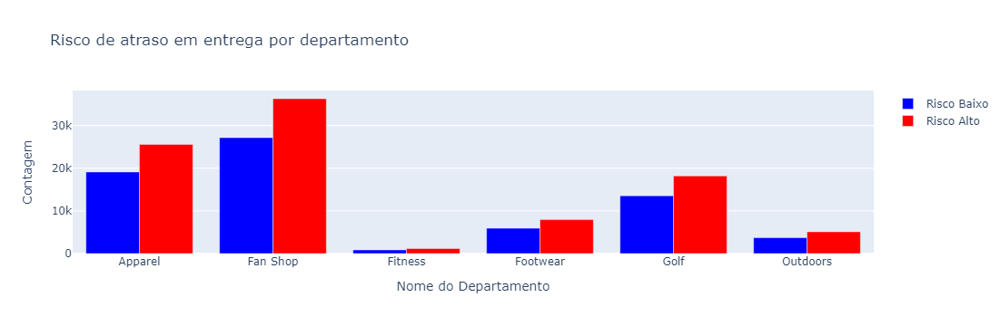

In [106]:
fig = go.Figure()

# Risco de entrega baixo (Late_delivery_risk = 0)
fig.add_trace(go.Bar(x=risco_atraso_depart['Departamento'], y=risco_atraso_depart['Risco Baixo'], name='Risco Baixo', marker_color='blue'))

# Risco de entrega alto (Late_delivery_risk = 1)
fig.add_trace(go.Bar(x=risco_atraso_depart['Departamento'], y=risco_atraso_depart['Risco Alto'], name='Risco Alto', marker_color='red'))

# Atualizando o layout do gráfico
fig.update_layout(title='Risco de atraso em entrega por departamento', xaxis=dict(title='Nome do Departamento'), 
                  yaxis=dict(title='Contagem'), barmode='group')

# Mostrando o gráfico
fig.show()

Pelo gráfico acima pode-se concluir que para **todos os departamentos** o risco da entregas atrasar **é majoritariamente alto**.

### Risco de atraso por mercado global

In [107]:
risco_atraso_mercado_global = df_filtrado.groupby(['Market', 'Late_delivery_risk']).size().unstack(fill_value=0)

# Renomeando colunas 
risco_atraso_mercado_global.rename(columns={0: 'Risco Baixo', 1: 'Risco Alto'}, inplace=True)
risco_atraso_mercado_global = risco_atraso_mercado_global.reset_index()

# Removendo a coluna Late_delivery_risk
risco_atraso_mercado_global.columns = ['Mercado Global', 'Risco Baixo', 'Risco Alto']

In [108]:
risco_atraso_mercado_global

,Mercado Global,Risco Baixo,Risco Alto
0,Africa,4814,6340
1,Europe,19124,26153
2,LATAM,21265,28044
3,Pacific Asia,14612,19593
4,USCA,10489,14138


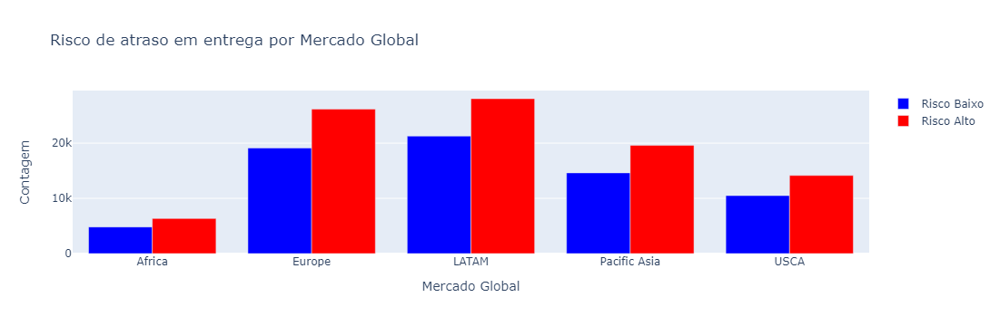

In [109]:
fig = go.Figure()

# Risco de entrega baixo (Late_delivery_risk = 0)
fig.add_trace(go.Bar(x=risco_atraso_mercado_global['Mercado Global'], y=risco_atraso_mercado_global['Risco Baixo'], name='Risco Baixo', marker_color='blue'))

# Risco de entrega alto (Late_delivery_risk = 1)
fig.add_trace(go.Bar(x=risco_atraso_mercado_global['Mercado Global'], y=risco_atraso_mercado_global['Risco Alto'], name='Risco Alto', marker_color='red'))

# Atualizando o layout do gráfico
fig.update_layout(title='Risco de atraso em entrega por Mercado Global', xaxis=dict(title='Mercado Global'), 
                  yaxis=dict(title='Contagem'), barmode='group')

# Mostrando o gráfico
fig.show()

Ou seja, em cada um dos mercados globais **a maioria dos pedidos tem um alto risco da entrega atrasar**.

### Proporção de risco de atraso alto por categoria

In [110]:
risco_atraso_cat = df_filtrado.groupby(['Category Name', 'Late_delivery_risk']).size().unstack(fill_value=0)

# Renomeando colunas 
risco_atraso_cat.rename(columns={0: 'Risco Baixo', 1: 'Risco Alto'}, inplace=True)
risco_atraso_cat = risco_atraso_cat.reset_index()

# Removendo a coluna Late_delivery_risk
risco_atraso_cat.columns = ['Category Name', 'Risco Baixo', 'Risco Alto']

# Criando uma coluna chamada 'Proporção de Alto Risco de Atraso'
risco_atraso_cat['Proporção de Alto Risco de Atraso'] = (risco_atraso_cat['Risco Alto']/(risco_atraso_cat['Risco Alto']+risco_atraso_cat['Risco Baixo'])).round(3)

# Ordenando o DataFrame pelo 'Proporção de Alto Risco de Atraso'
risco_atraso_cat.sort_values(by='Proporção de Alto Risco de Atraso', ascending=False, inplace=True)

risco_atraso_cat = risco_atraso_cat.reset_index(drop=True)

risco_atraso_cat

,Category Name,Risco Baixo,Risco Alto,Proporção de Alto Risco de Atraso
0,Golf Bags & Carts,19,42,0.689
1,Lacrosse,123,206,0.626
2,Strength Training,40,60,0.600
3,Accessories,683,1014,0.598
4,Fitness Accessories,118,175,0.597
5,Boxing & MMA,164,238,0.592
6,As Seen on TV!,27,39,0.591
7,Trade-In,384,542,0.585
8,Electronics,1254,1770,0.585
9,Golf Gloves,427,602,0.585


Pelo dataframe acima pode-se concluir que, com exceção de uma categoria (**Men's Golf Clubs**), em **todos as outras** os pedidos realizados têm alto risco de atraso na entrega em sua maioria.

<a id="entrega_real_vs_entrega_agendada"></a>
## <b>5.2 Entrega real VS Entrega agendada</b>

In [111]:
df_filtrado['Days for shipping (real)'].describe()

count    164572.000000
mean          3.498232
std           1.623669
min           0.000000
25%           2.000000
50%           3.000000
75%           5.000000
max           6.000000
Name: Days for shipping (real), dtype: float64

In [112]:
df_filtrado['Days for shipping (real)'].value_counts()

Days for shipping (real)
2    51648
3    26187
6    26186
4    25985
5    25715
0     4628
1     4223
Name: count, dtype: int64

In [113]:
df_filtrado['Days for shipment (scheduled)'].describe()

count    164572.000000
mean          2.933051
std           1.373475
min           0.000000
25%           2.000000
50%           4.000000
75%           4.000000
max           4.000000
Name: Days for shipment (scheduled), dtype: float64

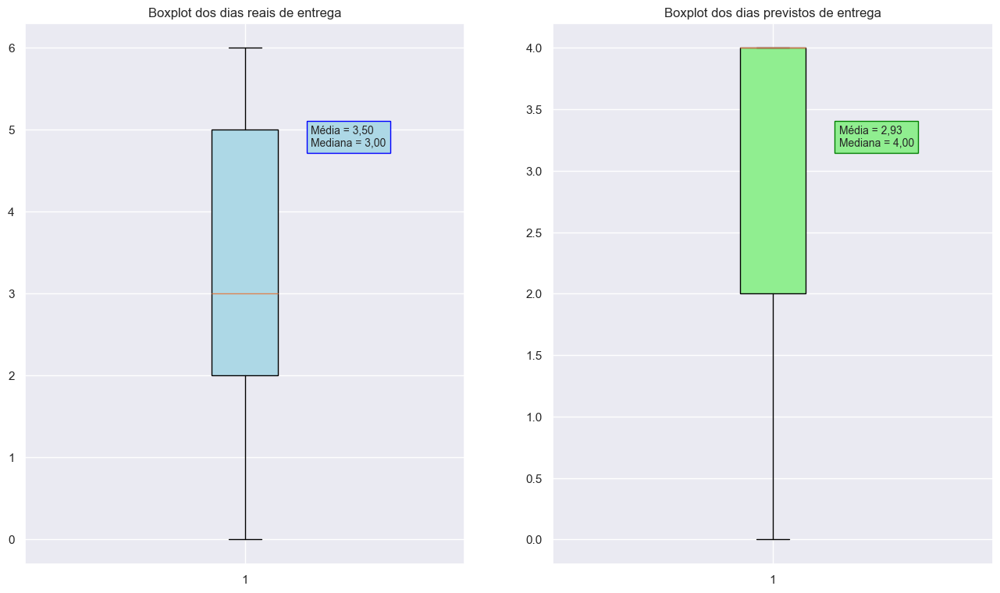

In [114]:
# Define a localidade para adicionar o separador de milhares
locale.setlocale(locale.LC_ALL, '')

# Cria uma figura com 2 subplots
fig, axs = plt.subplots(1, 2, figsize=(16, 9))

# Cria um boxplot para a variável 'entrega real' no primeiro subplot
bp1 = axs[0].boxplot(df_filtrado['Days for shipping (real)'], patch_artist=True)
axs[0].set_title('Boxplot dos dias reais de entrega')

# Calcula a média e mediana dias de entrega real
mean_entrega_real = np.mean(df_filtrado['Days for shipping (real)'])
median_entrega_real = np.median(df_filtrado['Days for shipping (real)'])

# Define a cor do boxplot
bp1['boxes'][0].set_facecolor('lightblue')

# Adiciona a legenda da média e mediana com separador de milhares
max_rent = np.max(df_filtrado['Days for shipping (real)'])
axs[0].annotate(f'Média = {locale.format_string("%.2f", mean_entrega_real, grouping=True)}\nMediana = {locale.format_string("%.2f", median_entrega_real, grouping=True)}', 
                xy=(1, max_rent*0.8), 
                xytext=(1.15, max_rent*0.8),
                bbox=dict(facecolor='lightblue', edgecolor='blue'),
                fontsize=10) 

# Cria um boxplot para a variável 'entrega agendada' no segundo subplot
bp2 = axs[1].boxplot(df_filtrado['Days for shipment (scheduled)'], patch_artist=True)
axs[1].set_title('Boxplot dos dias previstos de entrega')

# Calcula a média e mediana dos dias previstos para entrega
mean_entrega_agendada = np.mean(df_filtrado['Days for shipment (scheduled)'])
median_entrega_agendada = np.median(df_filtrado['Days for shipment (scheduled)'])

# Define a cor do boxplot
bp2['boxes'][0].set_facecolor('lightgreen')

# Adiciona a legenda da média e mediana com separador de milhares
max_total = np.max(df_filtrado['Days for shipment (scheduled)'])
axs[1].annotate(f'Média = {locale.format_string("%.2f", mean_entrega_agendada, grouping=True)}\nMediana = {locale.format_string("%.2f", median_entrega_agendada, grouping=True)}', 
                xy=(1, max_total*0.8), 
                xytext=(1.15, max_total*0.8),
                bbox=dict(facecolor='lightgreen', edgecolor='green'),
                fontsize=10)

# Mostra os gráficos
plt.show()

Pela análise dos boxplots:  
  
**Distribuição dos dias reais de entrega**  
  
* O conjunto de dados dos dias reais de entrega não possui outliers superiores ou inferiores
* O boxplot mostra que a mediana (Q2) está mais próxima de Q1 do que de Q3, mostrando que existe uma cauda mais longa com números maiores, possuindo mais registros com valores baixos do que altos, trata-se de uma distribuição assimétrica à direita. Isso indica que a maioria dos produtos demoram poucos dias para serem entregues (não significando que não estão em atraso).
  
  
**Distribuição dos dias previstos de entrega**  
  
* O conjunto de dados dos dias previstos de entrega não possui outliers superiores ou inferiores
* O boxplot mostra que a mediana (Q2) é exatamente igual ao Q3 e também ao valor máximo, indicando que na grande maioria dos casos a empresa acaba prevendo uma mesma quantidade de dias para a entrega de produtos. Isso ainda contribui para a formação de uma cauda mais longa com números menores, possuindo mais registros com valores altos do que baixos, caracterizando uma distribuição assimétrica à esquerda

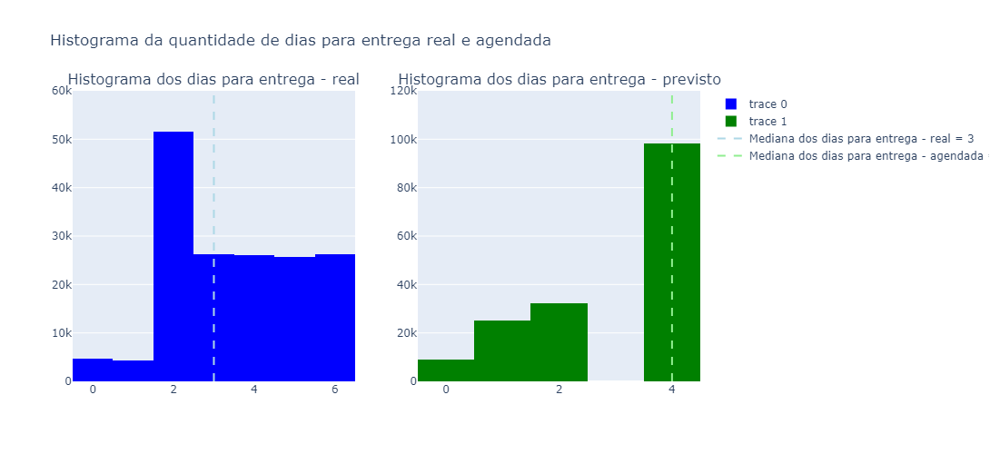

In [115]:
mediana_entrega_real = df_filtrado['Days for shipping (real)'].median()
mediana_entrega_agendada = df_filtrado['Days for shipment (scheduled)'].median()

mediana_entrega_real_format = (
    "{:,.0f}".format(mediana_entrega_real)
    .replace(",", ".")
)

mediana_entrega_agendada_format = (
    "{:,.0f}".format(mediana_entrega_agendada)
    .replace(",", ".")
)

# Crie dois subplots (um para o histograma de 'entrega real' e outro para o histograma de 'entrega agendada')
fig = make_subplots(rows=1, cols=2, subplot_titles=('Histograma dos dias para entrega - real', 'Histograma dos dias para entrega - previsto'))

# Adicione o histograma de 'entrega  real' ao primeiro subplot
histogram_entrega_real = go.Histogram(x=df_filtrado['Days for shipping (real)'], nbinsx=8, marker=dict(color='blue'))
fig.add_trace(histogram_entrega_real, row=1, col=1)

# Adicione o histograma de 'entrega agendada' ao segundo subplot
histogram_entrega_agendada = go.Histogram(x=df_filtrado['Days for shipment (scheduled)'], nbinsx=8, marker=dict(color='green'))
fig.add_trace(histogram_entrega_agendada, row=1, col=2)

# Adicione a linha da mediana a ambos os subplots
line_entrega_real = go.Scatter(x=[mediana_entrega_real, mediana_entrega_real], y=[0, 60000], mode='lines',
                              line=dict(color='lightblue', dash='dash'),
                              showlegend=True,
                              name=f"Mediana dos dias para entrega - real = {mediana_entrega_real_format}")
fig.add_trace(line_entrega_real, row=1, col=1)

line_entrega_agendada = go.Scatter(x=[mediana_entrega_agendada, mediana_entrega_agendada], y=[0, 120000], mode='lines',
                              line=dict(color='lightgreen', dash='dash'),
                              showlegend=True,
                              name=f"Mediana dos dias para entrega - agendada = {mediana_entrega_agendada_format}")
fig.add_trace(line_entrega_agendada, row=1, col=2)

# Atualize o layout e as configurações dos subplots
fig.update_layout(title_text='Histograma da quantidade de dias para entrega real e agendada',
                  autosize=False,
                  width=1200,  # Largura total dos subplots
                  height=500)

fig.update_yaxes(range=[0, 60000], row=1, col=1)
fig.update_yaxes(range=[0, 120000], row=1, col=2)

# Mostre o gráfico
fig.show()

Os histogramas indicados acima acabam comprovando o comportamento das distribuições verificado pelos boxplots anteriormente.

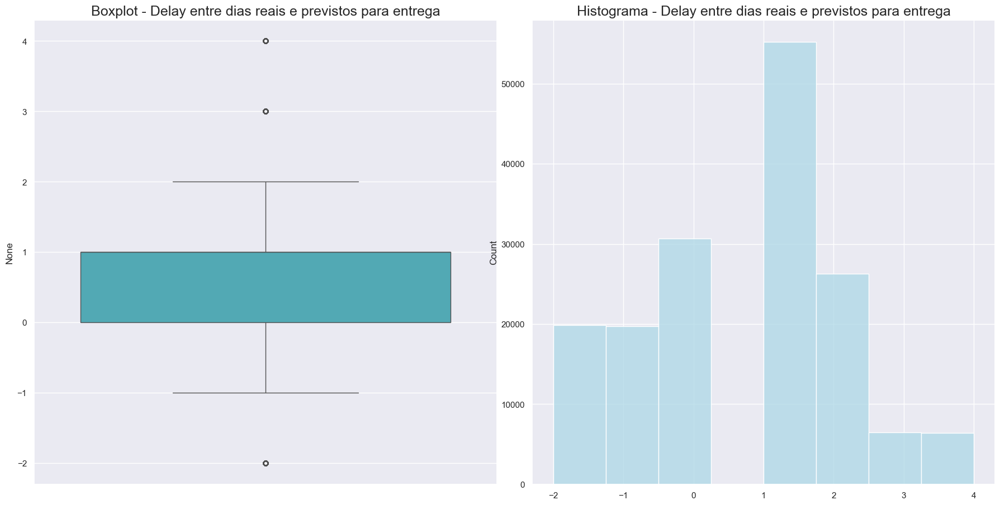

In [116]:
fig, axes = plt.subplots(1, 2, figsize = (18,9))
plt.tight_layout()

sns.boxplot(y=df_filtrado['Days for shipping (real)'] - df_filtrado['Days for shipment (scheduled)'],ax= axes[0], palette = 'YlGnBu_r', orient='v')
axes[0].set_title('Boxplot - Delay entre dias reais e previstos para entrega', fontsize=18)


sns.histplot(df_filtrado['Days for shipping (real)'] - df_filtrado['Days for shipment (scheduled)'], ax=axes[1], color='lightblue', bins=8)
axes[1].set_title('Histograma - Delay entre dias reais e previstos para entrega', fontsize=18)

plt.show()

In [117]:
delay = df_filtrado['Days for shipping (real)'] - df_filtrado['Days for shipment (scheduled)']
delay.describe()

count    164572.000000
mean          0.565181
std           1.492961
min          -2.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           4.000000
dtype: float64

O boxplot e o histograma indicam que 75% dos pedidos possuem até 1 dia de atraso, sendo 4 dias o máximo de atraso que um pedido teve e 2 dias o máximo de adiantamento na chegada.

In [118]:
print(f"A assimetria da distribuição do delay assume valor: {skew(delay):.2f}, ou seja, é levemente assimétrica à esquerda.")

A assimetria da distribuição do delay assume valor: 0.03, ou seja, é levemente assimétrica à esquerda.


In [119]:
delay.value_counts(1)

 1    0.335452
 0    0.186417
 2    0.159493
-2    0.120786
-1    0.119990
 3    0.039144
 4    0.038719
Name: proportion, dtype: float64

In [120]:
# Contando o número de pedidos com atraso de pelo menos 1 dia
delay_1_dia = (delay >= 1).sum()

# Calculando o número total de pedidos
total_de_pedidos = len(delay)

# Calculando a porcentagem de pedidos com atraso
porcentagem_com_atraso = (delay_1_dia / total_de_pedidos) * 100

# Exibindo o resultado
print(f"Porcentagem de pedidos com atraso de pelo menos 1 dia: {porcentagem_com_atraso:.2f}%")
print()
print(f"Porcentagem de pedidos com apenas 1 dia de atraso: {delay.value_counts(1)[1]:.2f}%")
print()
print(f"Porcentagem de pedidos com 2 dias de atraso: {delay.value_counts(1)[2]:.2f}%")
print()
print(f"Porcentagem de pedidos com 3 dias de atraso: {delay.value_counts(1)[3]:.2f}%")
print()
print(f"Porcentagem de pedidos com 4 dias de atraso: {delay.value_counts(1)[4]:.2f}%")

Porcentagem de pedidos com atraso de pelo menos 1 dia: 57.28%

Porcentagem de pedidos com apenas 1 dia de atraso: 0.34%

Porcentagem de pedidos com 2 dias de atraso: 0.16%

Porcentagem de pedidos com 3 dias de atraso: 0.04%

Porcentagem de pedidos com 4 dias de atraso: 0.04%


In [121]:
print(f"Porcentagem de pedidos com um dia adiantado: {delay.value_counts(1)[-1]:.2f}%")
print()
print(f"Porcentagem de pedidos com dois dias adiantado: {delay.value_counts(1)[-2]:.2f}%")

Porcentagem de pedidos com um dia adiantado: 0.12%

Porcentagem de pedidos com dois dias adiantado: 0.12%


In [122]:
print(f"Porcentagem de pedidos que chegou exatamente no dia previsto: {delay.value_counts(1)[0]:.2f}%")

Porcentagem de pedidos que chegou exatamente no dia previsto: 0.19%


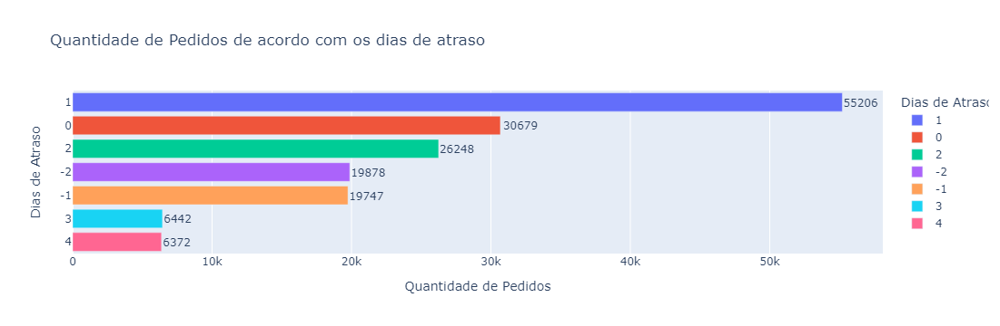

In [123]:
# Obter a contagem para cada status de entrega

delay = (df_filtrado['Days for shipping (real)'] - df_filtrado['Days for shipment (scheduled)']).value_counts()
delay_df = delay.reset_index()
delay_df.columns = ['Dias de Atraso', 'Quantidade de Pedidos']

# Convertendo 'Dias de Atraso' para string para obter cores distintas
delay_df['Dias de Atraso'] = delay_df['Dias de Atraso'].astype(str)


fig = px.bar(delay_df, y='Dias de Atraso', x='Quantidade de Pedidos', color='Dias de Atraso',
                 title="Quantidade de Pedidos de acordo com os dias de atraso", text = 'Quantidade de Pedidos')

fig.update_traces(textposition='outside', texttemplate='%{text}', textfont_size=12)
fig.show()

<a id="analise_status_entrega"></a>
## <b>5.3 Análise dos status de entrega</b>

In [121]:
# Obter a contagem para cada status de entrega

status_entrega = df_filtrado['Delivery Status'].value_counts()
status_entrega_df = status_entrega.reset_index()
status_entrega_df.columns = ['Status de Entrega', 'Quantidade de Pedidos']


fig = px.bar(status_entrega_df, x='Status de Entrega', y='Quantidade de Pedidos', color='Status de Entrega',
                 title="Quantidade de Pedidos por Status de Entrega", text = 'Quantidade de Pedidos')

fig.update_traces(textposition='outside', texttemplate='%{text}', textfont_size=12)
fig.show()

In [122]:
status_entrega_tempo = df_filtrado.groupby([df['order date (DateOrders)'].dt.to_period('M'), 'Delivery Status']).size()

status_entrega_tempo = status_entrega_tempo.unstack(fill_value=0)
status_entrega_tempo.index = status_entrega_tempo.index.to_timestamp()

fig = px.line(status_entrega_tempo, title='Status de Entrega ao Longo do Tempo',
                   labels={'value': 'Quantidade de Pedidos', 'order date (DateOrders)': 'Data', 'Delivery Status': 'Status de Entrega'})
fig.show()

In [123]:
atraso_cat = df_filtrado.groupby(['Category Name', 'Delivery Status']).size().unstack(fill_value=0)
atraso_cat = atraso_cat.reset_index()

# Removendo a coluna Delivery Status
#atraso_cat.columns = ['Category Name', 'Advance shipping', 'Late delivery', 'Shipping canceled', 'Shipping on time']
atraso_cat.columns = ['Category Name', 'Advance shipping', 'Late delivery', 'Shipping on time']


# Criando uma coluna chamada 'Proporção de entregas em atraso'
atraso_cat['Proporção de entregas em atraso'] = (atraso_cat['Late delivery']/(atraso_cat['Late delivery']+atraso_cat['Advance shipping']+atraso_cat['Shipping on time'])).round(3)

# Ordenando o DataFrame pelo 'Proporção de entregas em atraso'
atraso_cat.sort_values(by='Proporção de entregas em atraso', ascending=False, inplace=True)

atraso_cat = atraso_cat.reset_index(drop=True)

atraso_cat

,Category Name,Advance shipping,Late delivery,Shipping on time,Proporção de entregas em atraso
0,Golf Bags & Carts,12,42,7,0.689
1,Lacrosse,75,206,48,0.626
2,Strength Training,20,60,20,0.600
3,Accessories,406,1014,277,0.598
4,Fitness Accessories,69,175,49,0.597
5,Boxing & MMA,84,238,80,0.592
6,As Seen on TV!,15,39,12,0.591
7,Trade-In,232,542,152,0.585
8,Electronics,733,1770,521,0.585
9,Golf Gloves,240,602,187,0.585


Pelo dataframe acima pode-se concluir que, com exceção de uma categoria (**Men's Golf Clubs**), em **todos as outras** a entregas em atraso **superam** a soma das entregas no prazo, canceladas e antes do prazo.

<a id="analise_status_pedido"></a>
## <b>5.4 Análise dos status de pedido</b>

In [124]:
# Obter a contagem para cada status de entrega

status_pedido = df_filtrado['Order Status'].value_counts()
status_pedido_df = status_pedido.reset_index()
status_pedido_df.columns = ['Status de Pedido', 'Quantidade de Pedidos']


fig = px.bar(status_pedido_df, x='Status de Pedido', y='Quantidade de Pedidos', color='Status de Pedido',
                 title="Quantidade de pedidos por status de pedido", text = 'Quantidade de Pedidos')

fig.update_traces(textposition='outside', texttemplate='%{text}', textfont_size=12)
fig.show()

In [125]:
status_pedido_tempo = df_filtrado.groupby([df['order date (DateOrders)'].dt.to_period('M'), 'Order Status']).size()

status_pedido_tempo = status_pedido_tempo.unstack(fill_value=0)
status_pedido_tempo.index = status_pedido_tempo.index.to_timestamp()

fig = px.line(status_pedido_tempo, title='Status de Pedido ao Longo do Tempo',
                   labels={'value': 'Quantidade de Pedidos', 'order date (DateOrders)': 'Data', 'Order Status': 'Status de Pedido'})
fig.show()

<a id="pedidos_entrega_cancelada"></a>
## <b>5.5 Análise de pedidos com entrega cancelada</b>

In [124]:
entrega_cancelada_df = df[df['Delivery Status']=='Shipping canceled']
entrega_cancelada_df = entrega_cancelada_df['Order Status'].value_counts()

entrega_cancelada_df = entrega_cancelada_df.reset_index()
entrega_cancelada_df.columns = ['Motivo do Cancelamento', 'Quantidade de Pedidos']

entrega_cancelada_df['Motivo do Cancelamento'] = entrega_cancelada_df['Motivo do Cancelamento'].replace({'SUSPECTED_FRAUD': 'POSSIVEL FRAUDE', 'CANCELED': 'CANCELADO PELO USUARIO'})
entrega_cancelada_df

,Motivo do Cancelamento,Quantidade de Pedidos
0,POSSIVEL FRAUDE,3877
1,CANCELADO PELO USUARIO,3513


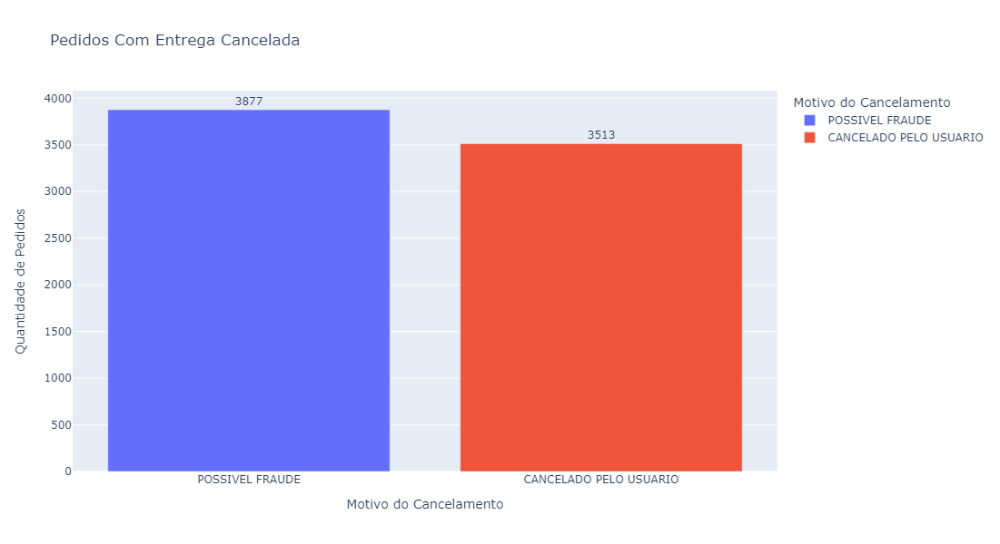

In [134]:
fig = px.bar(entrega_cancelada_df, x='Motivo do Cancelamento', y='Quantidade de Pedidos', color='Motivo do Cancelamento',
                 title="Pedidos Com Entrega Cancelada", text = 'Quantidade de Pedidos')

fig.update_traces(textposition='outside', texttemplate='%{text}', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

Percebe-se que, dos pedidos que tiveram entrega cancelada, ou foram cancelados pelo próprio cliente ou por suspeita de fraude a própria empresa cancelou.

In [126]:
operacoes_fraude = df[df['Order Status']=='SUSPECTED_FRAUD']
operacoes_fraude.head()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Email,Customer Fname,Customer Id,Customer Lname,Customer Password,Customer Segment,Customer State,Customer Street,Customer Zipcode,Department Id,Department Name,Latitude,Longitude,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode
183,TRANSFER,5,4,28.850000,128.220001,Shipping canceled,0,13,Electronics,Freeport,EE. UU.,XXXXXXXXX,Patricia,1509,Petersen,XXXXXXXXX,Consumer,NY,3675 Emerald Goose Bank,11520.0,3,Footwear,40.654865,-73.587074,USCA,Houston,Estados Unidos,1509,2016-05-08 17:42:00,33824,278,6.75,0.05,84424,44.990002,0.23,3,134.970001,128.220001,28.850000,US Center,Texas,SUSPECTED_FRAUD,77041.0,278,13,NaN,http://images.acmesports.sports/Under+Armour+Men%27s+Compression+EV+SL+Slide,Under Armour Men's Compression EV SL Slide,44.990002,0,5/13/2016 17:42,Standard Class
184,TRANSFER,5,4,133.910004,278.970001,Shipping canceled,0,9,Cardio Equipment,Fort Washington,EE. UU.,XXXXXXXXX,Julie,1636,Petersen,XXXXXXXXX,Consumer,MD,9375 Harvest Circuit,20744.0,3,Footwear,38.742664,-76.991798,USCA,Gilbert,Estados Unidos,1636,2016-04-02 19:51:00,31364,191,21.00,0.07,78398,99.989998,0.48,3,299.970001,278.970001,133.910004,West of USA,Arizona,SUSPECTED_FRAUD,85234.0,191,9,NaN,http://images.acmesports.sports/Nike+Men%27s+Free+5.0%2B+Running+Shoe,Nike Men's Free 5.0+ Running Shoe,99.989998,0,4/7/2016 19:51,Standard Class
185,TRANSFER,6,4,79.160004,272.970001,Shipping canceled,0,9,Cardio Equipment,Bakersfield,EE. UU.,XXXXXXXXX,Lisa,2784,Smith,XXXXXXXXX,Consumer,CA,3993 Thunder Hills Port,93304.0,3,Footwear,35.362545,-119.018700,USCA,San Jose,Estados Unidos,2784,2016-08-14 02:51:00,40495,191,27.00,0.09,101052,99.989998,0.29,3,299.970001,272.970001,79.160004,West of USA,California,SUSPECTED_FRAUD,95123.0,191,9,NaN,http://images.acmesports.sports/Nike+Men%27s+Free+5.0%2B+Running+Shoe,Nike Men's Free 5.0+ Running Shoe,99.989998,0,8/20/2016 2:51,Standard Class
186,TRANSFER,5,4,19.110001,272.970001,Shipping canceled,0,9,Cardio Equipment,Fort Washington,EE. UU.,XXXXXXXXX,Julie,1636,Petersen,XXXXXXXXX,Consumer,MD,9375 Harvest Circuit,20744.0,3,Footwear,38.742664,-76.991798,USCA,Gilbert,Estados Unidos,1636,2016-04-02 19:51:00,31364,191,27.00,0.09,78396,99.989998,0.07,3,299.970001,272.970001,19.110001,West of USA,Arizona,SUSPECTED_FRAUD,85234.0,191,9,NaN,http://images.acmesports.sports/Nike+Men%27s+Free+5.0%2B+Running+Shoe,Nike Men's Free 5.0+ Running Shoe,99.989998,0,4/7/2016 19:51,Standard Class
187,TRANSFER,2,4,10.770000,170.970001,Shipping canceled,0,17,Cleats,Corona,EE. UU.,XXXXXXXXX,Tyler,9174,Smith,XXXXXXXXX,Consumer,NY,9414 Thunder Island Court,11368.0,4,Apparel,40.742107,-73.869621,USCA,Fresno,Estados Unidos,9174,2016-05-18 16:38:00,34506,365,9.00,0.05,86191,59.990002,0.06,3,179.970001,170.970001,10.770000,West of USA,California,SUSPECTED_FRAUD,93727.0,365,17,NaN,http://images.acmesports.sports/Perfect+Fitness+Perfect+Rip+Deck,Perfect Fitness Perfect Rip Deck,59.990002,0,5/20/2016 16:38,Standard Class


<a id="analise_fraude"></a>
## <b>5.6 Análise de fraudes em operações</b>

#### Fraudes em produtos

In [127]:
fraude_prod = operacoes_fraude.groupby('Product Name').size().reset_index(name='Compras Fraudulentas')
fraude_prod.sort_values(by='Compras Fraudulentas', ascending=False, inplace=True)

# Renomeando colunas 
fraude_prod.rename(columns={'Product Name': 'Nome do Produto'}, inplace=True)

fraude_prod

,Nome do Produto,Compras Fraudulentas
51,Perfect Fitness Perfect Rip Deck,560
39,Nike Men's CJ Elite 2 TD Football Cleat,516
42,Nike Men's Dri-FIT Victory Golf Polo,481
49,O'Brien Men's Neoprene Life Vest,439
16,Field & Stream Sportsman 16 Gun Fire Safe,393
...,...,...
19,Garmin Forerunner 910XT GPS Watch,1
15,Elevation Training Mask 2.0,1
11,Diamondback Boys' Insight 24 Performance Hybr,1
5,Brooks Women's Ghost 6 Running Shoe,1


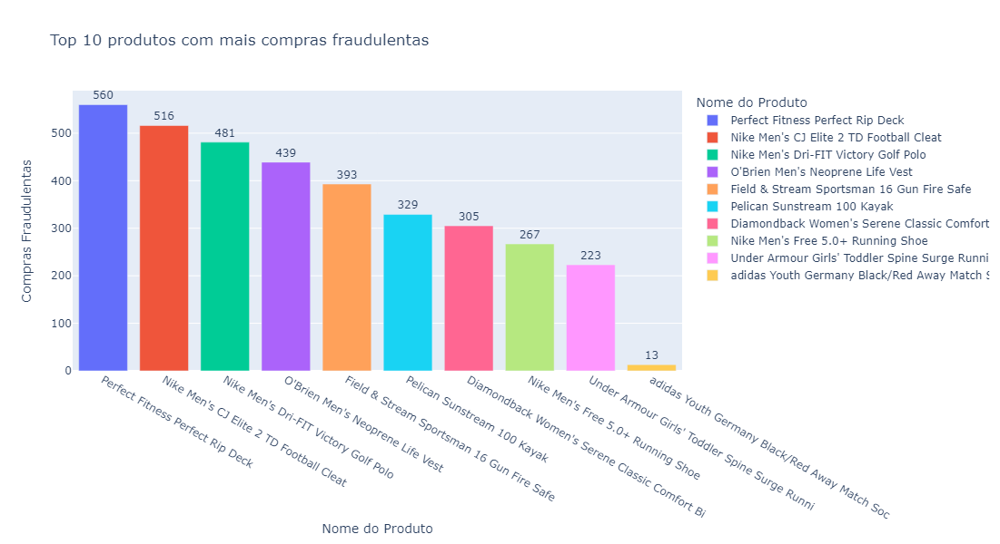

In [129]:
fig = px.bar(fraude_prod.head(10), x='Nome do Produto', y='Compras Fraudulentas', color='Nome do Produto',
                 title="Top 10 produtos com mais compras fraudulentas", text = 'Compras Fraudulentas')

fig.update_traces(textposition='outside', texttemplate='%{text}', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

#### Fraudes em categorias

In [130]:
fraude_cat = operacoes_fraude.groupby('Category Name').size().reset_index(name='Compras Fraudulentas')
fraude_cat.sort_values(by='Compras Fraudulentas', ascending=False, inplace=True)

# Renomeando colunas 
fraude_cat.rename(columns={'Category Name': 'Nome da Categoria'}, inplace=True)

fraude_cat

,Nome da Categoria,Compras Fraudulentas
6,Cleats,560
20,Men's Footwear,516
28,Women's Apparel,481
17,Indoor/Outdoor Games,439
8,Fishing,393
27,Water Sports,329
4,Camping & Hiking,305
5,Cardio Equipment,276
22,Shop By Sport,228
7,Electronics,77


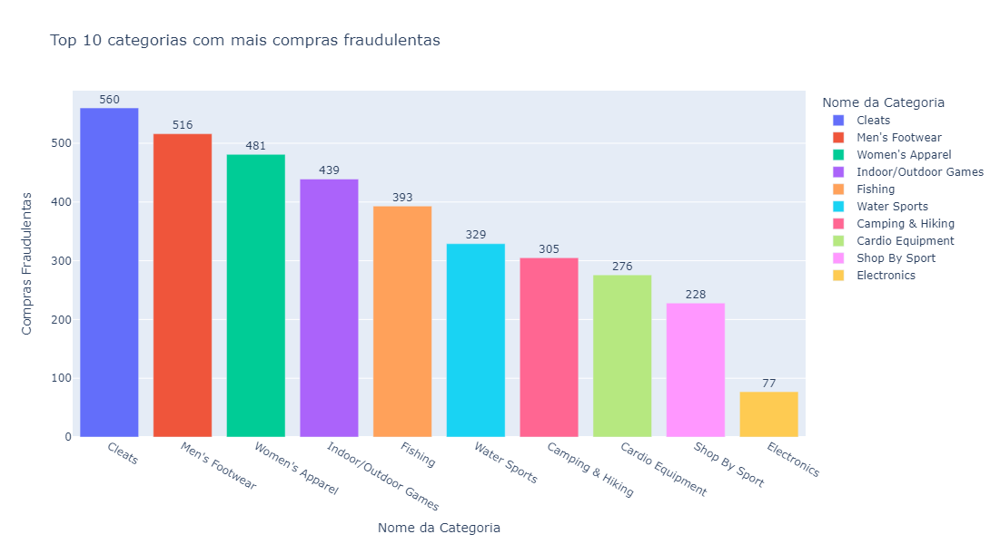

In [132]:
fig = px.bar(fraude_cat.head(10), x='Nome da Categoria', y='Compras Fraudulentas', color='Nome da Categoria',
                 title="Top 10 categorias com mais compras fraudulentas", text = 'Compras Fraudulentas')

fig.update_traces(textposition='outside', texttemplate='%{text}', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

#### Fraudes em departamentos

In [133]:
fraude_dep = operacoes_fraude.groupby('Department Name').size().reset_index(name='Compras Fraudulentas')
fraude_dep.sort_values(by='Compras Fraudulentas', ascending=False, inplace=True)

# Renomeando colunas 
fraude_dep.rename(columns={'Department Name': 'Departamento'}, inplace=True)

fraude_dep

,Departamento,Compras Fraudulentas
1,Fan Shop,1475
0,Apparel,1076
4,Golf,744
3,Footwear,328
5,Outdoors,212
2,Fitness,42


In [134]:
fig = px.bar(fraude_dep.head(10), x='Departamento', y='Compras Fraudulentas', color='Departamento',
                 title="Compras fraudulentas por departamento", text = 'Compras Fraudulentas')

fig.update_traces(textposition='outside', texttemplate='%{text}', textfont_size=12)
fig.show()

<a id="analise_modos_entrega"></a>
## <b>5.7 Análise dos modos de entrega</b>

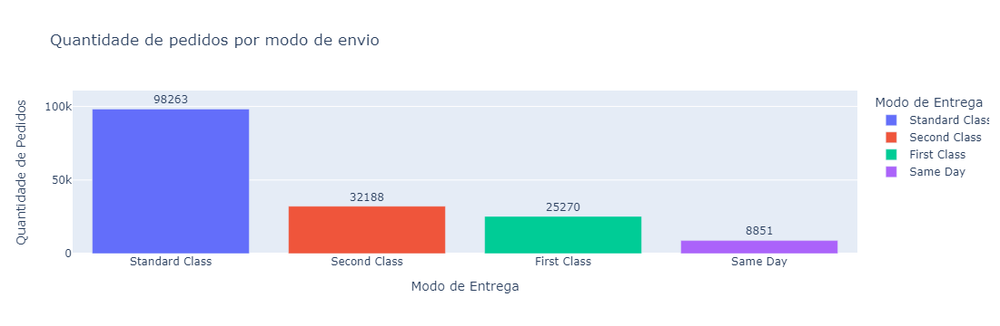

In [135]:
# Obter a contagem para cada status de entrega

modos_entrega = df_filtrado['Shipping Mode'].value_counts()
modos_entrega_df = modos_entrega.reset_index()
modos_entrega_df.columns = ['Modo de Entrega', 'Quantidade de Pedidos']


fig = px.bar(modos_entrega_df, x='Modo de Entrega', y='Quantidade de Pedidos', color='Modo de Entrega',
                 title="Quantidade de pedidos por modo de envio", text = 'Quantidade de Pedidos')

fig.update_traces(textposition='outside', texttemplate='%{text}', textfont_size=12)
fig.show()

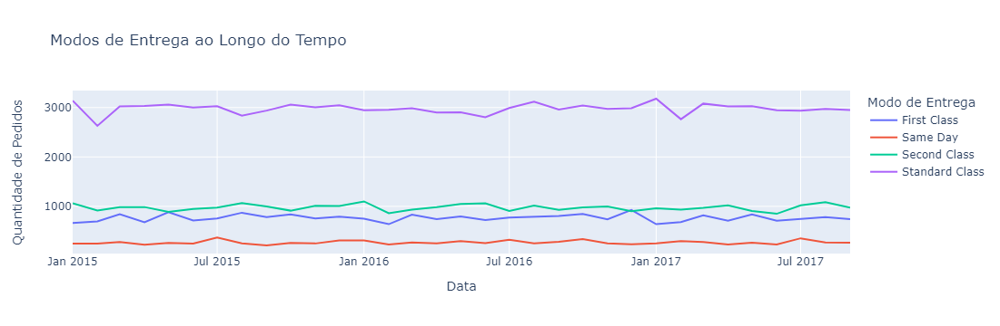

In [140]:
modos_entrega_tempo = df_filtrado.groupby([df['order date (DateOrders)'].dt.to_period('M'), 'Shipping Mode']).size()

modos_entrega_tempo = modos_entrega_tempo.unstack(fill_value=0)
modos_entrega_tempo.index = modos_entrega_tempo.index.to_timestamp()

fig = px.line(modos_entrega_tempo, title='Modos de Entrega ao Longo do Tempo',
                   labels={'value': 'Quantidade de Pedidos', 'order date (DateOrders)': 'Data', 'Shipping Mode': 'Modo de Entrega'})
fig.show()

In [141]:
# Criando a coluna que mostra se a entrega foi atrasada (1) ou não (0)
df_filtrado['Atraso'] = (df_filtrado['Days for shipping (real)'] > df_filtrado['Days for shipment (scheduled)']).astype(int)

# Agrupando por 'shipping mode' e contando atrasos
atraso_por_modo_de_entrega = df_filtrado.groupby('Shipping Mode')['Atraso'].value_counts().unstack(fill_value=0)

# Calculando a porcentagem de atrasos
atraso_por_modo_de_entrega['Entregas Totais'] = atraso_por_modo_de_entrega.sum(axis=1)
atraso_por_modo_de_entrega['Porcentagem de Atraso'] = ((atraso_por_modo_de_entrega[1] / atraso_por_modo_de_entrega['Entregas Totais']) * 100).round(2)

# Criando o dataframe final
final_df = atraso_por_modo_de_entrega.rename(columns={1: 'Entregas Atrasadas', 0: 'Entregas à Tempo'})
final_df = final_df[['Entregas Totais', 'Entregas Atrasadas', 'Porcentagem de Atraso']].reset_index()

#final_df = final_df.set_index('Atraso')
#final_df.reset_index(drop=True, inplace=True)


In [142]:
final_df

Atraso,Shipping Mode,Entregas Totais,Entregas Atrasadas,Porcentagem de Atraso
0,First Class,25270,25270,100.00
1,Same Day,8851,4223,47.71
2,Second Class,32188,25688,79.81
3,Standard Class,98263,39087,39.78


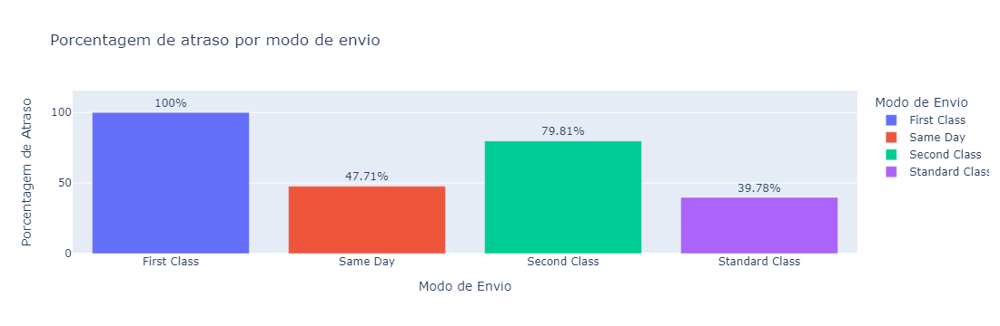

In [143]:
fig = px.bar(final_df, x='Shipping Mode', y='Porcentagem de Atraso', color='Shipping Mode',
                 title="Porcentagem de atraso por modo de envio", text = 'Porcentagem de Atraso',
            labels={'Shipping Mode': 'Modo de Envio'})

fig.update_traces(textposition='outside', texttemplate='%{text}%', textfont_size=12)
fig.show()

Pelo gráfico acima, percebe-se que ocorreram com atraso:

* Todas **(100%)** as entregas do modo **First Class**.
* Quase metade **(47,71%)** das entregas do modo **Same Day**.
* Praticamente 80% **(79,81%)** das entregas do modo **Second Class**.
* Quase 40% **(39,78%)** das entregas do modo **Standard Class**.

<a id="analise_tipos_pagamento"></a>
<h1 style="color: green;">6. Análise dos tipos de pagamento</h1>

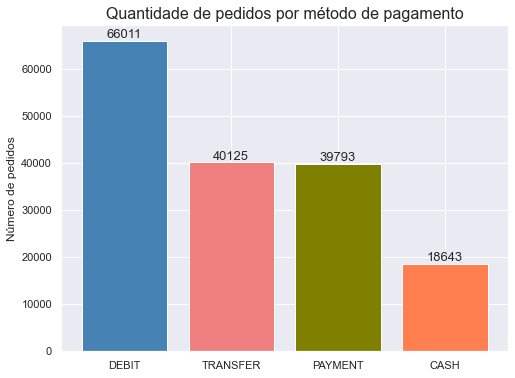

In [140]:
tipo_pagamento = df_filtrado['Type'].value_counts()

# Tamanho do gráfico
plt.figure(figsize=(8,6))

# Cria um gráfico de barras com índice e contagem
barra = plt.bar(
    tipo_pagamento.index, # valor no eixo x
    tipo_pagamento.values, # valor no eixo y
    color = ['steelblue', 'lightcoral', 'olive','#ff7f50'] # cores das barras
)

# Rotulo do eixo y, letra tamanho 8
plt.ylabel('Número de pedidos', fontsize = 12)

# Titulo, letra tamanho 14
plt.title('Quantidade de pedidos por método de pagamento', fontsize = 16)

# Adicionando a contagem em cima das barras
for bar in barra:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2.0, yval, int(yval), va='bottom', ha='center', fontsize=13)

plt.show()

In [141]:
# Porcentagem de pedidos pagos para cada modo de pagamento
df_filtrado['Type'].value_counts(1)

DEBIT       0.401107
TRANSFER    0.243814
PAYMENT     0.241797
CASH        0.113282
Name: Type, dtype: float64

In [142]:
tipo_pagamento_mensal = df_filtrado.groupby([df['order date (DateOrders)'].dt.to_period('M'), 'Type']).size()

tipo_pagamento_mensal = tipo_pagamento_mensal.unstack(fill_value=0)
tipo_pagamento_mensal.index = tipo_pagamento_mensal.index.to_timestamp()

fig = px.line(tipo_pagamento_mensal, title='Tipos de pagamento ao longo do tempo',
                   labels={'value': 'Quantidade de Pedidos', 'order date (DateOrders)': 'Data', 'Type': 'Tipo de Pagamento'})
fig.show()

<a id="analise_precos_e_descontos"></a>
<h1 style="color: green;">6. Análise dos preços e descontos</h1>

In [143]:
mediana_precos = df_filtrado['Order Item Product Price'].median()
mediana_descontos = df_filtrado['Order Item Discount'].median()

mediana_precos_format = (
    "{:,.0f}".format(mediana_precos)
    .replace(",", ".")
)

mediana_descontos_format = (
    "{:,.0f}".format(mediana_descontos)
    .replace(",", ".")
)

# Crie dois subplots (um para o histograma de 'preços' e outro para o histograma de 'descontos')
fig = make_subplots(rows=1, cols=2, subplot_titles=('Histograma dos preços', 'Histograma dos descontos'))

# Adicione o histograma de 'preços' ao primeiro subplot
histogram_preços = go.Histogram(x=df_filtrado['Order Item Product Price'], nbinsx=10, marker=dict(color='blue'))
fig.add_trace(histogram_preços, row=1, col=1)

# Adicione o histograma de 'descontos' ao segundo subplot
histogram_descontos = go.Histogram(x=df_filtrado['Order Item Discount'], nbinsx=12, marker=dict(color='green'))
fig.add_trace(histogram_descontos, row=1, col=2)

# Adicione a linha da mediana a ambos os subplots
line_precos = go.Scatter(x=[mediana_precos, mediana_precos], y=[0, 144844], mode='lines',
                              line=dict(color='lightblue', dash='dash'),
                              showlegend=True,
                              name=f"Mediana dos preços = {mediana_precos_format}")
fig.add_trace(line_precos, row=1, col=1)

line_descontos = go.Scatter(x=[mediana_descontos, mediana_descontos], y=[0, 125593], mode='lines',
                              line=dict(color='lightgreen', dash='dash'),
                              showlegend=True,
                              name=f"Mediana dos descontos = {mediana_descontos_format}")
fig.add_trace(line_descontos, row=1, col=2)

# Atualize o layout e as configurações dos subplots
fig.update_layout(title_text='Histograma dos preços e descontos dos produtos',
                  autosize=False,
                  width=1200,  # Largura total dos subplots
                  height=500)

fig.update_yaxes(range=[0, 150000], row=1, col=1)
fig.update_yaxes(range=[0, 150000], row=1, col=2)

# Mostre o gráfico
fig.show()

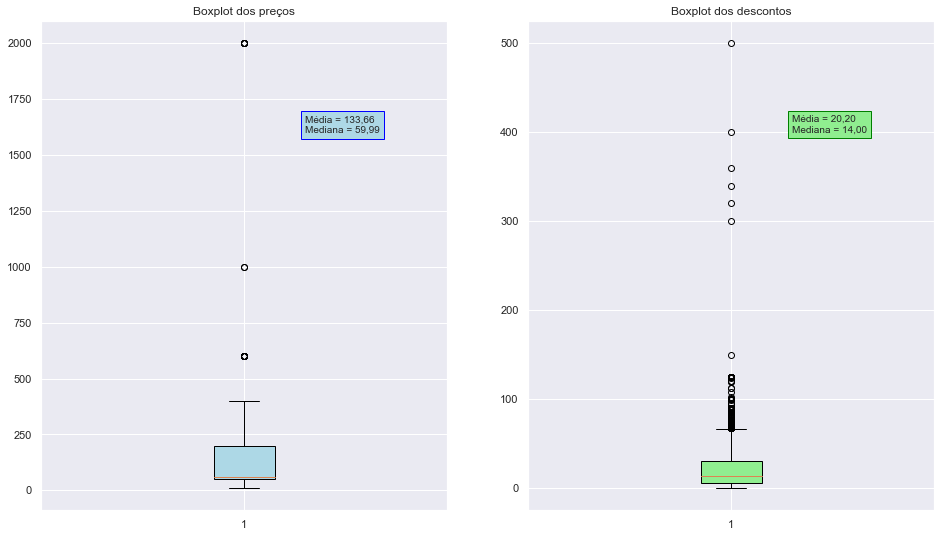

In [144]:
# Define a localidade para adicionar o separador de milhares
locale.setlocale(locale.LC_ALL, '')

# Cria uma figura com 2 subplots
fig, axs = plt.subplots(1, 2, figsize=(16, 9))

# Cria um boxplot para a variável 'preço' no primeiro subplot
bp1 = axs[0].boxplot(df_filtrado['Order Item Product Price'], patch_artist=True)
axs[0].set_title('Boxplot dos preços')

# Calcula a média e mediana do preço
mean_preco = np.mean(df_filtrado['Order Item Product Price'])
median_preco = np.median(df_filtrado['Order Item Product Price'])

# Define a cor do boxplot
bp1['boxes'][0].set_facecolor('lightblue')

# Adiciona a legenda da média e mediana com separador de milhares
max_rent = np.max(df_filtrado['Order Item Product Price'])
axs[0].annotate(f'Média = {locale.format_string("%.2f", mean_preco, grouping=True)}\nMediana = {locale.format_string("%.2f", median_preco, grouping=True)}', 
                xy=(1, max_rent*0.8), 
                xytext=(1.15, max_rent*0.8),
                bbox=dict(facecolor='lightblue', edgecolor='blue'),
                fontsize=10) 

# Cria um boxplot para a variável 'desconto' no segundo subplot
bp2 = axs[1].boxplot(df_filtrado['Order Item Discount'], patch_artist=True)
axs[1].set_title('Boxplot dos descontos')

# Calcula a média e mediana do desconto
mean_desconto = np.mean(df_filtrado['Order Item Discount'])
median_desconto = np.median(df_filtrado['Order Item Discount'])

# Define a cor do boxplot
bp2['boxes'][0].set_facecolor('lightgreen')

# Adiciona a legenda da média e mediana com separador de milhares
max_total = np.max(df_filtrado['Order Item Discount'])
axs[1].annotate(f'Média = {locale.format_string("%.2f", mean_desconto, grouping=True)}\nMediana = {locale.format_string("%.2f", median_desconto, grouping=True)}', 
                xy=(1, max_total*0.8), 
                xytext=(1.15, max_total*0.8),
                bbox=dict(facecolor='lightgreen', edgecolor='green'),
                fontsize=10)

# Mostra os gráficos
plt.show()

In [145]:
df_filtrado['Order Item Product Price'].describe()

count    164572.000000
mean        133.657817
std         117.673170
min           9.990000
25%          50.000000
50%          59.990002
75%         199.990005
max        1999.989990
Name: Order Item Product Price, dtype: float64

In [146]:
df_filtrado['Order Item Discount'].describe()

count    164572.000000
mean         20.201156
std          19.792135
min           0.000000
25%           5.500000
50%          14.000000
75%          29.990000
max         500.000000
Name: Order Item Discount, dtype: float64

In [147]:
# Assimetria

print(f"A assimetria da distribuição dos preços assume valor: {skew(df_filtrado['Order Item Product Price']):.2f}")
print(f"A assimetria da distribuição dos descontos assume valor: {skew(df_filtrado['Order Item Discount']):.2f}")

A assimetria da distribuição dos preços assume valor: 1.37
A assimetria da distribuição dos descontos assume valor: 1.74


#### Distribuição de preços
* A mediana Q2 está muito mais próxima de Q1 do que de Q3, indicando que a maioria dos preços assume um valor pequeno e que a distribuição possui assimetria à direita (calculada em 1.37), o que é acentuado pelos outliers superiores. 


#### Distribuição de descontos

* A mediana Q2 está mais próxima de Q1 do que de Q3, indicando que a maioria dos descontos assume um valor pequeno e que a distribuição também possui assimetria à direita (calculada em 1.74), o que é acentuado pelos outliers superiores. Neste caso, os dados estão mais centralizados (média mais próxima da mediana) e menos dispersos (desvio padrão menor), em comparação à distribuição dos preços.

<a id="analise_produtos_mais_vendidos_e_lucrativos"></a>
<h1 style="color: green;">7. Análise de produtos mais vendidos e lucrativos</h1>

<a id="analise_produtos_mais_vendidos"></a>
## <b>7.1 Análise dos produtos mais vendidos</b>

In [144]:
# Calcular o valor total de vendas por item

nome_produto = df_filtrado.groupby('Product Name', as_index=False)['Sales'].sum()

nome_produto = nome_produto.rename(columns={'Sales': 'Vendas Totais', 'Product Name':'Nome do Produto'})


# Calcular o valor total de vendas de todos os itens
valor_total_vendas = df_filtrado['Sales'].sum()

# Calcular a porcentagem do valor total de vendas para cada item
nome_produto['Percentual_do_valor_de_venda'] = ((nome_produto['Vendas Totais'] / valor_total_vendas) * 100).round(2)

# Ordenar os itens por contribuição de valor descendente
nome_produto_ordenado = nome_produto.sort_values('Percentual_do_valor_de_venda', ascending=False)

# Calcular a porcentagem acumulada do valor total
nome_produto_ordenado['Percentual_acumulado'] = nome_produto_ordenado['Percentual_do_valor_de_venda'].cumsum()

nome_produto_ordenado.head(20)


,Nome do Produto,Vendas Totais,Percentual_do_valor_de_venda,Percentual_acumulado
18,Field & Stream Sportsman 16 Gun Fire Safe,6.631669e+06,20.23,20.23
60,Perfect Fitness Perfect Rip Deck,4.226596e+06,12.89,33.12
15,Diamondback Women's Serene Classic Comfort Bi,3.942337e+06,12.02,45.14
50,Nike Men's Free 5.0+ Running Shoe,3.501150e+06,10.68,55.82
48,Nike Men's Dri-FIT Victory Golf Polo,3.007700e+06,9.17,64.99
59,Pelican Sunstream 100 Kayak,2.962852e+06,9.04,74.03
56,O'Brien Men's Neoprene Life Vest,2.762145e+06,8.42,82.45
45,Nike Men's CJ Elite 2 TD Football Cleat,2.760078e+06,8.42,90.87
85,Under Armour Girls' Toddler Spine Surge Runni,1.213896e+06,3.70,94.57
98,adidas Youth Germany Black/Red Away Match Soc,6.349000e+04,0.19,94.76


In [145]:
# Categorizando os produtos

nome_produto_ordenado['Categoria'] = 'C'
nome_produto_ordenado.loc[nome_produto_ordenado['Percentual_acumulado'] <= 80, 'Categoria'] = 'A'
nome_produto_ordenado.loc[(nome_produto_ordenado['Percentual_acumulado'] > 80) & (nome_produto_ordenado['Percentual_acumulado'] <= 95), 'Categoria'] = 'B'

nome_produto_ordenado['Vendas Totais (em milhoes)'] = (nome_produto_ordenado['Vendas Totais']/1000000).round(3) 
nome_produto_ordenado = nome_produto_ordenado.drop('Vendas Totais', axis=1)

nome_produto_ordenado.head(20)

,Nome do Produto,Percentual_do_valor_de_venda,Percentual_acumulado,Categoria,Vendas Totais (em milhoes)
18,Field & Stream Sportsman 16 Gun Fire Safe,20.23,20.23,A,6.632
60,Perfect Fitness Perfect Rip Deck,12.89,33.12,A,4.227
15,Diamondback Women's Serene Classic Comfort Bi,12.02,45.14,A,3.942
50,Nike Men's Free 5.0+ Running Shoe,10.68,55.82,A,3.501
48,Nike Men's Dri-FIT Victory Golf Polo,9.17,64.99,A,3.008
59,Pelican Sunstream 100 Kayak,9.04,74.03,A,2.963
56,O'Brien Men's Neoprene Life Vest,8.42,82.45,B,2.762
45,Nike Men's CJ Elite 2 TD Football Cleat,8.42,90.87,B,2.760
85,Under Armour Girls' Toddler Spine Surge Runni,3.70,94.57,B,1.214
98,adidas Youth Germany Black/Red Away Match Soc,0.19,94.76,B,0.063


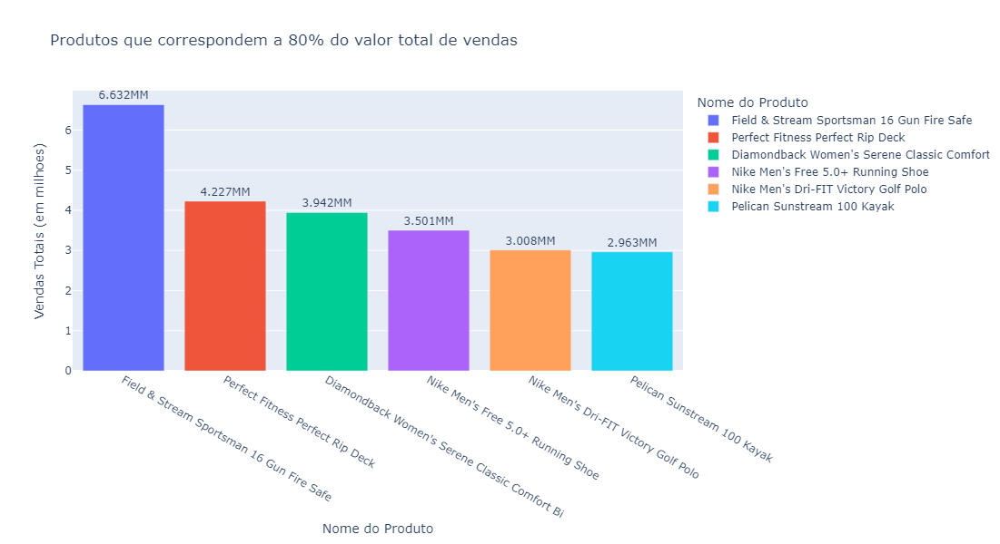

In [146]:
fig = px.bar(nome_produto_ordenado[nome_produto_ordenado['Categoria'] == 'A'], x='Nome do Produto', y='Vendas Totais (em milhoes)', color='Nome do Produto',
                 title="Produtos que correspondem a 80% do valor total de vendas", text = 'Vendas Totais (em milhoes)')

fig.update_traces(textposition='outside', texttemplate='%{text}MM', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

Os produtos do gráfico acima correspondem a 80% das vendas (em valores financeiros) da DataCo Global:

* Field & Stream Sportsman 16 Gun Fire Safe
* Perfect Fitness Perfect Rip Deck	
* Diamondback Women's Serene Classic Comfort Bi	
* Nike Men's Free 5.0+ Running Shoe
* Nike Men's Dri-FIT Victory Golf Polo
* Pelican Sunstream 100 Kayak	
* Nike Men's CJ Elite 2 TD Football Cleat

Com base nas informações encontradas, a DataCo Global poderia adotar as seguintes ações:

**Campanhas Direcionadas**: Concentrar esforços de marketing e vendas nos produtos mais lucrativos, utilizando campanhas direcionadas para impulsionar ainda mais as vendas desses produtos.
  
**Pacotes e Promoções**: Criar pacotes de produtos ou promoções que incluam produtos populares junto com itens menos vendidos para aumentar a exposição destes últimos.

<a id="analise_produtos_mais_lucrativos"></a>
## <b>7.2 Análise dos produtos mais lucrativos</b>

In [147]:
# Calcular o valor total de lucro por item

nome_produto_lucro = df_filtrado.groupby('Product Name', as_index=False)['Order Profit Per Order'].sum()

nome_produto_lucro = nome_produto_lucro.rename(columns={'Order Profit Per Order': 'Lucros Totais', 'Product Name':'Nome do Produto'})


# Calcular o valor total de lucros de todos os itens
valor_total_lucros = df_filtrado['Order Profit Per Order'].sum()

# Calcular a porcentagem do valor total de lucros para cada item
nome_produto_lucro['Percentual_do_valor_de_lucro'] = ((nome_produto_lucro['Lucros Totais'] / valor_total_lucros) * 100).round(2)

# Ordenar os itens por contribuição de valor descendente
nome_produto_lucro_ordenado = nome_produto_lucro.sort_values('Percentual_do_valor_de_lucro', ascending=False)

# Calcular a porcentagem acumulada do valor total
nome_produto_lucro_ordenado['Percentual_acumulado'] = nome_produto_lucro_ordenado['Percentual_do_valor_de_lucro'].cumsum()

nome_produto_lucro_ordenado.head(20)


,Nome do Produto,Lucros Totais,Percentual_do_valor_de_lucro,Percentual_acumulado
18,Field & Stream Sportsman 16 Gun Fire Safe,730159.127155,20.68,20.68
60,Perfect Fitness Perfect Rip Deck,472867.789776,13.40,34.08
15,Diamondback Women's Serene Classic Comfort Bi,409215.238132,11.59,45.67
50,Nike Men's Free 5.0+ Running Shoe,358365.128570,10.15,55.82
48,Nike Men's Dri-FIT Victory Golf Polo,334162.569531,9.47,65.29
59,Pelican Sunstream 100 Kayak,307522.800055,8.71,74.00
56,O'Brien Men's Neoprene Life Vest,302190.730486,8.56,82.56
45,Nike Men's CJ Elite 2 TD Football Cleat,296357.120152,8.40,90.96
85,Under Armour Girls' Toddler Spine Surge Runni,121568.960312,3.44,94.40
96,adidas Men's F10 Messi TRX FG Soccer Cleat,8078.230037,0.23,94.63


In [148]:
# Categorizando os produtos

nome_produto_lucro_ordenado['Categoria'] = 'C'
nome_produto_lucro_ordenado.loc[nome_produto_lucro_ordenado['Percentual_acumulado'] <= 80, 'Categoria'] = 'A'
nome_produto_lucro_ordenado.loc[(nome_produto_lucro_ordenado['Percentual_acumulado'] > 80) & (nome_produto_lucro_ordenado['Percentual_acumulado'] <= 95), 'Categoria'] = 'B'

nome_produto_lucro_ordenado['Lucros Totais (em milhares)'] = (nome_produto_lucro_ordenado['Lucros Totais']/1000).round(3) 
nome_produto_lucro_ordenado = nome_produto_lucro_ordenado.drop('Lucros Totais', axis=1)

nome_produto_lucro_ordenado.head(20)

,Nome do Produto,Percentual_do_valor_de_lucro,Percentual_acumulado,Categoria,Lucros Totais (em milhares)
18,Field & Stream Sportsman 16 Gun Fire Safe,20.68,20.68,A,730.159
60,Perfect Fitness Perfect Rip Deck,13.40,34.08,A,472.868
15,Diamondback Women's Serene Classic Comfort Bi,11.59,45.67,A,409.215
50,Nike Men's Free 5.0+ Running Shoe,10.15,55.82,A,358.365
48,Nike Men's Dri-FIT Victory Golf Polo,9.47,65.29,A,334.163
59,Pelican Sunstream 100 Kayak,8.71,74.00,A,307.523
56,O'Brien Men's Neoprene Life Vest,8.56,82.56,B,302.191
45,Nike Men's CJ Elite 2 TD Football Cleat,8.40,90.96,B,296.357
85,Under Armour Girls' Toddler Spine Surge Runni,3.44,94.40,B,121.569
96,adidas Men's F10 Messi TRX FG Soccer Cleat,0.23,94.63,B,8.078


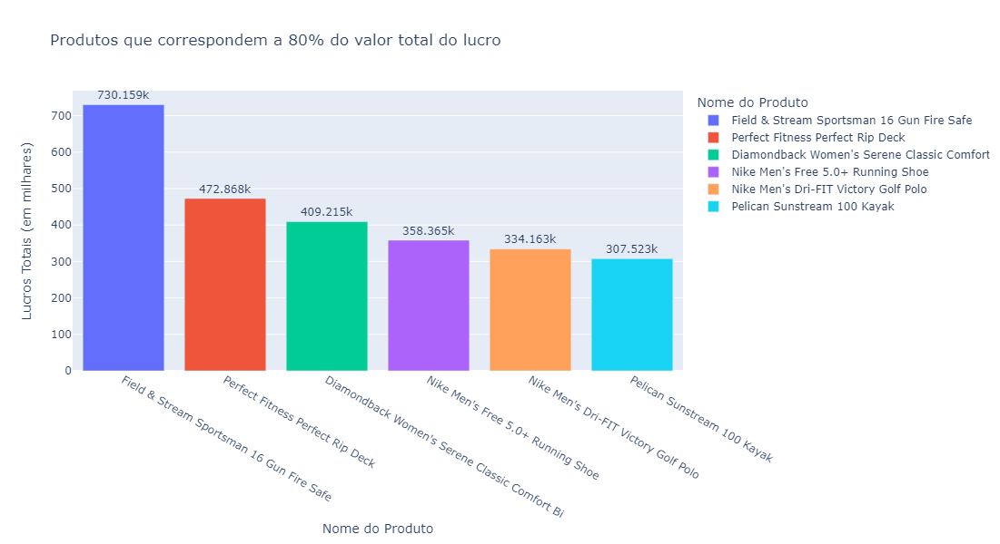

In [150]:
fig = px.bar(nome_produto_lucro_ordenado[nome_produto_lucro_ordenado['Categoria'] == 'A'], x='Nome do Produto', y='Lucros Totais (em milhares)', color='Nome do Produto',
                 title="Produtos que correspondem a 80% do valor total do lucro", text = 'Lucros Totais (em milhares)')

fig.update_traces(textposition='outside', texttemplate='%{text}k', textfont_size=12)
fig.update_layout(width=1000, height=600)
fig.show()

Os produtos do gráfico acima correspondem a 80% das vendas (em valores financeiros) da DataCo Global:

* Field & Stream Sportsman 16 Gun Fire Safe
* Perfect Fitness Perfect Rip Deck	
* Diamondback Women's Serene Classic Comfort Bi	
* Nike Men's Free 5.0+ Running Shoe
* Nike Men's Dri-FIT Victory Golf Polo
* Pelican Sunstream 100 Kayak	
* O'Brien Men's Neoprene Life Vest

<a id="modelagem_entregas_atraso"></a>
<h1 style="color: green;">8. Modelagem - Previsão de Entregas em Atraso</h1>

**Objetivo:** Prever se um pedido será entregue com atraso, o que é importante para a gestão de expectativas dos clientes e planejamento logístico.

In [154]:
df_filtrado.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 164572 entries, 48 to 180518
Data columns (total 55 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   Type                           164572 non-null  object        
 1   Days for shipping (real)       164572 non-null  int64         
 2   Days for shipment (scheduled)  164572 non-null  int64         
 3   Benefit per order              164572 non-null  float64       
 4   Sales per customer             164572 non-null  float64       
 5   Delivery Status                164572 non-null  object        
 6   Late_delivery_risk             164572 non-null  int64         
 7   Category Id                    164572 non-null  int64         
 8   Category Name                  164572 non-null  object        
 9   Customer City                  164572 non-null  object        
 10  Customer Country               164572 non-null  object        
 11 

In [155]:
# Criando a coluna target
df_filtrado['target'] = (df_filtrado['Days for shipping (real)'] > df_filtrado['Days for shipment (scheduled)']).astype(int)

In [156]:
# Removendo as colunas desnecessárias

colunas_para_remover = ['Days for shipping (real)', 'Days for shipment (scheduled)', 'Category Name', 'Customer Email', 'Customer Fname',
                       'Customer Id', 'Customer Lname', 'Customer Password', 'Customer Street', 'Customer Zipcode',
                       'Department Name', 'Latitude', 'Longitude', 'Order Customer Id', 'Order Id', 
                       'Order Item Cardprod Id', 'Order Item Id', 'Order Profit Per Order', 'Order Zipcode', 'Product Card Id',
                       'Product Description', 'Product Image', 'Product Price', 'Product Status', 'shipping date (DateOrders)',
                       'Late_delivery_risk', 'Delivery Status', 'Profit Margin', 'Atraso', 'order date (DateOrders)']

df_filtrado.drop(columns=colunas_para_remover, inplace=True)

df_filtrado.head()

,Type,Benefit per order,Sales per customer,Category Id,Customer City,Customer Country,Customer Segment,Customer State,Department Id,Market,Order City,Order Country,Order Item Discount,Order Item Discount Rate,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Region,Order State,Order Status,Product Category Id,Product Name,Shipping Mode,target
48,PAYMENT,-30.750000,115.180000,17,Bayamon,Puerto Rico,Home Office,PR,4,Pacific Asia,Mirzapur,India,4.8,0.04,59.990002,-0.27,2,119.980003,115.180000,South Asia,Uttar Pradesh,PENDING_PAYMENT,17,Perfect Fitness Perfect Rip Deck,Second Class,1
49,PAYMENT,-122.730003,79.180000,29,Caguas,Puerto Rico,Home Office,PR,5,Pacific Asia,Bursa,Turquía,0.8,0.01,39.990002,-1.55,2,79.980003,79.180000,West Asia,Bursa,PENDING_PAYMENT,29,Under Armour Girls' Toddler Spine Surge Runni,Second Class,0
50,PAYMENT,33.599998,96.000000,24,Caguas,Puerto Rico,Home Office,PR,5,Pacific Asia,Murray Bridge,Australia,4.0,0.04,50.000000,0.35,2,100.000000,96.000000,Oceania,Australia del Sur,PENDING_PAYMENT,24,Nike Men's Dri-FIT Victory Golf Polo,Second Class,1
51,PAYMENT,24.690001,75.980003,29,Caguas,Puerto Rico,Home Office,PR,5,Pacific Asia,Kartal,Turquía,4.0,0.05,39.990002,0.33,2,79.980003,75.980003,West Asia,Estambul,PENDING_PAYMENT,29,Under Armour Girls' Toddler Spine Surge Runni,Second Class,0
52,PAYMENT,9.100000,91.000000,24,Caguas,Puerto Rico,Home Office,PR,5,Pacific Asia,Ulan Bator,Mongolia,9.0,0.09,50.000000,0.10,2,100.000000,91.000000,Eastern Asia,Ulán Bator,PENDING_PAYMENT,24,Nike Men's Dri-FIT Victory Golf Polo,Second Class,1


In [157]:
# Porcentagem pedidos atrasados (1) e não atrasados (0) em todo o dataset
df_filtrado['target'].value_counts(1)

1    0.572807
0    0.427193
Name: target, dtype: float64

In [158]:
# class weight
weights = df_filtrado.target.value_counts(1)[0]/df_filtrado.target.value_counts(1)[1]

In [159]:
# Divisão em X e y
X = df_filtrado.drop(columns=['target'], axis = 1)
y = df_filtrado.target

In [160]:
# Divisão em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .3, random_state = 42, stratify=y)

In [161]:
# Porcentagem pedidos atrasados (1) e não atrasados (0) no conjunto de treino
y_train.value_counts(1)

1    0.572804
0    0.427196
Name: target, dtype: float64

In [162]:
# Porcentagem pedidos atrasados (1) e não atrasados (0) no conjunto de teste
y_test.value_counts(1)

1    0.572815
0    0.427185
Name: target, dtype: float64

In [163]:
# Instanciando modelo XGBoost
modelo_XGBoost = XGBClassifier(n_estimators = 1000, max_depth = 8, learning_rate = 1e-3, n_jobs =-1, random_state = 0, scale_pos_weight=weights, eval_metric='error')

# Instanciando modelo LightGBM
modelo_LightGBM = LGBMClassifier(n_estimators = 1000, max_depth = 8, num_leaves = 2^8, learning_rate = 1e-3, n_jobs =-1, random_state = 0, is_unbalance=True)

# Construção de uma função de validação cruzada - Stratified K-Fold

In [190]:
# Função para aplicação da validação cruzada para obtenção das métricas dos modelos

def validacao_cruzada(X, y, modelo, k, threshold):

    # Inicializando a função StratifiedKFold
    folds = StratifiedKFold(n_splits=k, shuffle=True, random_state=40)

    # Criando listas para armazenar os valores de precisão, revocação, acurácia, medida-F1, precision_recall_auc e roc_auc
    # em cada fold

    precisoes = list()
    revocacoes=list()
    acuracias=list()
    Medida_F1=list()
    precision_recall_auc=list()
    rocs_auc=list()

    # Será aplicado o método "split" no objeto folds, que retornará uma lista 
    # com os índices das instâncias que pertencem ao conjunto de treino e 
    # outra com os índices das instâncias que pertencem ao conjunto de teste
    
    for k, (train_index, test_index) in enumerate(folds.split(X,y)):
        print("=-"*6 + f"Fold: {k+1}" + "-="*6)
        
        # Dividindo os dados em treino e teste para cada um dos folds
        X_train_intern, y_train_intern = X.iloc[train_index, :], y.iloc[train_index]
        X_test_intern, y_test_intern = X.iloc[test_index, :], y.iloc[test_index]
        
        # train_index e test_index: São os índices das instâncias do conjunto 
        # de treino e teste, respectivamente, selecionados em cada um dos folds
        
        ###########################################
        ############## Preprocessing ##############
        ###########################################
    
        # Instanciando o CatBoost Encoder        
        encoder = CatBoostEncoder()

        # Criando um imputer para preencher com a moda os valores faltantes de variáveis categóricas
        cat_imputer = SimpleImputer(strategy='most_frequent')
        
        # Criando um imputer para preencher com a mediana os valores faltantes de variáveis numéricas
        num_imputer = SimpleImputer(strategy='median')

        # Criando pipelines para variáveis categóricas e numéricas que preenche os valores faltantes
        cat_pipeline = Pipeline([('encoder', encoder), ('imputer', cat_imputer)])
        num_pipeline = Pipeline([('imputer', num_imputer)])

        # Identifica as variáveis categóricas e numéricas
        cat_cols = X_train_intern.select_dtypes(include=['object']).columns
        num_cols = X_train_intern.select_dtypes(exclude=['object']).columns

        # Aplicando os pipelines no conjunto de treinamento para preencher valores faltantes em colunas categóricas e numéricas
        X_train_intern[cat_cols] = cat_pipeline.fit_transform(X_train_intern[cat_cols], y_train_intern)
        X_train_intern[num_cols] = num_pipeline.fit_transform(X_train_intern[num_cols])

        # Aplicando os pipelines ao conjunto de teste para preencher valores faltantes em colunas categóricas e numéricas
        X_test_intern[cat_cols] = cat_pipeline.transform(X_test_intern[cat_cols])
        X_test_intern[num_cols] = num_pipeline.transform(X_test_intern[num_cols])

        # Treinando o modelo
        modelo.fit(X_train_intern, y_train_intern)

        # Obtendo as probabilidades de cada registro pertencer a classe 1
        y_pred_proba = modelo.predict_proba(X_test_intern)[:, 1]

        # Obtendo as previsões do modelo
        y_pred = np.where(y_pred_proba > threshold, 1, 0)

        # Calculando a precisão e revocação para determinar a precision_recall_auc
        precisao, revocacao, limiares = precision_recall_curve(y_test_intern, y_pred)

        # Determinando as métricas para cada fold
        precisao_revocacao_auc = auc(revocacao, precisao)
        roc_auc = roc_auc_score(y_test_intern, y_pred)
        acuracia_score = accuracy_score(y_test_intern, y_pred)
        precisao_score = precision_score(y_test_intern, y_pred)
        revocacao_score = recall_score(y_test_intern, y_pred)
        f1score = f1_score(y_test_intern, y_pred)

        # Armazenando as métricas nas listas criadas
        precisoes.append(precisao_score)
        revocacoes.append(revocacao_score)
        precision_recall_auc.append(precisao_revocacao_auc)
        rocs_auc.append(roc_auc)
        acuracias.append(acuracia_score)
        Medida_F1.append(f1score)

        # Exibindo as métricas para cada um dos folds
        print(f"Precisão: {precisao_score:.4f}")
        print(f"Revocação: {revocacao_score:.4f}")
        print(f"Acurácia: {acuracia_score:.4f}")
        print(f"Medida F1: {f1score:.4f}")
        print(f"Precision-Recall AUC: {precisao_revocacao_auc:.4f}")
        print(f"ROC AUC: {roc_auc:.4f}")

    # Transformando as listas em arrays para fazer operações matemáticas
    precisoes = np.array(precisoes)
    revocacoes = np.array(revocacoes)
    precision_recall_auc = np.array(precision_recall_auc)
    rocs_auc = np.array(rocs_auc)
    acuracias = np.array(acuracias)
    Medida_F1 = np.array(Medida_F1)

    # Calculando as médias das métricas
    media_revocacao = np.mean(revocacoes)
    media_precisao = np.mean(precisoes)
    media_acuracia = np.mean(acuracias)
    media_F1 = np.mean(Medida_F1)
    media_pr_AUC = np.mean(precision_recall_auc)
    media_roc_AUC = np.mean(rocs_auc)

    # Calculando os desvios padrão para cada métrica
    std_revocacao = np.std(revocacoes)
    std_precisao = np.std(precisoes)
    std_acuracia = np.std(acuracias)
    std_F1 = np.std(Medida_F1)
    std_pr_AUC = np.std(precision_recall_auc)
    std_roc_AUC = np.std(rocs_auc)

    # Exibindo as médias das métricas obtidas
    print()
    print("=-"*6 + "Exibindo a média das métricas obtidas" + "-="*6)
    print(f"Média da acurácia: {media_acuracia:.4f} +/- {std_acuracia:.4f}")
    print(f"Média da revocação: {media_revocacao:.4f} +/- {std_revocacao:.4f}")
    print(f"Média da precisão: {media_precisao:.4f} +/- {std_precisao:.4f}")
    print(f"Média da Medida F1: {media_F1:.4f} +/- {std_F1:.4f}")
    print(f"Média da ROC AUC: {media_roc_AUC:.4f} +/- {std_roc_AUC:.4f}")
    print(f"Média da PR AUC: {media_pr_AUC:.4f} +/- {std_pr_AUC:.4f}")

# Modelo LightGBM

In [191]:
validacao_cruzada(X, y, modelo_LightGBM, k = 5, threshold = 0.5)

=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
Precisão: 0.8895
Revocação: 0.5715
Acurácia: 0.7139
Medida F1: 0.6959
Precision-Recall AUC: 0.8532
ROC AUC: 0.7382
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
Precisão: 0.8804
Revocação: 0.5624
Acurácia: 0.7056
Medida F1: 0.6864
Precision-Recall AUC: 0.8467
ROC AUC: 0.7300
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
Precisão: 0.8853
Revocação: 0.5678
Acurácia: 0.7103
Medida F1: 0.6919
Precision-Recall AUC: 0.8503
ROC AUC: 0.7346
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
Precisão: 0.8890
Revocação: 0.5675
Acurácia: 0.7117
Medida F1: 0.6928
Precision-Recall AUC: 0.8521
ROC AUC: 0.7363
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=
Precisão: 0.8844
Revocação: 0.5631
Acurácia: 0.7076
Medida F1: 0.6881
Precision-Recall AUC: 0.8489
ROC AUC: 0.7322

=-=-=-=-=-=-Exibindo a média das métricas obtidas-=-=-=-=-=-=
Média da acurácia: 0.7098 +/- 0.0029
Média da revocação: 0.5665 +/- 0.0034
Média da precisão: 0.8857 +/- 0.0033
Média da Medida F1: 0.6910 +/- 0.0034
Média da ROC AUC: 0.7342 +/- 0.0029
Média da PR AUC:

# Modelo XGBoost

In [192]:
validacao_cruzada(X, y, modelo_XGBoost, k = 5, threshold = 0.5)

=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
Precisão: 0.8848
Revocação: 0.5774
Acurácia: 0.7149
Medida F1: 0.6988
Precision-Recall AUC: 0.8521
ROC AUC: 0.7383
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
Precisão: 0.8783
Revocação: 0.5673
Acurácia: 0.7071
Medida F1: 0.6894
Precision-Recall AUC: 0.8467
ROC AUC: 0.7310
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
Precisão: 0.8736
Revocação: 0.5805
Acurácia: 0.7116
Medida F1: 0.6975
Precision-Recall AUC: 0.8472
ROC AUC: 0.7339
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
Precisão: 0.8875
Revocação: 0.5705
Acurácia: 0.7126
Medida F1: 0.6946
Precision-Recall AUC: 0.8520
ROC AUC: 0.7368
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=
Precisão: 0.8733
Revocação: 0.5761
Acurácia: 0.7093
Medida F1: 0.6943
Precision-Recall AUC: 0.8461
ROC AUC: 0.7320

=-=-=-=-=-=-Exibindo a média das métricas obtidas-=-=-=-=-=-=
Média da acurácia: 0.7111 +/- 0.0027
Média da revocação: 0.5744 +/- 0.0048
Média da precisão: 0.8795 +/- 0.0058
Média da Medida F1: 0.6949 +/- 0.0033
Média da ROC AUC: 0.7344 +/- 0.0028
Média da PR AUC:

Dentre todas as métricas de avaliação, será dada prioridade para a **ROC AUC**, que mede a capacidade do modelo distinguir entre entregas atrasadas e não atrasadas. Caso o custo de uma entrega em atraso não identificada previamente (falso negativo) seja alto, esta métrica se torna uma grande arma para **reduzir custos operacionais e aumentar o lucro da empresa**. 

## Possíveis impactos de constantes atrasos em entrega

<h4 style="color: green;">1) Satisfação do Cliente</h4>  

* **Expectativa dos clientes**: Atrasos não identificados e não comunicados podem levar à insatisfação do cliente, quebra de confiança e potencial perda de clientes.
* **Reputação online**: Uma entrega atrasada pode levar a avaliações negativas em redes sociais, podendo causar danos à reputação da empresa perante potenciais clientes.

<h4 style="color: green;">2) Custos financeiros diretos</h4>

* **Custos de Remessa e Logística**: Atrasos podem aumentar os custos de logística, especialmente se forem necessárias medidas corretivas, como reexpedição ou entrega expressa.
* **Penalidades Contratuais**: Em alguns casos, atrasos nas entregas podem levar a multas ou penalidades contratuais, especialmente em negócios B2B, onde os contratos são mais rigorosos.

<h4 style="color: green;">3) Implicações de Longo Prazo</h4>

* **Relações com Clientes B2B**: No caso de clientes empresariais, os atrasos nas entregas podem interromper suas operações, prejudicando a relação comercial de longo prazo, consequentemente as fontes de receita ao longo prazo.
* **Efeito Cascata na Cadeia de Suprimentos**: Atrasos em um nó da cadeia podem afetar outros, especialmente em um modelo just-in-time, onde os produtos são produzidos ou entregues exatamente quando necessários.

<h4 style="color: green;">4) Estratégias Competitivas</h4>

* **Perda de Vantagem Competitiva**: Em um mercado global, a capacidade de entregar no prazo pode ser um diferencial competitivo. Atrasos frequentes podem abrir margem para o crescimento de concorrentes.
* **Perda de Mercado**: Clientes insatisfeitos podem se voltar para concorrentes com histórico de entregas mais confiáveis.


Sendo assim, considerando o impacto financeiro e operacional dos atrasos em entregas, **é fundamental** para uma empresa de supply chain como a DataCo Global, com presença global, **ter uma logística capaz de cumprir com prazos e metas**. 

Na modelagem de previsão, a priorização da ROC AUC é uma estratégia-chave para isso. Com uma ROC AUC elevada, a empresa consegue melhor classificar entre pedidos com alta probabilidade de atraso e aqueles que provavelmente serão entregues no prazo, permitindo-lhes tomar medidas para **mitigar os impactos negativos**. Isso pode incluir desde a **comunicação antecipada com os clientes** sobre potenciais atrasos, **reajustes na logística** para acelerar entregas subsequentes, ou alterações na gestão do estoque para lidar com possíveis interrupções na cadeia de suprimentos.

Dentre os modelos escolhidos para avaliar a métrica **ROC AUC**, o XGBoost foi o que melhor performou, com uma ROC AUC média de **0.7344**, ou seja, significa que existe 73,44% de chance de que o modelo classifique corretamente um pedido aleatório atrasado como **atrasado** e um pedido aleatório não atrasado como **não atrasado**. 

Como o LightGBM atingiu uma ROC AUC praticamente idêntica a do XGBoost e, possui um processamento mais rápido que o XGBoost, será escolhido o LightGBM para passar por um processo de **tunagem de hiperparâmetros**.

# Tunagem de Hiperparâmetros

In [199]:
def tunagem_hiperparametros(trial, k = 5, threshold = 0.5):

    # Parâmetros para serem tunados
    learning_rate = trial.suggest_float('learning_rate', 1e-3, 1e-1, log=True)
    max_depth = trial.suggest_int('max_depth', 1, 20)
    subsample = trial.suggest_float('subsample', 0.5, 1, step = 0.1)
    colsample_bytree = trial.suggest_float('colsample_bytree', 0.5, 1, step = 0.1)
    min_child_samples = trial.suggest_int('min_child_samples', 1, 20)
    min_child_weight = trial.suggest_float('min_child_weight', 1e-3, 1e-1)
    
    # Inicializando a função StratifiedKFold
    folds = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)

    # Criando listas para armazenar os valores de precisão, revocação, acurácia, medida-F1, precision_recall_auc e roc_auc
    # em cada fold
    precisoes = list()
    revocacoes=list()
    acuracias=list()
    Medida_F1=list()
    precision_recall_auc=list()
    rocs_auc=list()

    # Será aplicado o método "split" no objeto folds, que retornará uma lista 
    # com os índices das instâncias que pertencem ao conjunto de treino e 
    # outra com os índices das instâncias que pertencem ao conjunto de teste

    for k, (train_index, test_index) in enumerate(folds.split(X,y)):
        print("=-"*6 + f"Fold: {k+1}" + "-="*6)

        # Dividindo os dados em treino e teste para cada um dos folds
        X_train_intern, y_train_intern = X.iloc[train_index, :], y.iloc[train_index]
        X_test_intern, y_test_intern = X.iloc[test_index, :], y.iloc[test_index]

        # train_index e test_index: São os índices das instâncias do conjunto 
        # de treino e teste, respectivamente, selecionados em cada um dos folds
        
        ###########################################
        ############## Preprocessing ##############
        ###########################################
    
        # Instanciando o CatBoost Encoder        
        encoder = CatBoostEncoder()

        # Criando um imputer para preencher com a moda os valores faltantes de variáveis categóricas
        cat_imputer = SimpleImputer(strategy='most_frequent')
        
        # Criando um imputer para preencher com a mediana os valores faltantes de variáveis numéricas
        num_imputer = SimpleImputer(strategy='median')

        # Criando pipelines para variáveis categóricas e numéricas que preenche os valores faltantes
        cat_pipeline = Pipeline([('encoder', encoder), ('imputer', cat_imputer)])
        num_pipeline = Pipeline([('imputer', num_imputer)])

        # Identifica as variáveis categóricas e numéricas
        cat_cols = X_train_intern.select_dtypes(include=['object']).columns
        num_cols = X_train_intern.select_dtypes(exclude=['object']).columns

        # Aplicando os pipelines no conjunto de treinamento para preencher valores faltantes em colunas categóricas e numéricas
        X_train_intern[cat_cols] = cat_pipeline.fit_transform(X_train_intern[cat_cols], y_train_intern)
        X_train_intern[num_cols] = num_pipeline.fit_transform(X_train_intern[num_cols])

        # Aplicando os pipelines ao conjunto de teste para preencher valores faltantes em colunas categóricas e numéricas
        X_test_intern[cat_cols] = cat_pipeline.transform(X_test_intern[cat_cols])
        X_test_intern[num_cols] = num_pipeline.transform(X_test_intern[num_cols])

        # Treinando o modelo XGBoost
        modelo_LightGBM.fit(X_train_intern, y_train_intern)

        # Obtendo as probabilidades de cada registro pertencer a classe 1
        y_pred_proba = modelo_XGBoost.predict_proba(X_test_intern)[:, 1]

        # Obtendo as previsões do modelo
        y_pred = np.where(y_pred_proba > threshold, 1, 0)

        # Calculando a precisão e revocação para determinar a precision_recall_auc
        precisao, revocacao, limiares = precision_recall_curve(y_test_intern, y_pred)

        # Determinando as métricas para cada fold
        precisao_revocacao_auc = auc(revocacao, precisao)
        roc_auc = roc_auc_score(y_test_intern, y_pred)
        acuracia_score = accuracy_score(y_test_intern, y_pred)
        precisao_score = precision_score(y_test_intern, y_pred)
        revocacao_score = recall_score(y_test_intern, y_pred)
        f1score = f1_score(y_test_intern, y_pred)

        # Armazenando as métricas nas listas criadas
        precisoes.append(precisao_score)
        revocacoes.append(revocacao_score)
        precision_recall_auc.append(precisao_revocacao_auc)
        rocs_auc.append(roc_auc)
        acuracias.append(acuracia_score)
        Medida_F1.append(f1score)

    # Transformando as listas em arrays para fazer operações matemáticas
    precisoes = np.array(precisoes)
    revocacoes = np.array(revocacoes)
    precision_recall_auc = np.array(precision_recall_auc)
    rocs_auc = np.array(rocs_auc)
    acuracias = np.array(acuracias)
    Medida_F1 = np.array(Medida_F1)

    # Calculando as médias das métricas
    media_revocacao = np.mean(revocacoes)
    media_precisao = np.mean(precisoes)
    media_acuracia = np.mean(acuracias)
    media_F1 = np.mean(Medida_F1)
    media_pr_AUC = np.mean(precision_recall_auc)
    media_roc_AUC = np.mean(rocs_auc)

    # Calculando os desvios padrão para cada métrica
    std_revocacao = np.std(revocacoes)
    std_precisao = np.std(precisoes)
    std_acuracia = np.std(acuracias)
    std_F1 = np.std(Medida_F1)
    std_pr_AUC = np.std(precision_recall_auc)
    std_roc_AUC = np.std(rocs_auc)
    
    return media_roc_AUC


study = opt.create_study(direction='maximize')
study.optimize(tunagem_hiperparametros, n_trials = 20)

[I 2024-01-17 18:27:48,904] A new study created in memory with name: no-name-9f7a0fda-7f19-4a46-b9d6-0c05e9b44f61


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:28:20,759] Trial 0 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.003783481459006375, 'max_depth': 4, 'subsample': 0.9, 'colsample_bytree': 0.7, 'min_child_samples': 15, 'min_child_weight': 0.04361886788079786}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:28:56,485] Trial 1 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.0020089902785211966, 'max_depth': 19, 'subsample': 0.8, 'colsample_bytree': 0.6, 'min_child_samples': 8, 'min_child_weight': 0.014900794444053143}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:29:31,184] Trial 2 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.025040449987078137, 'max_depth': 19, 'subsample': 0.7, 'colsample_bytree': 0.7, 'min_child_samples': 2, 'min_child_weight': 0.08411216585346334}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:30:04,617] Trial 3 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.0025403703455943094, 'max_depth': 20, 'subsample': 0.6, 'colsample_bytree': 0.6, 'min_child_samples': 15, 'min_child_weight': 0.029618562408736834}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:30:38,215] Trial 4 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.050657389019321736, 'max_depth': 16, 'subsample': 0.8, 'colsample_bytree': 0.7, 'min_child_samples': 17, 'min_child_weight': 0.09321686283761507}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:31:11,958] Trial 5 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.05058664029800507, 'max_depth': 9, 'subsample': 1.0, 'colsample_bytree': 0.9, 'min_child_samples': 20, 'min_child_weight': 0.047046869666183835}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:31:46,414] Trial 6 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.009835823864452852, 'max_depth': 5, 'subsample': 1.0, 'colsample_bytree': 0.9, 'min_child_samples': 12, 'min_child_weight': 0.07112745010099673}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:32:20,390] Trial 7 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.002690979420486551, 'max_depth': 16, 'subsample': 1.0, 'colsample_bytree': 1.0, 'min_child_samples': 1, 'min_child_weight': 0.045378249909018974}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:32:58,001] Trial 8 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.017503596791656903, 'max_depth': 9, 'subsample': 0.8, 'colsample_bytree': 1.0, 'min_child_samples': 13, 'min_child_weight': 0.09198242920415015}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:33:31,641] Trial 9 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.002230248870487512, 'max_depth': 1, 'subsample': 0.9, 'colsample_bytree': 0.6, 'min_child_samples': 17, 'min_child_weight': 0.05435791527644271}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:34:03,806] Trial 10 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.006551480554957562, 'max_depth': 1, 'subsample': 0.6, 'colsample_bytree': 0.5, 'min_child_samples': 8, 'min_child_weight': 0.0010030129102169758}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:34:37,811] Trial 11 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.0011415112602920477, 'max_depth': 14, 'subsample': 0.9, 'colsample_bytree': 0.5, 'min_child_samples': 8, 'min_child_weight': 0.01310637611620499}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:35:09,934] Trial 12 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.004799224775158992, 'max_depth': 5, 'subsample': 0.7, 'colsample_bytree': 0.8, 'min_child_samples': 8, 'min_child_weight': 0.024685379043364254}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:35:42,963] Trial 13 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.0011060226760489745, 'max_depth': 13, 'subsample': 0.5, 'colsample_bytree': 0.6, 'min_child_samples': 5, 'min_child_weight': 0.03503035418189004}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:36:15,953] Trial 14 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.003971984204576169, 'max_depth': 6, 'subsample': 0.9, 'colsample_bytree': 0.8, 'min_child_samples': 10, 'min_child_weight': 0.06425937558264876}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:36:51,072] Trial 15 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.0018125144884461398, 'max_depth': 12, 'subsample': 0.8, 'colsample_bytree': 0.7, 'min_child_samples': 5, 'min_child_weight': 0.008111385490141017}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:37:24,021] Trial 16 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.006124939774175045, 'max_depth': 7, 'subsample': 0.7, 'colsample_bytree': 0.6, 'min_child_samples': 14, 'min_child_weight': 0.01945262180563231}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:37:57,807] Trial 17 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.0040324728057659735, 'max_depth': 4, 'subsample': 0.9, 'colsample_bytree': 0.8, 'min_child_samples': 11, 'min_child_weight': 0.06394219945039761}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:38:30,340] Trial 18 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.0014686501198704928, 'max_depth': 11, 'subsample': 0.8, 'colsample_bytree': 0.7, 'min_child_samples': 3, 'min_child_weight': 0.00327330602708495}. Best is trial 0 with value: 0.7338568690162657.


=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=


[I 2024-01-17 18:39:03,474] Trial 19 finished with value: 0.7338568690162657 and parameters: {'learning_rate': 0.010094424629651627, 'max_depth': 8, 'subsample': 0.6, 'colsample_bytree': 0.5, 'min_child_samples': 15, 'min_child_weight': 0.038133449778652025}. Best is trial 0 with value: 0.7338568690162657.


In [201]:
# Melhores parâmetros obtidos do último Trial
params = {'learning_rate': 0.010094424629651627, 'max_depth': 8, 'subsample': 0.6, 'colsample_bytree': 0.5, 'min_child_samples': 15, 'min_child_weight': 0.038133449778652025}

In [202]:
# LightGBM executado para os melhores parâmetros
modelo_LightGBM = LGBMClassifier(n_estimators = 1000, num_leaves = 2^8, n_jobs =-1, random_state = 0, is_unbalance=True, **params)

In [203]:
# Métricas do LightGBM utilizando os melhores parâmetros
validacao_cruzada(X, y, modelo_LightGBM, k = 5, threshold = 0.5)

=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
Precisão: 0.8901
Revocação: 0.5715
Acurácia: 0.7141
Medida F1: 0.6961
Precision-Recall AUC: 0.8535
ROC AUC: 0.7384
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
Precisão: 0.8800
Revocação: 0.5627
Acurácia: 0.7055
Medida F1: 0.6864
Precision-Recall AUC: 0.8466
ROC AUC: 0.7299
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
Precisão: 0.8848
Revocação: 0.5684
Acurácia: 0.7104
Medida F1: 0.6922
Precision-Recall AUC: 0.8502
ROC AUC: 0.7346
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
Precisão: 0.8884
Revocação: 0.5682
Acurácia: 0.7118
Medida F1: 0.6931
Precision-Recall AUC: 0.8520
ROC AUC: 0.7363
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=
Precisão: 0.8840
Revocação: 0.5639
Acurácia: 0.7078
Medida F1: 0.6886
Precision-Recall AUC: 0.8488
ROC AUC: 0.7323

=-=-=-=-=-=-Exibindo a média das métricas obtidas-=-=-=-=-=-=
Média da acurácia: 0.7099 +/- 0.0030
Média da revocação: 0.5669 +/- 0.0032
Média da precisão: 0.8855 +/- 0.0035
Média da Medida F1: 0.6913 +/- 0.0034
Média da ROC AUC: 0.7343 +/- 0.0030
Média da PR AUC:

Após 20 iterações de tunagem de hiperparâmetros utilizando uma **Bayesian Search**, a ROC AUC média do modelo LightGBM melhorou pouco, de **73,42%** para **73,43%**. Sendo assim, tornou-se ainda melhor na identificação de pedidos com potencial entrega atrasada, ajudando a DataCo Global na identiicação precoce destes casos, contribuindo para **mitigar os riscos decorrentes de problemas de logística**.

**Próximos passos**: para melhorar ainda mais o desempenho do modelo, pode-se implementar técnicas de *feature engineering*, ou seja, criando outras variáveis à partir das já existentes, para buscar encontrar fatores que influenciem positivamente o modelo.

<a id="modelagem_previsao_fraude"></a>
<h1 style="color: green;">9. Modelagem - Previsão de Fraudes</h1>

**Objetivo:** Prever se um pedido poderá ser identificado como fraude, que é importante para evitar perdas financeiras à empresa.

In [204]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 171962 entries, 48 to 180518
Data columns (total 53 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   Type                           171962 non-null  object        
 1   Days for shipping (real)       171962 non-null  int64         
 2   Days for shipment (scheduled)  171962 non-null  int64         
 3   Benefit per order              171962 non-null  float64       
 4   Sales per customer             171962 non-null  float64       
 5   Delivery Status                171962 non-null  object        
 6   Late_delivery_risk             171962 non-null  int64         
 7   Category Id                    171962 non-null  int64         
 8   Category Name                  171962 non-null  object        
 9   Customer City                  171962 non-null  object        
 10  Customer Country               171962 non-null  object        
 11 

In [205]:
# Criando a coluna target
df['target'] = df['Order Status'].apply(lambda x: 1 if x == 'SUSPECTED_FRAUD' else 0)
df.head()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Email,Customer Fname,Customer Id,Customer Lname,Customer Password,Customer Segment,Customer State,Customer Street,Customer Zipcode,Department Id,Department Name,Latitude,Longitude,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode,target
48,PAYMENT,5,2,-30.750000,115.180000,Late delivery,1,17,Cleats,Bayamon,Puerto Rico,XXXXXXXXX,Mary,9083,Frank,XXXXXXXXX,Home Office,PR,75 Sunny Grounds,957.0,4,Apparel,18.380119,-66.183128,Pacific Asia,Mirzapur,India,9083,2016-02-24 13:57:00,28744,365,4.8,0.04,71956,59.990002,-0.27,2,119.980003,115.180000,-30.750000,South Asia,Uttar Pradesh,PENDING_PAYMENT,NaN,365,17,NaN,http://images.acmesports.sports/Perfect+Fitness+Perfect+Rip+Deck,Perfect Fitness Perfect Rip Deck,59.990002,0,2/29/2016 13:57,Second Class,0
49,PAYMENT,2,2,-122.730003,79.180000,Shipping on time,0,29,Shop By Sport,Caguas,Puerto Rico,XXXXXXXXX,Mary,4741,Smith,XXXXXXXXX,Home Office,PR,9731 Honey Fox Towers,725.0,5,Golf,18.235573,-66.370613,Pacific Asia,Bursa,Turquía,4741,2016-10-25 14:39:00,45461,627,0.8,0.01,113598,39.990002,-1.55,2,79.980003,79.180000,-122.730003,West Asia,Bursa,PENDING_PAYMENT,NaN,627,29,NaN,http://images.acmesports.sports/Under+Armour+Girls%27+Toddler+Spine+Surge+Running+Shoe,Under Armour Girls' Toddler Spine Surge Runni,39.990002,0,10/27/2016 14:39,Second Class,0
50,PAYMENT,6,2,33.599998,96.000000,Late delivery,1,24,Women's Apparel,Caguas,Puerto Rico,XXXXXXXXX,Elizabeth,639,Pittman,XXXXXXXXX,Home Office,PR,7573 Golden Treasure Centre,725.0,5,Golf,18.025368,-66.613037,Pacific Asia,Murray Bridge,Australia,639,2016-03-30 04:37:00,31115,502,4.0,0.04,77757,50.000000,0.35,2,100.000000,96.000000,33.599998,Oceania,Australia del Sur,PENDING_PAYMENT,NaN,502,24,NaN,http://images.acmesports.sports/Nike+Men%27s+Dri-FIT+Victory+Golf+Polo,Nike Men's Dri-FIT Victory Golf Polo,50.000000,0,4/5/2016 4:37,Second Class,0
51,PAYMENT,2,2,24.690001,75.980003,Shipping on time,0,29,Shop By Sport,Caguas,Puerto Rico,XXXXXXXXX,Katherine,9702,Tyler,XXXXXXXXX,Home Office,PR,8369 Sunny Crossing,725.0,5,Golf,18.273838,-66.370636,Pacific Asia,Kartal,Turquía,9702,2016-10-30 01:31:00,45766,627,4.0,0.05,114401,39.990002,0.33,2,79.980003,75.980003,24.690001,West Asia,Estambul,PENDING_PAYMENT,NaN,627,29,NaN,http://images.acmesports.sports/Under+Armour+Girls%27+Toddler+Spine+Surge+Running+Shoe,Under Armour Girls' Toddler Spine Surge Runni,39.990002,0,11/1/2016 1:31,Second Class,0
52,PAYMENT,3,2,9.100000,91.000000,Late delivery,1,24,Women's Apparel,Caguas,Puerto Rico,XXXXXXXXX,Mary,9114,Smith,XXXXXXXXX,Home Office,PR,1425 Fallen Fox Arbor,725.0,5,Golf,18.284805,-66.370590,Pacific Asia,Ulan Bator,Mongolia,9114,2016-11-28 01:18:00,47752,502,9.0,0.09,119405,50.000000,0.10,2,100.000000,91.000000,9.100000,Eastern Asia,Ulán Bator,PENDING_PAYMENT,NaN,502,24,NaN,http://images.acmesports.sports/Nike+Men%27s+Dri-FIT+Victory+Golf+Polo,Nike Men's Dri-FIT Victory Golf Polo,50.000000,0,12/1/2016 1:18,Second Class,0


In [206]:
# Removendo as colunas desnecessárias

colunas_para_remover = ['Days for shipping (real)', 'Days for shipment (scheduled)', 'Category Name', 'Customer Email', 'Customer Fname',
                       'Customer Id', 'Customer Lname', 'Customer Password', 'Customer Street', 'Customer Zipcode',
                       'Department Name', 'Latitude', 'Longitude', 'Order Customer Id', 'Order Id', 
                       'Order Item Cardprod Id', 'Order Item Id', 'Order Profit Per Order', 'Order Zipcode', 'Product Card Id',
                       'Product Description', 'Product Image', 'Product Status', 'shipping date (DateOrders)', 'order date (DateOrders)',
                       'Late_delivery_risk', 'Delivery Status', 'Order Status']

df.drop(columns=colunas_para_remover, inplace=True)

df.head()

,Type,Benefit per order,Sales per customer,Category Id,Customer City,Customer Country,Customer Segment,Customer State,Department Id,Market,Order City,Order Country,Order Item Discount,Order Item Discount Rate,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Region,Order State,Product Category Id,Product Name,Product Price,Shipping Mode,target
48,PAYMENT,-30.750000,115.180000,17,Bayamon,Puerto Rico,Home Office,PR,4,Pacific Asia,Mirzapur,India,4.8,0.04,59.990002,-0.27,2,119.980003,115.180000,South Asia,Uttar Pradesh,17,Perfect Fitness Perfect Rip Deck,59.990002,Second Class,0
49,PAYMENT,-122.730003,79.180000,29,Caguas,Puerto Rico,Home Office,PR,5,Pacific Asia,Bursa,Turquía,0.8,0.01,39.990002,-1.55,2,79.980003,79.180000,West Asia,Bursa,29,Under Armour Girls' Toddler Spine Surge Runni,39.990002,Second Class,0
50,PAYMENT,33.599998,96.000000,24,Caguas,Puerto Rico,Home Office,PR,5,Pacific Asia,Murray Bridge,Australia,4.0,0.04,50.000000,0.35,2,100.000000,96.000000,Oceania,Australia del Sur,24,Nike Men's Dri-FIT Victory Golf Polo,50.000000,Second Class,0
51,PAYMENT,24.690001,75.980003,29,Caguas,Puerto Rico,Home Office,PR,5,Pacific Asia,Kartal,Turquía,4.0,0.05,39.990002,0.33,2,79.980003,75.980003,West Asia,Estambul,29,Under Armour Girls' Toddler Spine Surge Runni,39.990002,Second Class,0
52,PAYMENT,9.100000,91.000000,24,Caguas,Puerto Rico,Home Office,PR,5,Pacific Asia,Ulan Bator,Mongolia,9.0,0.09,50.000000,0.10,2,100.000000,91.000000,Eastern Asia,Ulán Bator,24,Nike Men's Dri-FIT Victory Golf Polo,50.000000,Second Class,0


In [207]:
# Porcentagem de fraude (1) e não fraude (0) em todo o dataset
df['target'].value_counts(1)

0    0.977454
1    0.022546
Name: target, dtype: float64

In [208]:
# class weight
weights = df.target.value_counts(1)[0]/df.target.value_counts(1)[1]

In [209]:
# Divisão em X e y
X = df.drop(columns=['target'], axis = 1)
y = df.target

In [210]:
# Divisão em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .3, random_state = 42, stratify=y)

In [211]:
# Porcentagem de fraude (1) e não fraude (0) no conjunto de treino
y_train.value_counts(1)

0    0.977453
1    0.022547
Name: target, dtype: float64

In [212]:
# Porcentagem de fraude (1) e não fraude (0) no conjunto de teste
y_test.value_counts(1)

0    0.977456
1    0.022544
Name: target, dtype: float64

In [213]:
# Instanciando modelo XGBoost
modelo_XGBoost = XGBClassifier(n_estimators = 1000, max_depth = 8, learning_rate = 1e-3, n_jobs =-1, random_state = 0, scale_pos_weight=weights, eval_metric='error')

# Instanciando modelo LightGBM
modelo_LightGBM = LGBMClassifier(n_estimators = 1000, max_depth = 8, num_leaves = 2^8, learning_rate = 1e-3, n_jobs =-1, random_state = 0, is_unbalance=True)

# Construção de uma função de validação cruzada - Stratified K-Fold

In [214]:
# Função para aplicação da validação cruzada para obtenção das métricas dos modelos

def validacao_cruzada(X, y, modelo, k, threshold):

    # Inicializando a função StratifiedKFold
    folds = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)

    # Criando listas para armazenar os valores de precisão, revocação, acurácia, medida-F1, precision_recall_auc e roc_auc
    # em cada fold

    precisoes = list()
    revocacoes=list()
    acuracias=list()
    Medida_F1=list()
    precision_recall_auc=list()
    rocs_auc=list()

    # Será aplicado o método "split" no objeto folds, que retornará uma lista 
    # com os índices das instâncias que pertencem ao conjunto de treino e 
    # outra com os índices das instâncias que pertencem ao conjunto de teste
    
    for k, (train_index, test_index) in enumerate(folds.split(X,y)):
        print("=-"*6 + f"Fold: {k+1}" + "-="*6)
        
        # Dividindo os dados em treino e teste para cada um dos folds
        X_train_intern, y_train_intern = X.iloc[train_index, :], y.iloc[train_index]
        X_test_intern, y_test_intern = X.iloc[test_index, :], y.iloc[test_index]
        
        # train_index e test_index: São os índices das instâncias do conjunto 
        # de treino e teste, respectivamente, selecionados em cada um dos folds
        
        ###########################################
        ############## Preprocessing ##############
        ###########################################
    
        # Instanciando o CatBoost Encoder        
        encoder = CatBoostEncoder()

        # Criando um imputer para preencher com a moda os valores faltantes de variáveis categóricas
        cat_imputer = SimpleImputer(strategy='most_frequent')
        
        # Criando um imputer para preencher com a mediana os valores faltantes de variáveis numéricas
        num_imputer = SimpleImputer(strategy='median')

        # Criando pipelines para variáveis categóricas e numéricas que preenche os valores faltantes
        cat_pipeline = Pipeline([('encoder', encoder), ('imputer', cat_imputer)])
        num_pipeline = Pipeline([('imputer', num_imputer)])

        # Identifica as variáveis categóricas e numéricas
        cat_cols = X_train_intern.select_dtypes(include=['object']).columns
        num_cols = X_train_intern.select_dtypes(exclude=['object']).columns

        # Aplicando os pipelines no conjunto de treinamento para preencher valores faltantes em colunas categóricas e numéricas
        X_train_intern[cat_cols] = cat_pipeline.fit_transform(X_train_intern[cat_cols], y_train_intern)
        X_train_intern[num_cols] = num_pipeline.fit_transform(X_train_intern[num_cols])

        # Aplicando os pipelines ao conjunto de teste para preencher valores faltantes em colunas categóricas e numéricas
        X_test_intern[cat_cols] = cat_pipeline.transform(X_test_intern[cat_cols])
        X_test_intern[num_cols] = num_pipeline.transform(X_test_intern[num_cols])

        # Treinando o modelo
        modelo.fit(X_train_intern, y_train_intern)

        # Obtendo as probabilidades de cada registro pertencer a classe 1
        y_pred_proba = modelo.predict_proba(X_test_intern)[:, 1]

        # Obtendo as previsões do modelo
        y_pred = np.where(y_pred_proba > threshold, 1, 0)

        # Calculando a precisão e revocação para determinar a precision_recall_auc
        precisao, revocacao, limiares = precision_recall_curve(y_test_intern, y_pred)

        # Determinando as métricas para cada fold
        precisao_revocacao_auc = auc(revocacao, precisao)
        roc_auc = roc_auc_score(y_test_intern, y_pred)
        acuracia_score = accuracy_score(y_test_intern, y_pred)
        precisao_score = precision_score(y_test_intern, y_pred)
        revocacao_score = recall_score(y_test_intern, y_pred)
        f1score = f1_score(y_test_intern, y_pred)

        # Armazenando as métricas nas listas criadas
        precisoes.append(precisao_score)
        revocacoes.append(revocacao_score)
        precision_recall_auc.append(precisao_revocacao_auc)
        rocs_auc.append(roc_auc)
        acuracias.append(acuracia_score)
        Medida_F1.append(f1score)

        # Exibindo as métricas para cada um dos folds
        print(f"Precisão: {precisao_score:.4f}")
        print(f"Revocação: {revocacao_score:.4f}")
        print(f"Acurácia: {acuracia_score:.4f}")
        print(f"Medida F1: {f1score:.4f}")
        print(f"Precision-Recall AUC: {precisao_revocacao_auc:.4f}")
        print(f"ROC AUC: {roc_auc:.4f}")

    # Transformando as listas em arrays para fazer operações matemáticas
    precisoes = np.array(precisoes)
    revocacoes = np.array(revocacoes)
    precision_recall_auc = np.array(precision_recall_auc)
    rocs_auc = np.array(rocs_auc)
    acuracias = np.array(acuracias)
    Medida_F1 = np.array(Medida_F1)

    # Calculando as médias das métricas
    media_revocacao = np.mean(revocacoes)
    media_precisao = np.mean(precisoes)
    media_acuracia = np.mean(acuracias)
    media_F1 = np.mean(Medida_F1)
    media_pr_AUC = np.mean(precision_recall_auc)
    media_roc_AUC = np.mean(rocs_auc)

    # Calculando os desvios padrão para cada métrica
    std_revocacao = np.std(revocacoes)
    std_precisao = np.std(precisoes)
    std_acuracia = np.std(acuracias)
    std_F1 = np.std(Medida_F1)
    std_pr_AUC = np.std(precision_recall_auc)
    std_roc_AUC = np.std(rocs_auc)

    # Exibindo as médias das métricas obtidas
    print()
    print("=-"*6 + "Exibindo a média das métricas obtidas" + "-="*6)
    print(f"Média da acurácia: {media_acuracia:.4f} +/- {std_acuracia:.4f}")
    print(f"Média da revocação: {media_revocacao:.4f} +/- {std_revocacao:.4f}")
    print(f"Média da precisão: {media_precisao:.4f} +/- {std_precisao:.4f}")
    print(f"Média da Medida F1: {media_F1:.4f} +/- {std_F1:.4f}")
    print(f"Média da ROC AUC: {media_roc_AUC:.4f} +/- {std_roc_AUC:.4f}")
    print(f"Média da PR AUC: {media_pr_AUC:.4f} +/- {std_pr_AUC:.4f}")

# Modelo LightGBM

In [215]:
validacao_cruzada(X, y, modelo_LightGBM, k = 5, threshold = 0.5)

=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
Precisão: 0.1483
Revocação: 0.9149
Acurácia: 0.8795
Medida F1: 0.2552
Precision-Recall AUC: 0.5326
ROC AUC: 0.8968
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
Precisão: 0.1564
Revocação: 0.9085
Acurácia: 0.8874
Medida F1: 0.2668
Precision-Recall AUC: 0.5335
ROC AUC: 0.8977
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
Precisão: 0.1555
Revocação: 0.9123
Acurácia: 0.8863
Medida F1: 0.2656
Precision-Recall AUC: 0.5348
ROC AUC: 0.8990
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
Precisão: 0.1464
Revocação: 0.9265
Acurácia: 0.8766
Medida F1: 0.2528
Precision-Recall AUC: 0.5372
ROC AUC: 0.9009
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=
Precisão: 0.1532
Revocação: 0.9058
Acurácia: 0.8850
Medida F1: 0.2620
Precision-Recall AUC: 0.5306
ROC AUC: 0.8952

=-=-=-=-=-=-Exibindo a média das métricas obtidas-=-=-=-=-=-=
Média da acurácia: 0.8830 +/- 0.0042
Média da revocação: 0.9136 +/- 0.0071
Média da precisão: 0.1519 +/- 0.0040
Média da Medida F1: 0.2605 +/- 0.0056
Média da ROC AUC: 0.8979 +/- 0.0020
Média da PR AUC:

# Modelo XGBoost

In [216]:
validacao_cruzada(X, y, modelo_XGBoost, k = 5, threshold = 0.5)

=-=-=-=-=-=-Fold: 1-=-=-=-=-=-=
Precisão: 0.1424
Revocação: 0.9343
Acurácia: 0.8715
Medida F1: 0.2471
Precision-Recall AUC: 0.5391
ROC AUC: 0.9022
=-=-=-=-=-=-Fold: 2-=-=-=-=-=-=
Precisão: 0.1119
Revocação: 0.9691
Acurácia: 0.8257
Medida F1: 0.2006
Precision-Recall AUC: 0.5408
ROC AUC: 0.8957
=-=-=-=-=-=-Fold: 3-=-=-=-=-=-=
Precisão: 0.1013
Revocação: 0.9665
Acurácia: 0.8061
Medida F1: 0.1834
Precision-Recall AUC: 0.5343
ROC AUC: 0.8844
=-=-=-=-=-=-Fold: 4-=-=-=-=-=-=
Precisão: 0.1056
Revocação: 0.9677
Acurácia: 0.8146
Medida F1: 0.1904
Precision-Recall AUC: 0.5370
ROC AUC: 0.8894
=-=-=-=-=-=-Fold: 5-=-=-=-=-=-=
Precisão: 0.1154
Revocação: 0.9652
Acurácia: 0.8325
Medida F1: 0.2061
Precision-Recall AUC: 0.5407
ROC AUC: 0.8973

=-=-=-=-=-=-Exibindo a média das métricas obtidas-=-=-=-=-=-=
Média da acurácia: 0.8301 +/- 0.0226
Média da revocação: 0.9605 +/- 0.0132
Média da precisão: 0.1153 +/- 0.0144
Média da Medida F1: 0.2055 +/- 0.0222
Média da ROC AUC: 0.8938 +/- 0.0062
Média da PR AUC:

Dentre todas as métricas de avaliação, será dada prioridade para a **revocação**, que diz respeito à quantidade de fraudes que foram corretamente identificadas. Caso o custo de uma entrega em atraso não identificada previamente (falso negativo) seja alto, esta métrica se torna uma grande arma para **reduzir custos operacionais e aumentar o lucro da empresa**. 

Entre os modelos escolhidos para avaliar a métrica **revocação**, o XGBoost foi o que melhor performou, com uma revocação média de **0.9605**, ou seja, de todos os casos que realmente eram fraude, ele identificou **96,05%**.


# O quanto a DataCo Global ganhou ao identificar corretamente as fraudes?

In [217]:
encoder = CatBoostEncoder()

X_train_encoded = encoder.fit_transform(X_train, y_train)
X_test_encoded = encoder.transform(X_test)

# Fazendo previsões de probabilidade de fraude para o conjunto de teste
xgb_probs = modelo_XGBoost.predict_proba(X_test_encoded)[:, 1]

# Aqui são trazidas as 

df_test = X_test.copy()
df_test['fraude'] = y_test
df_test['XGB_Prob'] = xgb_probs

In [218]:
# Função para calcular o impacto financeiro das decisões de bloqueio de transações

def calculo_impacto_financeiro(df, blocked_col, fraud_col, profit_col):
    
    # Calculando perdas por fraude (transações que são fraudes e não foram bloqueadas)
    df['fraud_loss'] = ((df[fraud_col]) & (~df[blocked_col])) * df[profit_col]
    
    # lucro obtido de transações legítimas que o sistema corretamente identificou como não fraudulentas e, portanto, não bloqueou.
    df['saved_profit'] = ((~df[fraud_col]) & (~df[blocked_col])) * df[profit_col]
    
    # Representa o lucro líquido após considerar tanto as perdas por fraude quanto o lucro preservado.
    df['total_profit'] = df['saved_profit'] - df['fraud_loss']
    
    return df[['fraud_loss', 'saved_profit', 'total_profit']].sum()


In [219]:
# Definindo uma gama de limiares possíveis
possiveis_thresholds = np.linspace(0.01, 0.99, 99)

# Inicializando uma lista para armazenar os resultados
impactos_financeiros = []

# Testando cada limiar
for threshold in possiveis_thresholds:
    # Aplicando o limiar atual
    df_test['blocked'] = df_test['XGB_Prob'] >= threshold
    
    # Calculando o impacto financeiro para o limiar atual
    impacto = calculo_impacto_financeiro(df_test, 'blocked', 'fraude', 'Benefit per order')
    
    # Armazenando os resultados, incluindo o limiar
    impactos_financeiros.append({
        'threshold': threshold, 
        'Perda por fraude': impacto['fraud_loss'],
        'Lucro Salvo': impacto['saved_profit'],
        'Lucro Total': impacto['total_profit']
    })

# Convertendo os resultados em um DataFrame
results_df = pd.DataFrame(impactos_financeiros)

# Encontrando o limiar com o maior lucro
best_result = results_df.loc[results_df['Lucro Total'].idxmax()]
best_result_df = pd.DataFrame([best_result])

# Exibindo o melhor limiar e o lucro associado
best_result_df

,threshold,Perda por fraude,Lucro Salvo,Lucro Total
79,0.8,24070.220004,1.090431e+06,1.066361e+06


In [221]:
print(f"O modelo conseguiu lucrar {best_result_df['Lucro Salvo'].iloc[0]:.2f} ao identificar corretamente operações fraudulentas!")
print(f"Porém, modelo perdeu {best_result_df['Perda por fraude'].iloc[0]:.2f} por não identificar corretamente outras operações que realmente eram fraudes!")
print(f"Considerando as perdas por fraude, o modelo conseguiu lucrar {best_result_df['Lucro Total'].iloc[0]:.2f} ao total!")

O modelo conseguiu lucrar 1090431.06 ao identificar corretamente operações fraudulentas!
Porém, modelo perdeu 24070.22 por não identificar corretamente outras operações que realmente eram fraudes!
Considerando as perdas por fraude, o modelo conseguiu lucrar 1066360.84 ao total!
